<a href="https://colab.research.google.com/github/Lorenzo-Gardini/Computer-vision/blob/main/identity.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Identity

Questo progetto ha come obiettivo quello di realizzare un sistema di visione artificiale volto alla soluzione del gioco del cosiddetto "parente misterioso" che è parte del _game show_ "I soliti ignoti - Il ritorno" che va in onda su Rai Uno o, utilizzando il nome del _format_ televisivo originale, che è parte del _game show_ "Identity".

In questo gioco, al concorrente viene chiesto di osservare attentamente una persona, il "parente misterioso" appunto, e di raffrontare il suo volto con quello delle altre otto persone, gli "ignoti", con cui ha "giocato" per tutto il resto della trasmissione e che quindi ha già potuto vedere da vicino. Può chiedere alcuni aiuti, riducendo il montepremi finale che potrà portarsi a casa in caso di vittoria. Nel nostro problema, anche per semplificare le ipotesi del problema, al concorrente non viene fornito alcun indizio e deve scegliere perciò a colpo sicuro l'ignoto che è in relazione di parentela con il parente misterioso. In più, il tipo di parentela è uno dei primi indizi che viene fornito, ma nelle ipotesi di questo problema, dove gli indizi non sono forniti, si presuppone che debba essere indovinato dal concorrente, una volta scelto l'ignoto.

Il sistema creato dovrà perciò confrontare l'immagine del parente misterioso in coppia con ciascuno degli ignoti e determinare tra quale di questi c'è legame di parentela con il parente misterioso. Ci riferiremo a questo come "primo problema". Dopodiché, una volta accertata la parentela, il sistema deve classificare la coppia in una delle possibili relazioni di parentela, risolvendo il "secondo problema".

Questo progetto si ispira alla _competition_ "[Recognizing Faces in the Wild](https://www.kaggle.com/competitions/recognizing-faces-in-the-wild/overview)" proposto dal "Northeastern SMILE Lab" sul sito "Kaggle", dove veniva richiesto di risolvere solamente quello che noi abbiamo definito "primo problema", quindi costruire un sistema che, dati due volti, capisse se fossero legati da parentela oppure no. Basarci su questa competition ci ha permesso di utilizzare lo stesso *dataset* per risolvere il problema, ovvero il "[Families In the Wild](https://web.northeastern.edu/smilelab/fiw/)". In secondo luogo, ci ha permesso di ispirarci al lavoro fatto dal primo classificato, che ha riassunto lui stesso nelle [note da lui pubblicate](https://www.kaggle.com/competitions/recognizing-faces-in-the-wild/discussion/103670). Ogni volta che è stato utilizzato l'apporto dei partecipanti alla *challenge* durante il corso di questo progetto, sarà esplicitamente indicato. Altrimenti, deve assumersi che il contributo è da intendersi come puramente nostro. Da ultimo, è stato possibile visionare la *leaderboard* e avere quindi un'idea generale della complessità del problema, capendo attorno a quale livello di accuratezza avremmo potuto attestarci.

Tutto il codice utilizzato, ma omesso perché non rilevante ai fini della trattazione, è possibile scaricarlo dal *repository* associato a questo *notebook* presente a [questo link](https://github.com/Lorenzo-Gardini/Computer-vision).

## Import iniziali

Per prima cosa installiamo le librerie che saranno utilizzate nel progetto non già disponibili di default nell'ambiente Colab. I moduli scaricati sono:

* "PyEFD": per poter estrarre gli "Elliptic Fourier Descriptors" di una forma;
* "XGBoost": per poter utilizzare il classificatore omonimo durante la classificazione di *feature handcrafted*;
* "Seaborn": per utilizzare l'omonima libreria per i grafici;
* "Keras Applications": per avere a disposizione modelli di reti profonde già addestrati e pronti per l'utilizzo. Viene usata da "Keras VGGFace";
* "Keras VGGFace": per poter utilizzare l'implementazione in Tensorflow e Keras delle architetture "ResNet" e "SeNet".
* "Scikit Optimize": per poter utilizzare un'implementazione di "GridSearchCV" che ricerca i potenziali iperparametri ottimali attraverso "Bayesian Optimization".

In [1]:
%%capture
!pip install pyefd
!pip install xgboost
!pip install seaborn
!pip install keras_applications
!pip install git+https://github.com/rcmalli/keras-vggface.git
!pip install scikit-optimize

Dopodiché, scarichiamo e importiamo i moduli contenenti le funzioni e le classi di utilità usati in questo *notebook*.

In [2]:
%%capture
!wget https://raw.githubusercontent.com/Lorenzo-Gardini/Computer-vision/main/utils.py

In seguito, scarichiamo e scompattiamo i *dataset* utilizzati in questo progetto. Sono presenti cinque cartelle:

* "test-public-faces": la cartella contenente i volti di *training*. È divisa in una sottocartella per ogni famiglia di persone, con nome che inizia per "F" seguito da quattro cifre, e ognuna di queste ha una sottocartella per ogni membro della famiglia. Ognuna di queste ultime ha nome che inizia per "MID" seguito da una cifra e contiene multiple immagini.
* "test-public-lists": la cartella contenente le etichette di *training*. Contiene un *file* "csv" per ogni tipo di relazione di parentela e ognuno di questi contiene diverse righe costituite da due dati. Il primo è il percorso di una cartella che indica il membro di una famiglia, il secondo un altro percorso di un altro membro della stessa famiglia. I nomi dei file sono:

  * "bb": contiene coppie di fratelli maschi;
  * "ss": contiene coppie di sorelle;
  * "sibs": contiene coppie fatte da un fratello maschio e una sorella;
  * "fs": contiene coppie fatte da padre e figlio;
  * "fd": contiene coppie fatte da padre e figlia;
  * "ms": contiene coppie fatte da madre e figlio;
  * "md": contiene coppie fatte da madre e figlia;
  * "gfgs": contiene coppie fatte da nonno e nipote maschio;
  * "gfgd": contiene coppie fatte da nonno e nipote femmina;
  * "gmgs": contiene coppie fatte da nonna e nipote maschio;
  * "gmgd": contiene coppie fatte da nonna e nipote femmina.

* "test-private-faces": la cartella contenente i volti di *test*. In questo caso i volti sono sparsi e numerati progressivamente;
* "test-private-lists": la cartella contenente le etichette di *test*. La struttura è analoga alla cartella contenente le etichette di *training*, che accoppia i volti in file diversi a seconda della relazione di parentela. La differenza è che, essendo da utilizzare per il *test*, non tutte le coppie sono veramente corrette;
* "test-private-labels": ha la stessa struttura di "test-private-list", ma per ogni coppia di immagini di ogni relazione di parentela indica se la relazione è vera o è falsa.

In [3]:
%%capture
!gdown '14Hy4UCCF8VyJP1XPONMax5SzTh_of4Do' # test-private-faces.zip
!gdown '1pl8v3a7MHS-1HBB26FQ_b0bo29MipgmV' # test-private-labels.zip
!gdown '1hIJ35pER8OwlSQxFrBBAbogyVBLjVOsn' # test-private-lists.zip
!gdown '1ldvxVPvW3w13B5pROzij1jwNkqL2FCgL' # test-public-faces.zip
!gdown '1ldvxVPvW3w13B5pROzij1jwNkqL2FCgL' # test-public-faces.zip
!gdown '18hWKdt6g7ohQ25Au0IhVxJ0kYHoc0fT8' # test-public-lists.zip

Scarichiamo il *dataset* di *training* riorganizzato in un formato più semplice per l'addestramento. Inoltre, vengono scaricati anche i file contenenti le etichette elaborate dai *dataset* originali che permettono di effettuare le associazioni tra le immagini riorganizzate e le diverse classi. La struttura delle etichette sarà argomento della prossima sezione. Le etichette combaciano con la struttura del *dataset* riordinato per quanto riguarda il *training set*, mentre invece combaciano con quello originale per il *test set*.

In [4]:
%%capture
!gdown '1axqt_q9CuC2qD2LgVWGiT8ayGU8j0WTu' # train-faces.zip
!gdown '1t5IbjMkc6Prg7z93p7Z2RXdLGuMN3asB' # labels.zip

Viene scaricato anche il file che fa da *cache* per le *feature* *handcrafted* estratte per ogni immagine seguendo il procedimento che verrà descritto in seguito. Il come e il perché questo file è stato creato sono infatti oggetto di una sezione apposita di questo *notebook*.

In [5]:
%%capture
!gdown '1U_6vnF-0boXSxq5_1u0ibNHWU6CST92w' # handcrafted.zip

Vengono inoltre scaricati gli archivi contenenti i modelli già addestrati, i risultati degli addestramenti associati e, per quanto riguarda la soluzione che impiega reti neurali, la predizione delle reti stesse. Questo è stato fatto per poter mostrare ed analizzare i risultati ottenuti senza dover effettuare nuovamente l'addestramento. Il come e il perché questi file sono stati creati sono oggetto di una sezione apposita di questo *notebook*.

In [6]:
%%capture
!gdown '16Sndu94uXIpQ0nCHfY20wCW-TCyyGenF' # xgboost_binary.zip
!gdown '1AcJlWw_PIdYXcuKElsEGBoYfXX_mz1b-' # xgboost_multiclass.zip
!gdown '1IPYhvvtnbLFzXLPrS4G--dlYyKwJUFof' # keras_binary.zip
!gdown '1tnjYpx68GJOHyUXO-KyCltLeQU_4QEiG' # keras_multiclass.zip
!gdown '1re3dNJ84OfffqZLbwL7K36pJMiLQooOW' # keras_predictions.zip

Ultimo archivio a venire scaricato è quello contenente le immagini delle puntate della trasmissione oggetto di questo progetto, sulle quali poi saranno testati i classificatori realizzati usando il sistema di classificazione complessivo.

In [7]:
%%capture
!gdown '1dc6BPY4-axBoPO7tr9Uk5mgJRQMHihHp' # soliti_ignoti.zip

Importiamo tutte le funzioni e le classi che servono al *notebook* per funzionare, scompattiamo ed elimiamo gli archivi scaricati in precedenza.

In [8]:
import os
import json
import numpy as np
import pandas as pd
import cv2 as cv
import matplotlib.pyplot as plt
import seaborn as sns
from pyefd import elliptic_fourier_descriptors
from skimage.feature import local_binary_pattern
from skimage.color import deltaE_ciede2000
from sklearn.preprocessing import StandardScaler, FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import StackingClassifier
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.utils import class_weight
from skopt import BayesSearchCV
from xgboost import XGBClassifier
from keras.utils import to_categorical
from keras.layers import (Input,
                          Dense,
                          Flatten,
                          BatchNormalization,
                          Dropout,
                          Activation,
                          Concatenate,
                          RandomRotation,
                          RandomZoom,
                          RandomTranslation,
                          RandomFlip,
                          RandomContrast,
                          Conv2D,
                          RandomBrightness)
from keras.models import load_model
import keras.backend as K
from keras.models import Model
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from keras.optimizers import Adam
from keras_vggface.utils import preprocess_input
from keras_vggface.vggface import VGGFace
from keras.utils import Sequence
from sklearn.utils.class_weight import compute_class_weight
import random
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import confusion_matrix
from keras.losses import binary_crossentropy, categorical_crossentropy
import glob
from utils import *
import gc

for zip_file in glob.glob('./*.zip'):
  unzip(zip_file)

!rm ./*.zip

## Descrizione dei dataset

### Immagini

Per quanto riguarda le immagini, come si può vedere sono prese da diverse angolazioni, in diverse condizioni di illuminazione, da camere diverse, a diverse risoluzioni e con un diverso numero di canali. Nonostante questo, sono tutte immagini già ritagliate per contenere unicamente la faccia della persona, il che significa che non è necessario doverla estrarre.

Train:


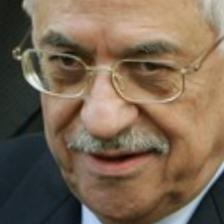

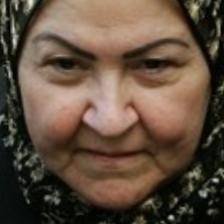

Test:


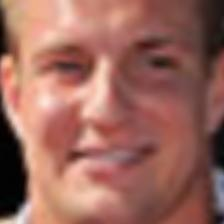

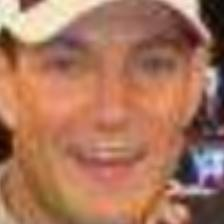

In [9]:
print("Train:")
image_1 = load_image("train-faces/F0001_MID1_P00001_face2.jpg")
show_image(image_1)
image_2 = load_image("train-faces/F0001_MID2_P00001_face1.jpg")
show_image(image_2)
print("Test:")
image_3 = load_image("test-private-faces/face1.jpg")
show_image(image_3)
image_4 = load_image("test-private-faces/face2.jpg")
show_image(image_4)

Tutte le immagini hanno la stessa dimensione, ovvero 224 pixel per 224, e sono state caricate in memoria per essere a colori, perciò usano tre canali.

In [10]:
print(image_1.shape)
print(image_2.shape)
print(image_3.shape)
print(image_4.shape)

(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)


### Etichette

Le informazioni utili estratte dalle etichette sono state raccolte in quattro *dataset*.

I primi due sono utili a risolvere il primo problema, quello sull'individuazione dell'esistenza della parentela o meno. Questi *dataset* devono quindi associare alle coppie di immagini una _label_ binaria, che è pari a 1 se c'è parentela tra le due immagini e 0 se non c'è. Dato che le informazioni che provengono dal *dataset* originale sono solamente su parentele realmente esistenti, non erano presenti casi negativi. Per poterli avere, si sono prese casualmente immagini dello stesso *dataset* che non erano accoppiate e sono state inserite in coda al *dataset* stesso, con label negativa. Tutte le coppie di immagini che invece erano già presenti, indipendentemente dalla relazione di parentela, sono state associate ad una label positiva. La generazione dei negativi è stata fatta in modo tale che le due classi abbiano lo stesso numero di istanze, per evitare sbilanciamenti.

Il *dataset* "train_binary" è quello estratto dalle etichette delle immagini di *training*, perciò i nomi delle immagini sono dati dal codice della famiglia, "underscore", codice del componente, "underscore" e infine il nome dell'immagine originale. Il *dataset* "test_binary" è invece quello estratto dalle etichette delle immagini di test, perciò i nomi delle immagini sono quelli originali. La scelta per il *dataset* di *training* di non avere più colonne, ma una sola che dà un nome univoco all'immagine, è per semplificare il salvataggio e l'ottenimento delle immagini stesse.

In [11]:
train_binary = pd.read_csv("labels/train_binary.csv")
train_binary

,p1,p2,label
0,F0001_MID3_P00005_face2.jpg,F0001_MID4_P00005_face1.jpg,1
1,F0001_MID3_P00005_face2.jpg,F0001_MID4_P00006_face1.jpg,1
2,F0001_MID3_P00005_face2.jpg,F0001_MID4_P00007_face1.jpg,1
3,F0001_MID3_P00006_face2.jpg,F0001_MID4_P00005_face1.jpg,1
4,F0001_MID3_P00006_face2.jpg,F0001_MID4_P00006_face1.jpg,1
...,...,...,...
554337,F0002_MID1_P00017_face3.jpg,F0468_MID3_P04939_face2.jpg,0
554338,F0002_MID1_P00017_face3.jpg,F0468_MID3_P04940_face1.jpg,0
554339,F0002_MID1_P00017_face3.jpg,F0469_MID1_P04942_face2.jpg,0
554340,F0002_MID1_P00017_face3.jpg,F0469_MID1_P04943_face2.jpg,0


In [12]:
test_binary = pd.read_csv("labels/test_binary.csv")
test_binary

,p1,p2,label
0,face3986.jpg,face3993.jpg,1
1,face3986.jpg,face3988.jpg,1
2,face3984.jpg,face3988.jpg,1
3,face3988.jpg,face3993.jpg,1
4,face3984.jpg,face3993.jpg,1
...,...,...,...
99957,face1923.jpg,face748.jpg,0
99958,face3564.jpg,face1642.jpg,0
99959,face1925.jpg,face1645.jpg,0
99960,face3582.jpg,face3952.jpg,0


Si è deciso di utilizzare "label encoding" per codificare le undici classi di parentela che sono parte di questo progetto. Le associazioni costituiscono il dizionario Python qui di seguito.

In [13]:
with open("labels/class_encoding.json") as f:
  classes = json.load(f)
classes

{'bb': 0,
 'fd': 1,
 'fs': 2,
 'gmgs': 3,
 'gmgd': 4,
 'gfgs': 5,
 'gfgd': 6,
 'md': 7,
 'ms': 8,
 'sibs': 9,
 'ss': 10}

Gli ultimi due *dataset* sono quelli inerenti al secondo problema, ovvero quello di stabilire per una coppia di immagini che rappresentano due persone sicuramente imparentate tra di loro, che tipo di relazione hanno. La struttura dei due *dataset* è analoga a quella dei precedenti, cambia solamente il contenuto in termini di istanze e la colonna "label". In questo caso infatti sono presenti solamente i casi positivi dei precedenti due *dataset*, perciò la loro dimensione è la metà dei precedenti in termini di istanze. L'etichetta però indica in questo caso il tipo di relazione tra le classi e perciò ha un valore che va da 0 a 10, in accordo al dizionario precedentemente mostrato.

In [14]:
train_multiclass = pd.read_csv("labels/train_multiclass.csv")
train_multiclass

,p1,p2,relation
0,F0001_MID3_P00005_face2.jpg,F0001_MID4_P00005_face1.jpg,0
1,F0001_MID3_P00005_face2.jpg,F0001_MID4_P00006_face1.jpg,0
2,F0001_MID3_P00005_face2.jpg,F0001_MID4_P00007_face1.jpg,0
3,F0001_MID3_P00006_face2.jpg,F0001_MID4_P00005_face1.jpg,0
4,F0001_MID3_P00006_face2.jpg,F0001_MID4_P00006_face1.jpg,0
...,...,...,...
277166,F0996_MID1_P10522_face1.jpg,F0996_MID2_P10522_face2.jpg,10
277167,F0996_MID1_P10522_face1.jpg,F0996_MID2_P10529_face2.jpg,10
277168,F0996_MID1_P10529_face1.jpg,F0996_MID2_P10516_face2.jpg,10
277169,F0996_MID1_P10529_face1.jpg,F0996_MID2_P10522_face2.jpg,10


In [15]:
test_multiclass = pd.read_csv("labels/test_multiclass.csv")
test_multiclass

,p1,p2,relation
0,face3986.jpg,face3993.jpg,0
1,face3986.jpg,face3988.jpg,0
2,face3984.jpg,face3988.jpg,0
3,face3988.jpg,face3993.jpg,0
4,face3984.jpg,face3993.jpg,0
...,...,...,...
49976,face2421.jpg,face2411.jpg,10
49977,face2413.jpg,face2411.jpg,10
49978,face2414.jpg,face2411.jpg,10
49979,face2412.jpg,face2411.jpg,10


## Analisi dei dataset

Come si può notare, non tutte le classi hanno lo stesso peso. La classe più presente di tutti è la coppia "padre - figlio", seguita da quella "madre - figlio" con 6.000 istanze in meno, che a sua volta è seguita da coppie di fratelli maschi con ulteriori 6.000 istanze in meno. Solo 4.000 istanze separano questa da quella "padre - figlia", così come da questa a quella "madre - figlia". Ultima classe fortemente rappresentata è quella di coppie di fratelli di genere distinto, con solo 3.000 istanze in meno rispetto alla precedente. Ci aspettiamo perciò che per quanto riguarda le classi elencate, un eventuale classificatore faccia meno fatica a identificarle correttamente, non solo per la distanza di età più ridotta. Ci sono comunque circa 23.000 istanze di differenza tra la prima e l'ultima classe citate. Molto meno rappresentate sono le classi di sorelle, solo 17.000 istanze, e quelle che riguardano i nonni e i nipoti, che oscillano tra le 3.000 e le 1.500 istanze l'una.

In [16]:
counts = train_multiclass["relation"].value_counts().rename({v: k for (k, v) in classes.items()})
counts

fs      54848
ms      48779
bb      42679
fd      38421
md      34061
sibs    31726
ss      17600
gmgs     3162
gfgs     2674
gmgd     1657
gfgd     1564
Name: relation, dtype: int64

Raggruppando le classi per super-tipologie di relazione di parentela, si nota come quella che associa genitori con figli è quella di gran lunga più rappresentata, quasi il doppio di quella immediatamente successiva che è quella che associa tra loro i fratelli. La classe che relaziona i nonni con i loro nipoti ha numeri trascurabili in confronto alle altre due, poco meno di un decimo di quella immediatamente precedente. Ci aspettiamo quindi che le prime due tipologie di relazioni siano facilmente individuate dalla rete, mentre l'ultima sia molto più difficile da distinguere.

In [17]:
supercounts = pd.Series(
    [
        counts["fs"] + counts["ms"] + counts["fd"] + counts["md"],
        counts["bb"] + counts["ss"] + counts["sibs"],
        counts["gfgd"] + counts["gfgs"] + counts["gmgd"] + counts["gmgs"]
    ],
    ["parents - children", "siblings", "grandparents - grandchildren"]
)
supercounts

parents - children              176109
siblings                         92005
grandparents - grandchildren      9057
dtype: int64

C'è anche uno sbilanciamento tra i generi: gli uomini sono presenti nel dataset in circa 100.000 immagini in più rispetto alle donne. Questo significa che le relazioni tra uomini saranno più facili da individuare rispetto a quelle tra donne.

In [18]:
genders = pd.Series(
    [
        2 * counts["fs"] + counts["ms"] + counts["fd"] + 2 * counts["bb"] + counts["sibs"] + counts["gfgd"] + 2 * counts["gfgs"] + counts["gmgs"],
        2 * counts["md"] + counts["ms"] + counts["fd"] + 2 * + counts["ss"] + counts["sibs"] + counts["gfgd"] + 2 * counts["gmgd"] + counts["gmgs"],
    ],
    ["males", "females"]
)
genders

males      324054
females    230288
dtype: int64

## Estrazione di feature handcrafted

Si è deciso di basare l'estrazione delle feature *handcrafted* sul procedimento che utilizzano gli esseri umani stessi per riconoscere un volto e, perciò, per associare due persone attraverso il loro legame di parentela. Gli elementi su cui tutti noi ci focalizziamo per analizzare un volto sono il colore della pelle, il colore e la forma degli occhi, la forma delle sopracciglia, la forma del naso, la forma della bocca e la *texture* del viso.

### Preprocessing dei dataset

Prima di effettuare l'estrazione delle *feature* di interesse, si è cercato di correggere le eventuali variazioni che possono intercorrere tra le diverse immagini. Come già detto, infatti, le immagini sono state catturate da camere diverse, a diverse angolazioni, in diverse condizioni di illuminazione, a risoluzioni diverse e con un numero diverso di canali.
Molte di queste differenze non possono essere rimosse, però si è cercato di mitigare la diversità nel numero di canali e di illuminazione. La prima, trattenendo solamente le immagini a colori ed eliminando quelle in *grayscale*, visto che si dovrà estrarre successivamente delle *feature* sui colori dell'immagine. La seconda, attraverso una correzione di gamma.

Carichiamo perciò le immagini di *training* e di *test* dalle rispettive cartelle ed andiamo a trattenere solamente quelle che hanno almeno un pixel il cui valore di luminosità per un canale differisce dagli altri due nella stessa posizione. Nello spazio colore "BGR", infatti, i grigi si ottengono reduplicando gli stessi valori di luminosità su tutti e tre i canali "blu", "verde" e "rosso". Se un'immagine possiede almeno un pixel con un valore di luminosità differente per uno dei canali, allora l'immagine non è più *grayscale*.

In [19]:
def remove_grayscale_images(images_directory):
  color_images = {}
  images = os.listdir(images_directory)
  images.sort()
  for image_path in images:
    image = load_image(f"{images_directory}/{image_path}")
    b, g, r = cv.split(image)
    if (b != g).sum() != 0 and (g != r).sum() != 0:
      color_images[image_path] = image
  return color_images

images_train = remove_grayscale_images("train-faces")
images_test = remove_grayscale_images("test-private-faces")

Così facendo, delle 20.700 immagini del *training set* ne rimangono solamente 19.000 circa e delle 5.000 del *test set* ne rimangono solamente 4.600.

In [20]:
images_train_path = os.listdir("train-faces")
images_test_path = os.listdir("test-private-faces")
print(f"Original train images: {len(images_train_path)}, color train images: {len(images_train)}")
print(f"Original train images: {len(images_test_path)}, color train images: {len(images_test)}")

Original train images: 20726, color train images: 19077
Original train images: 4949, color train images: 4604


A questo punto, per cercare di correggere le variazioni di illuminazione delle immagini, scegliamo innanzitutto cinque immagini in maniera casuale per osservare gli effetti della correzione di gamma che vogliamo applicare.

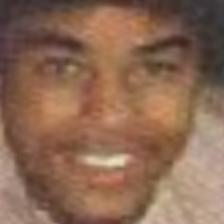

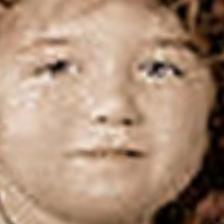

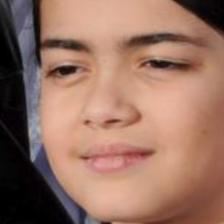

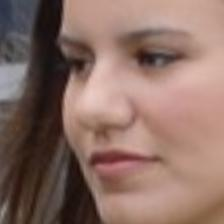

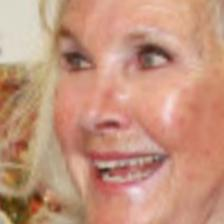

In [21]:
generator = np.random.default_rng(1234)
images = generator.choice(list(images_train.values()), size=(5,), replace=False, shuffle=False)
for image in images:
  show_image(image)

La correzione di gamma è l'applicazione di una funzione non lineare a tutti i pixel dell'immagine, che si preoccupa di equalizzare i diversi valori di luminosità. Questa dipende infatti da un parametro omonimo per cui, se $\gamma > 1$, i toni più chiari sono scuriti, mentre se $\gamma < 1$, i toni più scuri vengono schiariti.

L'idea è identificare automaticamente per ciascuna immagine il valore del parametro e la scelta è ricaduta su di un metodo utilizzato anche in alcuni software di *photoediting*. Questa tecnica consiste nel calcolare gamma come il rapporto del logaritmo della media della luminosità di tutti i pixel fratto il logaritmo di 128. In questo modo, nell'immagine la luminosità media apparirà come 50% luminosa e tutte le altre saranno tarate in conseguenza.

Poiché i pixel sono nello spazio colore BGR, viene prima fatta una conversione nello spazio HSV, corretto il canale inerente alla luminosità, ovvero "Value", e poi riconvertite in BGR.

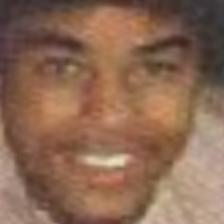

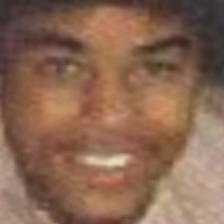

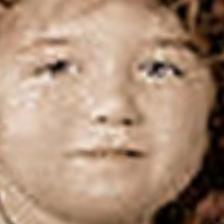

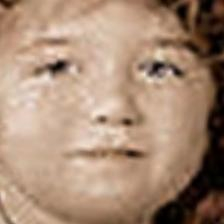

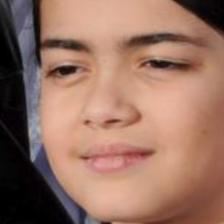

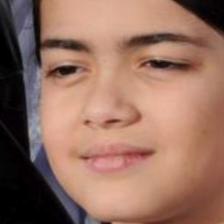

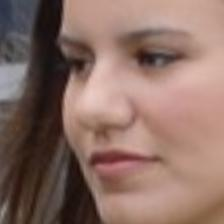

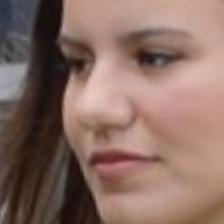

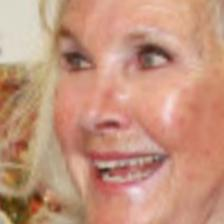

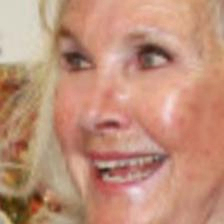

In [22]:
for image in images:
  hsv_image = cv.cvtColor(image, cv.COLOR_BGR2HSV)
  h, s, v = cv.split(hsv_image)
  gamma = np.log(v.mean()) / np.log(128)
  corrected_v = (255 * ((v / 255) ** gamma)).astype(np.uint8)
  corrected = cv.cvtColor(np.dstack([h, s, corrected_v]), cv.COLOR_HSV2BGR)
  show_image(image)
  show_image(corrected)
  print()

Applichiamo quindi la correzione di gamma a tutte le immagini, sia del *train set* che del *test set*.

In [23]:
def correct_gamma(image):
  hsv_image = cv.cvtColor(image, cv.COLOR_BGR2HSV)
  h, s, v = cv.split(hsv_image)
  gamma = np.log(v.mean()) / np.log(128)
  corrected_v = (255 * ((v / 255) ** gamma)).astype(np.uint8)
  return cv.cvtColor(np.dstack([h, s, corrected_v]), cv.COLOR_HSV2BGR)

images_train = {path: correct_gamma(image) for path, image in images_train.items()}
images_test = {path: correct_gamma(image) for path, image in images_test.items()}

### Forma del naso

Per quanto riguarda il naso, la feature più interessante è certamente la sua forma. Anche in questo caso, la prima cosa che è stato necessario fare è quella di individuare la parte dell'immagine che la contiene.
Il naso si trova sempre tra gli occhi, limitato dagli estremi di questi a destra e a sinistra, perciò rispetto alla posizione di questi ultimi sono stati aggiunti o rimossi tanti pixel quanti ne conta il semiasse maggiore dell'ellisse che modella l'occhio. L'estremo superiore della bounding box è sempre la linea degli occhi, mentre invece l'estremo inferiore deve cadere tra la bocca e il naso, quindi all'incirca ai 15/24 dell'altezza dell'immagine.

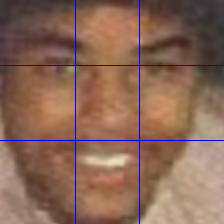

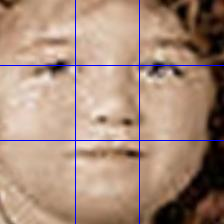

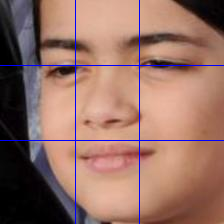

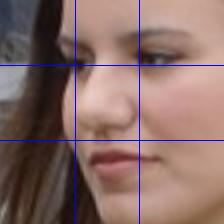

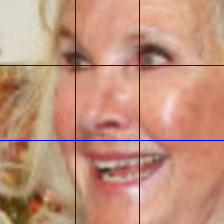

In [24]:
for image in images:
  image_lines = image.copy()
  lines = [
      (  # eye line
          (0, image_lines.shape[0] * 7 // 24),
          (image_lines.shape[1], image_lines.shape[0] * 7 // 24)
      ),
      (  # left eye right extremity
          (image_lines.shape[1] * 7 // 24 + 10, 0),
          (image_lines.shape[1] * 7 // 24 + 10, image_lines.shape[0])
      ),
      (  # right eye left extremity
          (image_lines.shape[1] * 2 // 3 - 10, 0),
          (image_lines.shape[1] * 2 // 3 - 10, image_lines.shape[0])
      ),
      (  # inbetween line
          (0, image_lines.shape[0] * 15 // 24),
          (image_lines.shape[1], image_lines.shape[0] * 15 // 24)
      )
  ]
  for line in lines:
      cv.line(
          image_lines,
          line[0],
          line[1],
          (255, 0, 0),
          1
      )
  show_image(image_lines)

Disegnamo poi un rettangolo attorno al naso, per poterlo ritagliare e concentrarci sull'estrazione solo della sua forma.

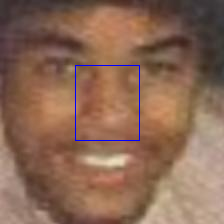

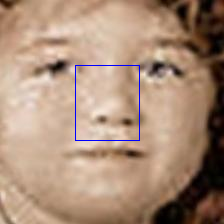

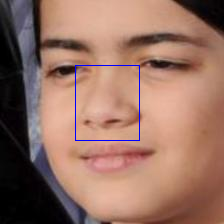

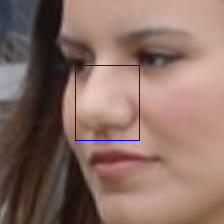

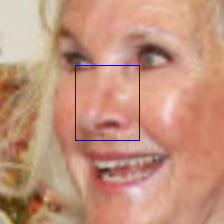

In [25]:
for image in images:
  image_lines = image.copy()
  cv.rectangle(
    image_lines,
    (image_lines.shape[1] * 7 // 24 + 10, image_lines.shape[0] * 7 // 24),
    (image_lines.shape[1] * 2 // 3 - 10, image_lines.shape[0] * 15 // 24),
    (255, 0, 0),
    1
  )
  show_image(image_lines)

Per estrarre la forma del naso, prima di tutto si converte l'immagine in *grayscale*, poi la si ritaglia all'altezza del naso come già detto e in seguito si applica un filtro per la riduzione del rumore, ovvero un filtro di *blur* gaussiano. Il filtro deve essere particolarmente grande, quindi forte, perché il processo di isteresi del "Canny edge detector" utilizzato subito dopo dovrà utilizzare dei valori molto bassi. Questo perché le variazioni di luminosità che indicano i contorni del naso sono molto ridotte. È stato trovato che con un filtro di dimensioni 3x9 e sigma 0 i risultati sono migliori, perché i bordi orizzontali sono facili da individuare, mentre quelli verticali si perdono facilmente. I valori per il Canny edge detector che si sono rivelati migliori sono 15 e 30 e si è utilizzato il gradiente più raffinato data la complessità di estrazione dei bordi.

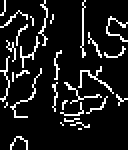

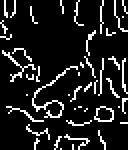

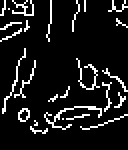

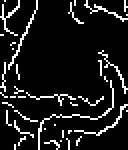

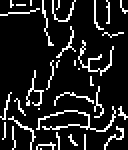

In [26]:
cannys = []
for image in images:
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  image_cropped = image_gray[
    (image_gray.shape[0] * 7 // 24):(image_gray.shape[0] * 15 // 24),
    (image_gray.shape[1] * 7 // 24 + 10):(image_gray.shape[1] * 2 // 3 - 10)
  ]
  image_blurred = cv.GaussianBlur(image_cropped, (3, 9), 0)
  canny = cv.Canny(image_blurred, 15, 30, L2gradient=True)
  cannys.append(canny)
  show_image(cv.resize(canny, None, None, 2, 2, cv.INTER_NEAREST))
  print()

Per migliorare l'immagine binaria ottenuta, si è ricorso ad una serie di operazioni di morfologia matematica per colmare le lacune tra i bordi ed ottenere perciò un contorno unico. Si è operata prima un'operazione di chiusura per colmare le lacune che si trovano tra i frammenti di bordo, anche molto grandi a causa della difficoltà riscontrata dall'operazione di "edge detection". Si è infatti adoperato un elemento strutturante 7x7 ellissoidale, in modo che i contorni avessero un aspetto più naturale. Dopodiché, si è effettuata un'operazione di dilatazione dei contorni per congiungerli tra di loro, seguita da una di erosione per riportarli al loro spessore originale. L'elemento strutturante utilizzato in questo caso, per entrambe le operazioni, è un ellisse 3x3.

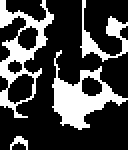

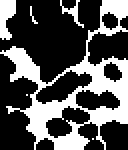

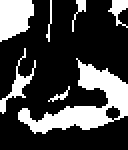

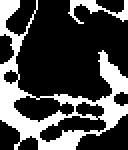

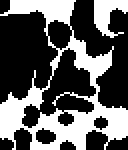

In [27]:
morphed = []

for image in cannys:
  elem_1 = cv.getStructuringElement(cv.MORPH_ELLIPSE, (7, 7))
  closed = cv.morphologyEx(image, cv.MORPH_CLOSE, elem_1)
  elem_2 = cv.getStructuringElement(cv.MORPH_ELLIPSE, (3, 3))
  dilated = cv.morphologyEx(closed, cv.MORPH_DILATE, elem_2)
  eroded = cv.morphologyEx(dilated, cv.MORPH_ERODE, elem_2)
  morphed.append(eroded)
  show_image(cv.resize(eroded, None, None, 2, 2, cv.INTER_NEAREST))
  print()

Una volta ottenuti i contorni del naso finali, è stato possibile estrarre le *feature* di interesse.

Innanzitutto sono stati eliminati i bordi ancora non connessi, che a questo punto possiamo considerare come non appartenenti al naso. Questo è stato fatto attraverso l'operazione di etichettatura delle componenti connesse, andando a tenere solamente quella con area, cioè numero di pixel, maggiore.

Dopodiché si sono estratte le coordinate del centroide, nonché, sapendo le dimensioni della bounding box, l'elongazione. Si è calcolato il *convex hull* e con questo si è ottenuta la convessità della forma del naso. Queste informazioni sono utili per capire la lunghezza del naso, se è più lungo o più corto, nonché la sua tipologia, ovvero se è più "aquilino" o "schiacciato".

Infine, per non perdere completamente tutte le informazioni sulla forma del naso, si è ricorso ad un indicatore più complesso come i descrittori ellittici di Fourier. Questi descrittori costruiscono un'approssimazione dei contorni mediante una somma di ellissi ruotate o allungate in diversi modi. Queste ellissi sono estratte dalla trasformata di Fourier discreta del contorno, codificato sotto forma di segmenti lineari. Come spiegato nell'articolo originale di Kuhl e Giardina, "[Elliptic Fourier features of a closed contour](https://doi.org/10.1016/0146-664X(82)90034-X)", questi descrittori sono invarianti per rotazione, scala e traslazione e sono molto compatti, dato che un ellisse utilizza solamente 4 parametri. In questo modo, è possibile utilizzare fino a 64 curve per approssimare il contorno senza generare troppe *feature*.

L'estrazione delle feature tramite "shape matrix" è stata ritenuta troppo semplice in confronto a descrittori così avanzati come gli E.F.D. a parità di numero di valori. Indicatori come "Beam Angle Statistics" e i descrittori di Fourier semplici soffrono del problema di non poter essere estratti in numero fisso. Questo significa che o è necessario aggiungere del "padding" alla sequenza dei punti che compongono il contorno o occorre campionarlo per arrivare al numero desiderato di punti. Entrambe le operazioni, che vanno ad introdurre errore nella rappresentazione, non sono affatto desiderabili. Solamente i descrittori di Fourier, essendo coefficienti di serie di Fourier, possono essere troncati dopo essere stati calcolati ottenendo ancora un risultato valido, ma approssimato. Rimane irrisolto però il problema del padding. L'utilizzo degli E.F.D. risulta perciò più semplice a parità di informazioni estratte.

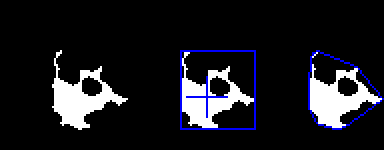

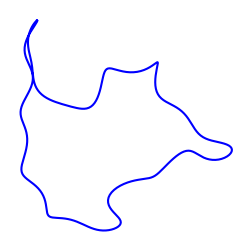


elongation:-0.05263157894736836, convexity:0.7093134412301617



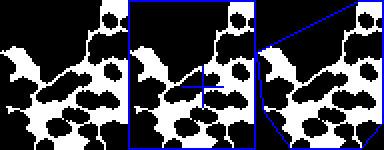

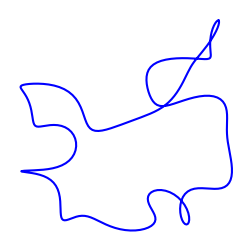


elongation:-0.171875, convexity:0.5502981564198302



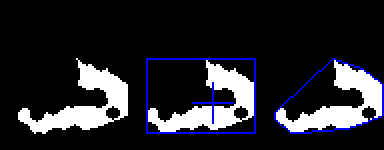

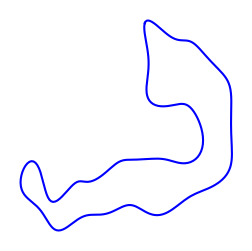


elongation:0.3090909090909091, convexity:0.6822317314733137



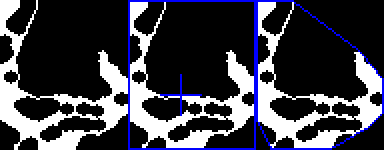

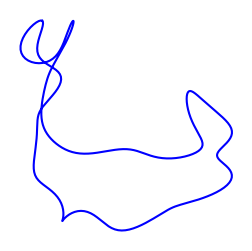


elongation:-0.171875, convexity:0.5686514987254719



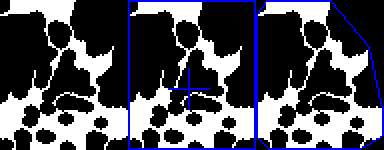

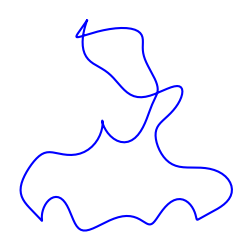


elongation:-0.171875, convexity:0.5900304201842625



In [28]:
for image in morphed:
  (num_labels, labels, stats, centroids) = cv.connectedComponentsWithStats(image)

  if num_labels == 1:
    print("Nose not found")
    break

  biggest_cc = np.argmax(stats[1:, cv.CC_STAT_AREA]) + 1

  centroid = centroids[biggest_cc]
  elongation = 1 - stats[biggest_cc, cv.CC_STAT_HEIGHT] / stats[biggest_cc, cv.CC_STAT_WIDTH]

  shape = np.array((labels == biggest_cc) * 255, dtype=np.uint8)
  contours, _ = cv.findContours(shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
  convex_hull = cv.convexHull(contours[0])
  convexity = cv.arcLength(convex_hull, True) / cv.arcLength(contours[0], True)

  elliptic_coeffs = elliptic_fourier_descriptors(np.squeeze(contours[0]), order=16)

  shape_with_bb = cv.rectangle(
    np.stack([shape, shape, shape], axis=2),
    (stats[biggest_cc, cv.CC_STAT_LEFT], stats[biggest_cc, cv.CC_STAT_TOP]),
    (
      stats[biggest_cc, cv.CC_STAT_LEFT] + stats[biggest_cc, cv.CC_STAT_WIDTH] - 1,
      stats[biggest_cc, cv.CC_STAT_TOP] + stats[biggest_cc, cv.CC_STAT_HEIGHT] - 1
    ),
    (255, 0, 0),
    1
  )
  shape_with_bb = cv.drawMarker(
    shape_with_bb,
    (int(centroid[0]), int(centroid[1])),
    (255, 0, 0),
    cv.MARKER_CROSS
  )

  shape_with_ch = cv.drawContours(
    np.stack([shape, shape, shape], axis=2),
    [convex_hull],
    0,
    (255, 0, 0),
    1
  )

  show_image(cv.resize(
    np.hstack([np.dstack([shape, shape, shape]), shape_with_bb, shape_with_ch]),
    None,
    None,
    2,
    2,
    cv.INTER_NEAREST
  ))
  print()
  t = np.linspace(0, 1.0, 300)
  xt = np.zeros((300,))
  yt = np.zeros((300,))
  for n in range(elliptic_coeffs.shape[0]):
    xt += (elliptic_coeffs[n, 0] * np.cos(2 * (n + 1) * np.pi * t)) + (
      elliptic_coeffs[n, 1] * np.sin(2 * (n + 1) * np.pi * t)
    )
    yt += (elliptic_coeffs[n, 2] * np.cos(2 * (n + 1) * np.pi * t)) + (
      elliptic_coeffs[n, 3] * np.sin(2 * (n + 1) * np.pi * t)
    )
  plt.figure(figsize=(3, 3))
  plt.plot(xt, yt, "b")
  plt.gca().invert_yaxis()
  plt.axis("off")
  plt.show()
  print(f"\nelongation:{elongation}, convexity:{convexity}\n")

In questo modo, si è determinato il processo di estrazione della forma del naso da un'immagine. Nel caso in cui non venga trovata neanche una componente connessa, cioè l'immagine trasformata non contenga nessun potenziale contorno del naso, semplicemente viene restituito un valore di speciale, che farà scartare l'immagine. Le posizioni dei centroidi sono normalizzate dividendole per le dimensioni dell'immagine.

In [29]:
def extract_nose_shape(image):
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  image_cropped = image_gray[
    (image_gray.shape[0] * 7 // 24):(image_gray.shape[0] * 7 // 12),
    (image_gray.shape[1] * 7 // 24 + 10):(image_gray.shape[1] * 2 // 3 - 10)
  ]
  image_blurred = cv.GaussianBlur(image_cropped, (3, 9), 0)
  canny = cv.Canny(image_blurred, 15, 30, L2gradient=True)
  elem_1 = cv.getStructuringElement(cv.MORPH_ELLIPSE, (7, 7))
  closed = cv.morphologyEx(canny, cv.MORPH_CLOSE, elem_1)
  elem_2 = cv.getStructuringElement(cv.MORPH_ELLIPSE, (3, 3))
  dilated = cv.morphologyEx(closed, cv.MORPH_DILATE, elem_2)
  eroded = cv.morphologyEx(dilated, cv.MORPH_ERODE, elem_2)
  (num_labels, labels, stats, centroids) = cv.connectedComponentsWithStats(eroded)

  if num_labels == 1:
    return None

  biggest_cc = np.argmax(stats[1:, cv.CC_STAT_AREA]) + 1

  centroid = centroids[biggest_cc]
  elongation = 1 - stats[biggest_cc, cv.CC_STAT_HEIGHT] / stats[biggest_cc, cv.CC_STAT_WIDTH]

  shape = np.array((labels == biggest_cc) * 255, dtype=np.uint8)
  contours, _ = cv.findContours(shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
  convex_hull = cv.convexHull(contours[0])
  convexity = cv.arcLength(contours[0], False) / cv.arcLength(convex_hull, True)

  elliptic_coeffs = elliptic_fourier_descriptors(np.squeeze(contours[0]), order=16, normalize=True).flatten()[3:]

  return np.concatenate([
    [centroid[0] / image.shape[1], centroid[1] / image.shape[0], elongation, convexity],
    elliptic_coeffs
  ], axis=None)

### Forma della bocca

Il processo di estrazione della forma della bocca è analogo a quello per la forma del naso, in quanto il metodo per identificare i contorni è sempre lo stesso. Naturalmente, la parte dell'immagine coinvolta come i parametri dei diversi passi che compongono il processo sono differenti, ma i concetti rimangono sempre gli stessi.

In un volto, la bocca è sempre posizionata al di sotto del naso. Per questo motivo, l'estremo superiore del rettangolo che la contiene è delimitato dalla linea che in precedenza è stata utilizzata per indicare la fine della zona del naso. Poiché la bocca è molto lunga e le sue estremità si trovano sotto gli occhi, ma non completamente, per identificare i suoi limiti sono state utilizzare le posizioni degli occhi, a cui sono stati sottratti a sinistra e aggiunti a destra i 3/2 del semiasse maggiore dell'ellisse che contiene gli stessi. Si è inoltre determinato che la posizione migliore per delimitare inferiormente la zona della bocca è ai 7/8 dell'immagine.

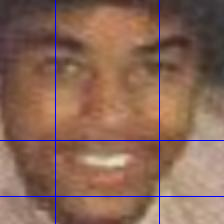

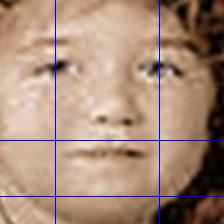

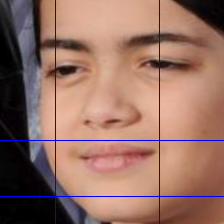

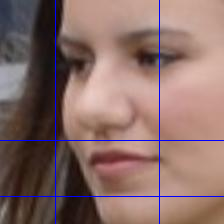

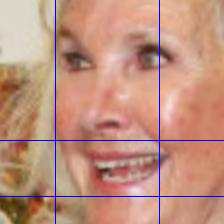

In [30]:
for image in images:
  image_lines = image.copy()
  lines = [
      (  # left eye left extremity
          (image_lines.shape[1] * 7 // 24 - 10, 0),
          (image_lines.shape[1] * 7 // 24 - 10, image_lines.shape[0])
      ),
      (  # right eye
          (image_lines.shape[1] * 2 // 3 + 10, 0),
          (image_lines.shape[1] * 2 // 3 + 10, image_lines.shape[0])
      ),
      (  # inbetween line
          (0, image_lines.shape[0] * 15 // 24),
          (image_lines.shape[1], image_lines.shape[0] * 15 // 24)
      ),
      (  # under mouth line
          (0, image_lines.shape[0] * 7 // 8),
          (image_lines.shape[1], image_lines.shape[0] * 7 // 8)
      )
  ]
  for line in lines:
      cv.line(
          image_lines,
          line[0],
          line[1],
          (255, 0, 0),
          1
      )
  show_image(image_lines)

Come già fatto in precedenza, si è poi disegnato un rettangolo attorno alla bocca con le linee poc'anzi definite per poterla poi ritagliare dall'immagine.

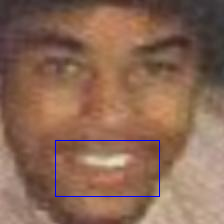

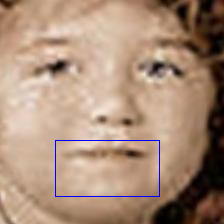

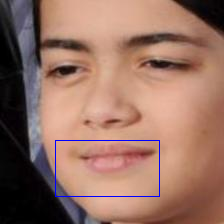

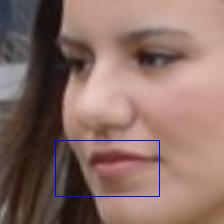

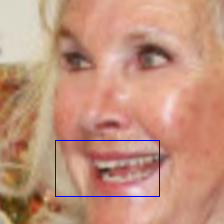

In [31]:
for image in images:
  image_lines = image.copy()
  cv.rectangle(
    image_lines,
    (image_lines.shape[1] * 7 // 24 - 10, image_lines.shape[0] * 15 // 24),
    (image_lines.shape[1] * 2 // 3 + 10, image_lines.shape[0] * 7 // 8),
    (255, 0, 0),
    1
  )
  show_image(image_lines)

Con l'utilizzo del "Canny edge detector" sono stati estrapolati i bordi della bocca dall'area dell'immagine identificata in precedenza. Sull'area è statp prima applicato un filtro gaussiano 3x3 con sigma 0, poi il *detector* effettivo. Le soglie di isteresi che si sono rivelate migliori sono state 40 e 60 e anche in questo caso si è ricorso al gradiente più preciso.

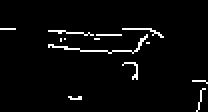

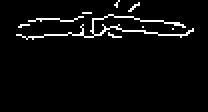

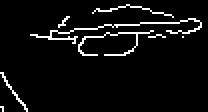

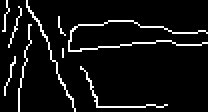

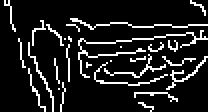

In [32]:
cannys = []
for image in images:
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  image_cropped = image_gray[
    (image_gray.shape[0] * 15 // 24):(image_gray.shape[0] * 7 // 8),
    (image_gray.shape[1] * 7 // 24 - 10):(image_gray.shape[1] * 2 // 3 + 10)
  ]
  image_blurred = cv.GaussianBlur(image_cropped, (3, 3), 0)
  canny = cv.Canny(image_blurred, 40, 60, L2gradient=True)
  cannys.append(canny)
  show_image(cv.resize(canny, None, None, 2, 2, cv.INTER_NEAREST))
  print()

Si sono applicate le stesse operazioni di chiusura, dilatazione ed erosione che in precedenza. In questo caso per tutte le operazioni si è usato un elemento strutturante ellissoidale 7x7.

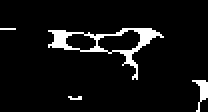

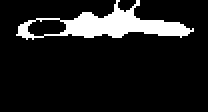

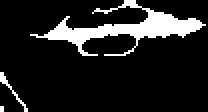

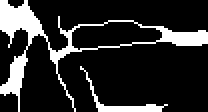

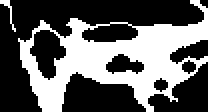

In [33]:
morphed = []

for image in cannys:
  elem = cv.getStructuringElement(cv.MORPH_ELLIPSE, (7, 7))
  closed = cv.morphologyEx(image, cv.MORPH_CLOSE, elem)
  dilated = cv.morphologyEx(closed, cv.MORPH_DILATE, elem)
  eroded = cv.morphologyEx(dilated, cv.MORPH_ERODE, elem)
  morphed.append(eroded)
  show_image(cv.resize(eroded, None, None, 2, 2, cv.INTER_NEAREST))
  print()

Da ultimo, sono state eliminate tutte le componenti connesse che non erano la più grande e poi, su questa, sono stati calcolati il centroide e l'elongazione. Calcolati i contorni è stato poi possibile calcolare il *convex hull* e quindi la convessità. Per catturare anche informazioni più complesse, sono stati calcolati i descrittori ellittici di Fourier di grado 16.

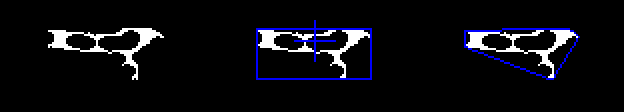

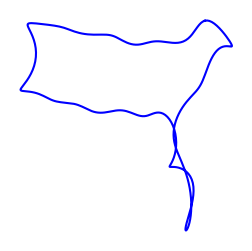


elongation:0.5517241379310345, convexity:0.7960731454980924



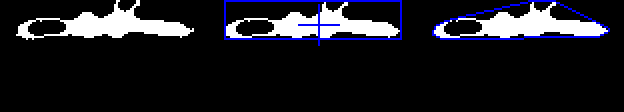

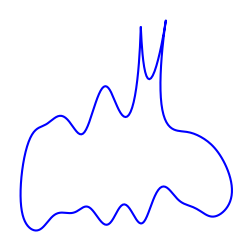


elongation:0.7752808988764045, convexity:0.8303481943055562



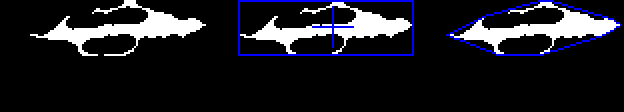

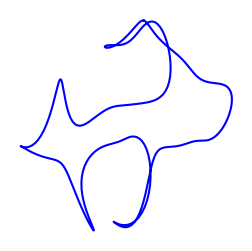


elongation:0.6818181818181819, convexity:0.5411948221264414



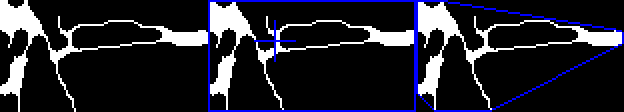

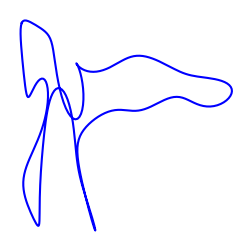


elongation:0.46153846153846156, convexity:0.5780551742433538



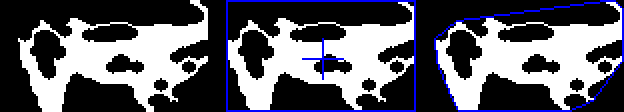

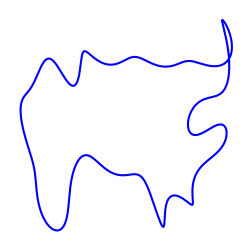


elongation:0.41052631578947374, convexity:0.6489056521190995



In [34]:
for image in morphed:
  (num_labels, labels, stats, centroids) = cv.connectedComponentsWithStats(image)

  if num_labels == 1:
    print("Mouth not found")
    break

  biggest_cc = np.argmax(stats[1:, cv.CC_STAT_AREA]) + 1

  centroid = centroids[biggest_cc]
  elongation = 1 - stats[biggest_cc, cv.CC_STAT_HEIGHT] / stats[biggest_cc, cv.CC_STAT_WIDTH]

  shape = np.array((labels == biggest_cc) * 255, dtype=np.uint8)
  contours, _ = cv.findContours(shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
  convex_hull = cv.convexHull(contours[0])
  convexity = cv.arcLength(convex_hull, True) / cv.arcLength(contours[0], True)

  elliptic_coeffs = elliptic_fourier_descriptors(np.squeeze(contours[0]), order=16)

  shape_with_bb = cv.rectangle(
    np.stack([shape, shape, shape], axis=2),
    (stats[biggest_cc, cv.CC_STAT_LEFT], stats[biggest_cc, cv.CC_STAT_TOP]),
    (
      stats[biggest_cc, cv.CC_STAT_LEFT] + stats[biggest_cc, cv.CC_STAT_WIDTH] - 1,
      stats[biggest_cc, cv.CC_STAT_TOP] + stats[biggest_cc, cv.CC_STAT_HEIGHT] - 1
    ),
    (255, 0, 0),
    1
  )
  shape_with_bb = cv.drawMarker(
    shape_with_bb,
    (int(centroid[0]), int(centroid[1])),
    (255, 0, 0),
    cv.MARKER_CROSS
  )

  shape_with_ch = cv.drawContours(
    np.stack([shape, shape, shape], axis=2),
    [convex_hull],
    0,
    (255, 0, 0),
    1
  )

  show_image(cv.resize(
    np.hstack([np.dstack([shape, shape, shape]), shape_with_bb, shape_with_ch]),
    None,
    None,
    2,
    2,
    cv.INTER_NEAREST
  ))
  print()
  t = np.linspace(0, 1.0, 300)
  xt = np.zeros((300,))
  yt = np.zeros((300,))
  for n in range(elliptic_coeffs.shape[0]):
    xt += (elliptic_coeffs[n, 0] * np.cos(2 * (n + 1) * np.pi * t)) + (
      elliptic_coeffs[n, 1] * np.sin(2 * (n + 1) * np.pi * t)
    )
    yt += (elliptic_coeffs[n, 2] * np.cos(2 * (n + 1) * np.pi * t)) + (
      elliptic_coeffs[n, 3] * np.sin(2 * (n + 1) * np.pi * t)
    )
  plt.figure(figsize=(3, 3))
  plt.plot(xt, yt, "b")
  plt.gca().invert_yaxis()
  plt.axis("off")
  plt.show()
  print(f"\nelongation:{elongation}, convexity:{convexity}\n")

In questo modo, è stato determinato il processo di estrazione dei contorni della bocca. Nel caso in cui non venga trovata neanche una componente connessa, cioè l'immagine trasformata non contenga nessun potenziale contorno della bocca, semplicemente viene restituito un valore speciale per poter scartare l'immagine. Le posizioni dei centroidi sono normalizzate dividendole per le dimensioni dell'immagine.

In [35]:
def extract_mouth_shape(image):
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  image_cropped = image_gray[
    (image_gray.shape[0] * 15 // 24):(image_gray.shape[0] * 7 // 8),
    (image_gray.shape[1] * 7 // 24 - 10):(image_gray.shape[1] * 2 // 3 + 10)
  ]
  image_blurred = cv.GaussianBlur(image_cropped, (3, 3), 0)
  canny = cv.Canny(image_blurred, 40, 60, L2gradient=True)
  elem = cv.getStructuringElement(cv.MORPH_ELLIPSE, (7, 7))
  closed = cv.morphologyEx(canny, cv.MORPH_CLOSE, elem)
  dilated = cv.morphologyEx(closed, cv.MORPH_DILATE, elem)
  eroded = cv.morphologyEx(dilated, cv.MORPH_ERODE, elem)
  (num_labels, labels, stats, centroids) = cv.connectedComponentsWithStats(eroded)

  if num_labels == 1:
    return None

  biggest_cc = np.argmax(stats[1:, cv.CC_STAT_AREA]) + 1

  centroid = centroids[biggest_cc]
  elongation = 1 - stats[biggest_cc, cv.CC_STAT_HEIGHT] / stats[biggest_cc, cv.CC_STAT_WIDTH]

  shape = np.array((labels == biggest_cc) * 255, dtype=np.uint8)
  contours, _ = cv.findContours(shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
  convex_hull = cv.convexHull(contours[0])
  convexity = cv.arcLength(convex_hull, True) / cv.arcLength(contours[0], True)

  elliptic_coeffs = elliptic_fourier_descriptors(np.squeeze(contours[0]), order=16, normalize=True).flatten()[3:]

  return np.concatenate([
    [centroid[0] / image.shape[1], centroid[1] / image.shape[0], elongation, convexity],
    elliptic_coeffs
  ], axis=None)

### Forma di occhi e sopracciglia

Anche per questo terzo ed ultimo caso dove si trattava di estrapolare di nuovo la forma di oggetti, in particolare degli occhi e delle sopracciglia, sono state utilizzate le stesse tecniche che in precedenza.

In questo caso sono state individuate due aree per ciascuna immagine, ciascuna corrispondente ad un singolo occhio. A partire dalla posizione degli occhi, sono stati definiti degli *offset* che permettessero di disegnare due rettangoli che permettessero di contenerli interamente. Gli estremi inferiore e superiore sono rispettivamente 40 pixel prima e 20 pixel dopo la posizione degli occhi. Per l'occhio sinistro l'estremità sinistra si trova 25 pixel prima del suo centro mentre l'estremità destra 30 pixel dopo. Per quanto riguarda l'occhio destro, l'estremità sinistra si trova 25 pixel prima, mentre quella destra 25 pixel dopo.

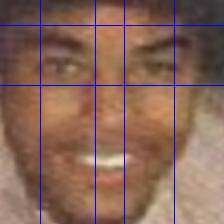

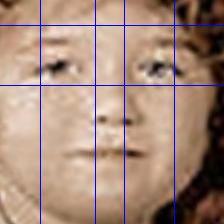

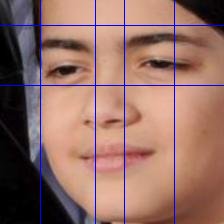

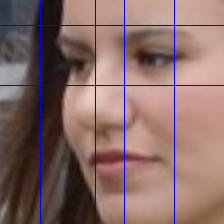

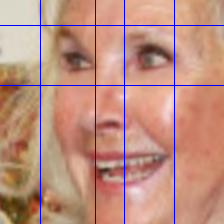

In [36]:
for image in images:
  image_lines = image.copy()
  lines = [
    (  # above eye line
      (0, image_lines.shape[0] * 7 // 24 - 40),
      (image_lines.shape[1], image_lines.shape[0] * 7 // 24 - 40)
    ),
    (  # left eye left extremity
      (image_lines.shape[1] * 7 // 24 - 25, 0),
      (image_lines.shape[1] * 7 // 24 - 25, image_lines.shape[0])
    ),
    (  # left eye right extremity
      (image_lines.shape[1] * 7 // 24 + 30, 0),
      (image_lines.shape[1] * 7 // 24 + 30, image_lines.shape[0])
    ),
    (  # right eye left extremity
      (image_lines.shape[1] * 2 // 3 - 25, 0),
      (image_lines.shape[1] * 2 // 3 - 25, image_lines.shape[0])
    ),
    (  # right eye right extremity
      (image_lines.shape[1] * 2 // 3 + 25, 0),
      (image_lines.shape[1] * 2 // 3 + 25, image_lines.shape[0])
    ),
    (  # under eye line
      (0, image_lines.shape[0] * 7 // 24 + 20),
      (image_lines.shape[1], image_lines.shape[0] * 7 // 24 + 20)
    ),
  ]
  for line in lines:
      cv.line(
          image_lines,
          line[0],
          line[1],
          (255, 0, 0),
          1
      )
  show_image(image_lines)

Definiti le posizioni dei contorni, sono stati disegnati i due rettangoli come determinato.

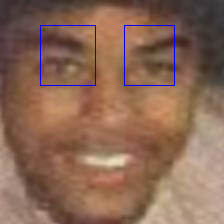

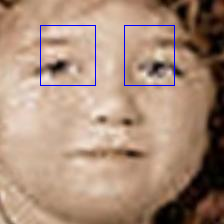

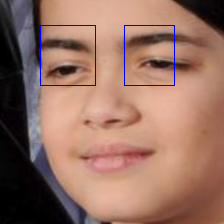

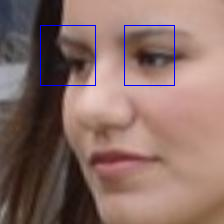

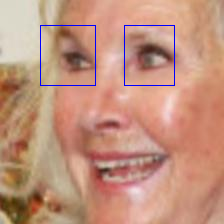

In [37]:
for image in images:
  image_lines = image.copy()
  cv.rectangle(
    image_lines,
    (image_lines.shape[1] * 7 // 24 - 25, image_lines.shape[0] * 7 // 24 - 40),
    (image_lines.shape[1] * 7 // 24 + 30, image_lines.shape[0] * 7 // 24 + 20),
    (255, 0, 0),
    1
  )
  cv.rectangle(
    image_lines,
    (image_lines.shape[1] * 2 // 3 - 25, image_lines.shape[0] * 7 // 24 - 40),
    (image_lines.shape[1] * 2 // 3 + 25, image_lines.shape[0] * 7 // 24 + 20),
    (255, 0, 0),
    1
  )
  show_image(image_lines)

In seguito è stato applicato un filtro gaussiano su entrambe le sottoimmagini estratte di dimensioni 3x3 e sigma 0. Subito dopo, sono stati estratti i contorni di occhi e sopracciglia mediante "Canny edge detector" usando come soglie di isteresi 40 e 50 e un gradiente più accurato.

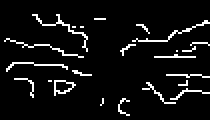

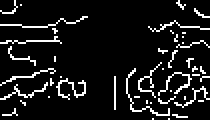

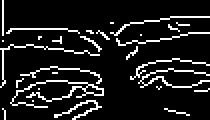

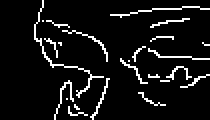

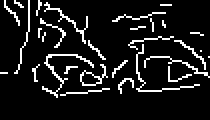

In [38]:
cannys = []
for image in images:
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  left_eye_cropped = image_gray[
    (image_gray.shape[0] * 7 // 24 - 40):(image_gray.shape[0] * 7 // 24 + 20),
    (image_gray.shape[1] * 7 // 24 - 25):(image_gray.shape[1] * 7 // 24 + 30)
  ]
  right_eye_cropped = image_gray[
    (image_gray.shape[0] * 7 // 24 - 40):(image_gray.shape[0] * 7 // 24 + 20),
    (image_gray.shape[1] * 2 // 3 - 25):(image_gray.shape[1] * 2 // 3 + 25)
  ]
  left_eye_blurred = cv.GaussianBlur(left_eye_cropped, (3, 3), 0)
  right_eye_blurred = cv.GaussianBlur(right_eye_cropped, (3, 3), 0)
  left_eye_canny = cv.Canny(left_eye_blurred, 40, 50, L2gradient=True)
  right_eye_canny = cv.Canny(right_eye_blurred, 40, 50, L2gradient=True)
  cannys.append((left_eye_canny, right_eye_canny))
  show_image(cv.resize(np.hstack([left_eye_canny, right_eye_canny]), None, None, 2, 2, cv.INTER_NEAREST))
  print()

Sono poi stati chiusi eventuali contorni scollegati tra di loro con un'operazione di chiusura morfologica e poi sono state applicate due operazioni di dilatazione ed erosione per colmare ulteriori separazioni nell'immagine. Tutte le operazioni sono state fatte usando lo stesso elemento strutturante 5x5 ellissoidale su entrambe le sottoimmagini.

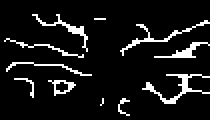

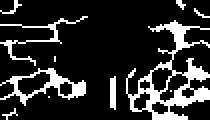

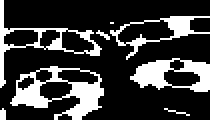

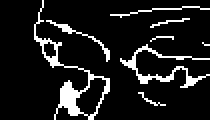

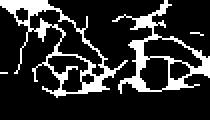

In [39]:
morphed = []

for (left_image, right_image) in cannys:
  elem = cv.getStructuringElement(cv.MORPH_ELLIPSE, (5, 5))
  left_closed = cv.morphologyEx(left_image, cv.MORPH_CLOSE, elem)
  right_closed = cv.morphologyEx(right_image, cv.MORPH_CLOSE, elem)
  left_dilated = cv.morphologyEx(left_closed, cv.MORPH_DILATE, elem)
  right_dilated = cv.morphologyEx(right_closed, cv.MORPH_DILATE, elem)
  left_eroded = cv.morphologyEx(left_dilated, cv.MORPH_ERODE, elem)
  right_eroded = cv.morphologyEx(right_dilated, cv.MORPH_ERODE, elem)
  morphed.append((left_eroded, right_eroded))
  show_image(cv.resize(np.hstack([left_eroded, right_eroded]), None, None, 2, 2, cv.INTER_NEAREST))
  print()

Da ultimo, vengono estratti i descrittori di forma per gli occhi e le sopracciglia. In caso le operazioni precedenti siano state effettuate in modo tale da ottenere risultati sensati, la componente connessa di area più grande, quindi che contiene il maggior numero di pixel, è necessariamente l'occhio. Individuata la componente connessa, è facile trovare il centroide, l'elongazione e i suoi contorni. Dai contorni si ottiene il *convex hull* e così la convessità. Infine, vengono calcolati i descrittori ellittici di Fourier per il contorno dell'occhio come precedentemente estratto.

L'individuazione del sopracciglio è leggermente più complessa. Innanzitutto, si eliminano tutte le componenti connesse il cui centroide ha una ordinata pari o superiore all'ordinata più in alto della *bounding box* della componente connessa dell'occhio. Questo perché ci aspettiamo che il sopracciglio si trovi sempre e comunque al di sopra dell'occhio e mai sotto o all'interno di questo. Limitarsi a considerare il centroide della componente connessa e non le dimensioni della stessa permette sovrapposizioni tra le *bounding box* di queste, che è sempre possibile. Tra tutte le componenti connesse si sceglie sempre quella di area maggiore, che dovrebbe essere il risultato dell'aggregazione delle diverse parti del contorno del sopracciglio.

----------------------------------


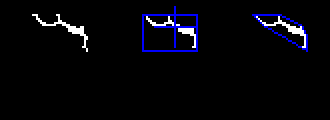

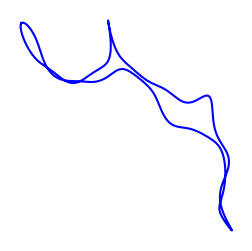


eye elongation:0.3214285714285714, eye convexity:0.7727932820168568


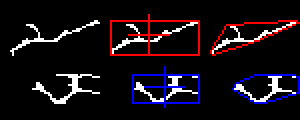

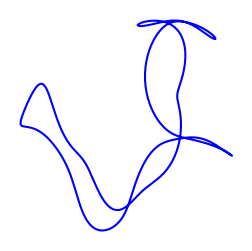

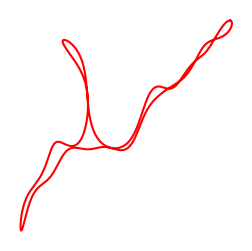


eye elongation:0.5588235294117647, eye convexity:0.5754128794175539
eyebrow elongation:0.6, eyebrow convexity:0.7827311879863641

----------------------------------


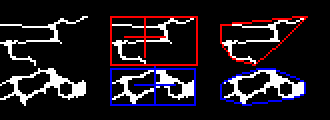

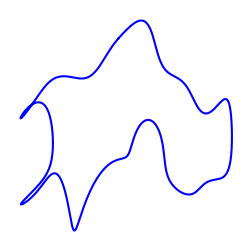

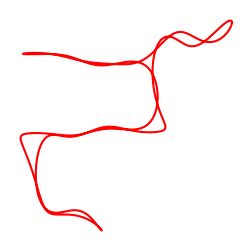


eye elongation:0.5581395348837209, eye convexity:0.7289697145860489
eyebrow elongation:0.43181818181818177, eyebrow convexity:0.520070828237021



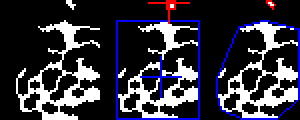

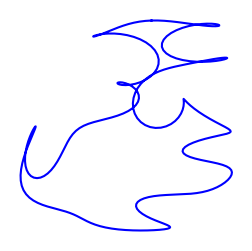

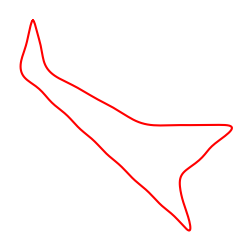


eye elongation:-0.19047619047619047, eye convexity:0.426971466275694
eyebrow elongation:0.0, eyebrow convexity:0.9415555014551922

----------------------------------


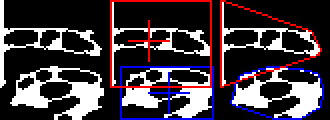

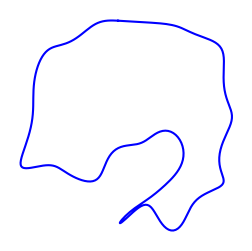

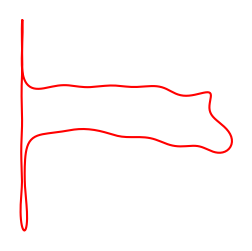


eye elongation:0.42553191489361697, eye convexity:0.7008866027132691
eyebrow elongation:0.13725490196078427, eyebrow convexity:0.8083787469860497



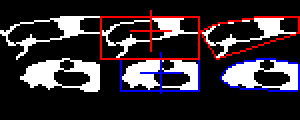

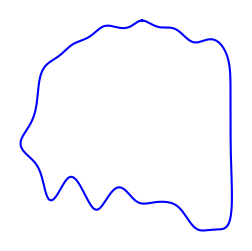

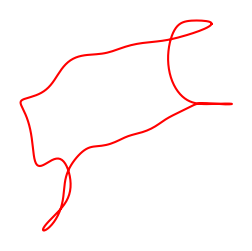


eye elongation:0.575, eye convexity:0.9263649618710106
eyebrow elongation:0.56, eyebrow convexity:0.7652467614366057

----------------------------------


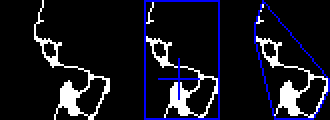

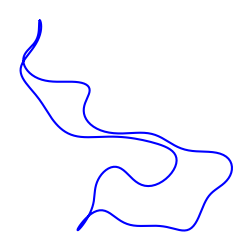


eye elongation:-0.5789473684210527, eye convexity:0.6476222821562753


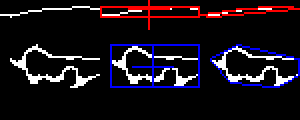

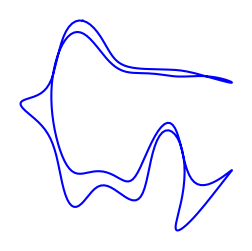

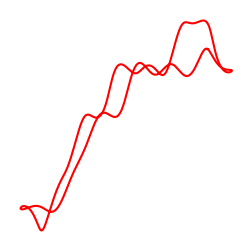


eye elongation:0.5111111111111111, eye convexity:0.46916909208576907
eyebrow elongation:0.88, eyebrow convexity:0.9578075420444827

----------------------------------


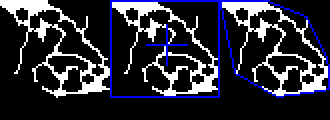

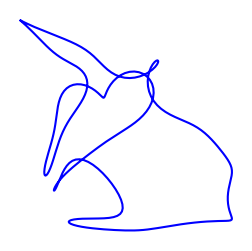


eye elongation:0.10909090909090913, eye convexity:0.5265780299650491


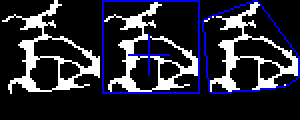

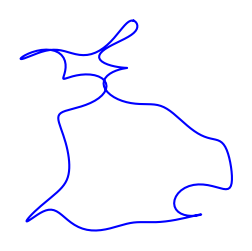


eye elongation:0.04081632653061229, eye convexity:0.5514236285827607


In [40]:
for (left_image, right_image) in morphed:
  print("----------------------------------")

  for image in [left_image, right_image]:
    (num_labels, labels, stats, centroids) = cv.connectedComponentsWithStats(image)

    if num_labels < 3:
      print("No eye or eyebrow found")
      break

    biggest_cc = np.argmax(stats[1:, cv.CC_STAT_AREA]) + 1
    eye_centroid = centroids[biggest_cc]
    eye_elongation = 1 - stats[biggest_cc, cv.CC_STAT_HEIGHT] / stats[biggest_cc, cv.CC_STAT_WIDTH]

    eye_shape = np.array((labels == biggest_cc) * 255, dtype=np.uint8)
    eye_contours, _ = cv.findContours(eye_shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    eye_convex_hull = cv.convexHull(eye_contours[0])
    eye_convexity = cv.arcLength(eye_convex_hull, True) / cv.arcLength(eye_contours[0], True)

    eye_elliptic_coeffs = elliptic_fourier_descriptors(np.squeeze(eye_contours[0]), order=16)

    shape = eye_shape
    shape_with_bb = cv.rectangle(
      np.stack([eye_shape, eye_shape, eye_shape], axis=2),
      (stats[biggest_cc, cv.CC_STAT_LEFT], stats[biggest_cc, cv.CC_STAT_TOP]),
      (
        stats[biggest_cc, cv.CC_STAT_LEFT] + stats[biggest_cc, cv.CC_STAT_WIDTH] - 1,
        stats[biggest_cc, cv.CC_STAT_TOP] + stats[biggest_cc, cv.CC_STAT_HEIGHT] - 1
      ),
      (255, 0, 0),
      1
    )
    cv.drawMarker(
      shape_with_bb,
      (int(eye_centroid[0]), int(eye_centroid[1])),
      (255, 0, 0),
      cv.MARKER_CROSS
    )

    shape_with_ch = cv.drawContours(
      np.stack([eye_shape, eye_shape, eye_shape], axis=2),
      [eye_convex_hull],
      0,
      (255, 0, 0),
      1
    )

    possible_eyebrows = np.hstack([np.expand_dims(np.arange(1, num_labels), axis=1), centroids[1:]])
    possible_eyebrows = \
      possible_eyebrows[possible_eyebrows[:, 2] < stats[biggest_cc, cv.CC_STAT_TOP]][:, 0].astype(int)

    if possible_eyebrows.size != 0:
      second_biggest_cc = possible_eyebrows[np.argmax(stats[possible_eyebrows, cv.CC_STAT_AREA])]
      eyebrow_centroid = centroids[second_biggest_cc]
      eyebrow_elongation = 1 - stats[second_biggest_cc, cv.CC_STAT_HEIGHT] / stats[second_biggest_cc, cv.CC_STAT_WIDTH]

      eyebrow_shape = np.array((labels == second_biggest_cc) * 255, dtype=np.uint8)
      eyebrow_contours, _ = cv.findContours(eyebrow_shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
      eyebrow_convex_hull = cv.convexHull(eyebrow_contours[0])
      eyebrow_convexity = cv.arcLength(eyebrow_convex_hull, True) / cv.arcLength(eyebrow_contours[0], True)

      eyebrow_elliptic_coeffs = elliptic_fourier_descriptors(np.squeeze(eyebrow_contours[0]), order=16)

      shape = cv.bitwise_or(shape, eyebrow_shape)
      shape_with_bb = cv.rectangle(
        cv.bitwise_or(shape_with_bb, np.dstack([eyebrow_shape, eyebrow_shape, eyebrow_shape])),
        (stats[second_biggest_cc, cv.CC_STAT_LEFT], stats[second_biggest_cc, cv.CC_STAT_TOP]),
        (
          stats[second_biggest_cc, cv.CC_STAT_LEFT] + stats[second_biggest_cc, cv.CC_STAT_WIDTH] - 1,
          stats[second_biggest_cc, cv.CC_STAT_TOP] + stats[second_biggest_cc, cv.CC_STAT_HEIGHT] - 1
        ),
        (0, 0, 255),
        1
      )
      cv.drawMarker(
        shape_with_bb,
        (int(eyebrow_centroid[0]), int(eyebrow_centroid[1])),
        (0, 0, 255),
        cv.MARKER_CROSS
      )

      shape_with_ch = cv.drawContours(
        cv.bitwise_or(shape_with_ch, np.dstack([eyebrow_shape, eyebrow_shape, eyebrow_shape])),
        [eyebrow_convex_hull],
        0,
        (0, 0, 255),
        1
      )

    show_image(cv.resize(
      np.hstack([np.dstack([shape, shape, shape]), shape_with_bb, shape_with_ch]),
        None,
        None,
        2,
        2,
        cv.INTER_NEAREST
    ))
    print()
    t = np.linspace(0, 1.0, 300)
    xt = np.zeros((300,))
    yt = np.zeros((300,))
    for n in range(eye_elliptic_coeffs.shape[0]):
      xt += (eye_elliptic_coeffs[n, 0] * np.cos(2 * (n + 1) * np.pi * t)) + (
        eye_elliptic_coeffs[n, 1] * np.sin(2 * (n + 1) * np.pi * t)
      )
      yt += (eye_elliptic_coeffs[n, 2] * np.cos(2 * (n + 1) * np.pi * t)) + (
        eye_elliptic_coeffs[n, 3] * np.sin(2 * (n + 1) * np.pi * t)
      )
    plt.figure(figsize=(3, 3))
    plt.plot(xt, yt, "b")
    plt.gca().invert_yaxis()
    plt.axis("off")
    plt.show()
    if possible_eyebrows.size != 0:
      xt = np.zeros((300,))
      yt = np.zeros((300,))
      for n in range(eyebrow_elliptic_coeffs.shape[0]):
        xt += (eyebrow_elliptic_coeffs[n, 0] * np.cos(2 * (n + 1) * np.pi * t)) + (
          eyebrow_elliptic_coeffs[n, 1] * np.sin(2 * (n + 1) * np.pi * t)
        )
        yt += (eyebrow_elliptic_coeffs[n, 2] * np.cos(2 * (n + 1) * np.pi * t)) + (
          eyebrow_elliptic_coeffs[n, 3] * np.sin(2 * (n + 1) * np.pi * t)
        )
      plt.figure(figsize=(3, 3))
      plt.plot(xt, yt, "r")
      plt.gca().invert_yaxis()
      plt.axis("off")
      plt.show()
    print(f"\neye elongation:{eye_elongation}, eye convexity:{eye_convexity}")
    if possible_eyebrows.size != 0:
      print(f"eyebrow elongation:{eyebrow_elongation}, eyebrow convexity:{eyebrow_convexity}\n")

In questo modo, è stato possibile determinare il processo di estrazione della forma degli occhi e delle sopracciglia. Nel caso in cui non venga trovata neanche una componente connessa, cioè l'immagine trasformata non contenga nessun potenziale contorno degli occhi, semplicemente viene restituito un valore speciale. Se viene trovata solamente la componente connessa degli occhi e non quella delle sopracciglia, viene restituito un valore speciale. Poiché in alcune immagini la componente connessa delle sopracciglia è fatta da un solo pixel, la lunghezza del perimetro non può essere calcolata, così come i descrittori di Fourier ellittici. Anche in questo caso viene restituito un valore speciale, in modo tale che, come nei casi precedenti, l'immagine possa essere eliminata dall'estrazione delle *feature*.
Le posizioni dei centroidi sono normalizzate dividendole per le dimensioni dell'immagine.

In [41]:
def extract_eye_eyebrow_shape(image):
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  left_eye_cropped = image_gray[
    (image_gray.shape[0] * 7 // 24 - 40):(image_gray.shape[0] * 7 // 24 + 20),
    (image_gray.shape[1] * 7 // 24 - 25):(image_gray.shape[1] * 7 // 24 + 30)
  ]
  right_eye_cropped = image_gray[
    (image_gray.shape[0] * 7 // 24 - 40):(image_gray.shape[0] * 7 // 24 + 20),
    (image_gray.shape[1] * 2 // 3 - 25):(image_gray.shape[1] * 2 // 3 + 25)
  ]
  left_eye_blurred = cv.GaussianBlur(left_eye_cropped, (3, 3), 0)
  right_eye_blurred = cv.GaussianBlur(right_eye_cropped, (3, 3), 0)
  left_eye_canny = cv.Canny(left_eye_blurred, 40, 50, L2gradient=True)
  right_eye_canny = cv.Canny(right_eye_blurred, 40, 50, L2gradient=True)

  elem = cv.getStructuringElement(cv.MORPH_ELLIPSE, (5, 5))
  left_closed = cv.morphologyEx(left_eye_canny, cv.MORPH_CLOSE, elem)
  right_closed = cv.morphologyEx(right_eye_canny, cv.MORPH_CLOSE, elem)
  left_dilated = cv.morphologyEx(left_closed, cv.MORPH_DILATE, elem)
  right_dilated = cv.morphologyEx(right_closed, cv.MORPH_DILATE, elem)
  left_eroded = cv.morphologyEx(left_dilated, cv.MORPH_ERODE, elem)
  right_eroded = cv.morphologyEx(right_dilated, cv.MORPH_ERODE, elem)

  features = []

  for image in [left_eroded, right_eroded]:
    (num_labels, labels, stats, centroids) = cv.connectedComponentsWithStats(image)

    if num_labels < 3:
      return None

    biggest_cc = np.argmax(stats[1:, cv.CC_STAT_AREA]) + 1
    eye_centroid = centroids[biggest_cc]
    eye_elongation = 1 - stats[biggest_cc, cv.CC_STAT_HEIGHT] / stats[biggest_cc, cv.CC_STAT_WIDTH]

    eye_shape = np.array((labels == biggest_cc) * 255, dtype=np.uint8)
    eye_contours, _ = cv.findContours(eye_shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    eye_convex_hull = cv.convexHull(eye_contours[0])
    eye_convexity = cv.arcLength(eye_convex_hull, True) / cv.arcLength(eye_contours[0], True)
    features.append(np.array([
      eye_centroid[0] / image.shape[1],
      eye_centroid[1] / image.shape[0],
      eye_elongation,
      eye_convexity
    ]))

    eye_elliptic_coeffs = elliptic_fourier_descriptors(np.squeeze(eye_contours[0]), order=16, normalize=True).flatten()[3:]
    features.append(eye_elliptic_coeffs)

    possible_eyebrows = np.hstack([np.expand_dims(np.arange(1, num_labels), axis=1), centroids[1:]])
    possible_eyebrows = \
      possible_eyebrows[possible_eyebrows[:, 2] < stats[biggest_cc, cv.CC_STAT_TOP]][:, 0].astype(int)

    if possible_eyebrows.size != 0:
      second_biggest_cc = possible_eyebrows[np.argmax(stats[possible_eyebrows, cv.CC_STAT_AREA])]
      eyebrow_centroid = centroids[second_biggest_cc]
      eyebrow_elongation = 1 - stats[second_biggest_cc, cv.CC_STAT_HEIGHT] / stats[second_biggest_cc, cv.CC_STAT_WIDTH]

      eyebrow_shape = np.array((labels == second_biggest_cc) * 255, dtype=np.uint8)
      eyebrow_contours, _ = cv.findContours(eyebrow_shape, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
      eyebrow_convex_hull = cv.convexHull(eyebrow_contours[0])

      if cv.arcLength(eyebrow_contours[0], True) != 0:
        eyebrow_convexity = cv.arcLength(eyebrow_convex_hull, True) / cv.arcLength(eyebrow_contours[0], True)
        eyebrow_elliptic_coeffs = \
          elliptic_fourier_descriptors(np.squeeze(eyebrow_contours[0]), order=16, normalize=True).flatten()[3:]
      else:
        return None
    else:
      return None

    features.append(np.array([
        eyebrow_centroid[0] / image.shape[1],
        eyebrow_centroid[1] / image.shape[0],
        eyebrow_elongation,
        eyebrow_convexity
    ]))
    features.append(eyebrow_elliptic_coeffs)

  return np.concatenate(features)

### Tono della pelle

Per identificare il tono del colore della pelle, vengono prima segmentati i pixel che appartengono alla pelle del viso. Per farlo, viene utilizzata una tecnica basata su regole applicate agli spazi colore HSV e YCbCr. Il metodo utilizzato è quello documentato nell'articolo "[Zero-sum game theory model for segmenting skin regions](https://doi.org/10.1016/j.imavis.2020.103925)" di Dahmani, Cheref e Larabi. È uno tra i metodi che viene confrontato con quello proposto dagli autori nell'articolo e su alcuni dataset fornisce risultati anche migliori di quest'ultimo. Essendo un metodo molto rapido e dalle prestazioni ottime, è stato perciò scelto come candidato.

Il metodo si basa semplicemente sul convertire l'immagine sia nello spazio colore HSV che in quello YCbCr e poi sul trattenere tutti e soli i pixel con valore compreso in specifici intervalli. Dopodiché, le due immagini vengono messe in "and" bit a bit per ottenere il risultato finale. I valori per i diversi intervalli sono:

* 0 <= H <= 17
* 15 <= S <= 170
* 135 <= Cb <= 180
* 85 <= Cr <= 135

Poiché il metodo non dà risultati perfetti, nell'implementazione fornita da Cheref vengono effettuate delle operazioni di morfologia matematica sulle maschere ottenute, in particolare di apertura con elemento strutturante rettangolare 3x3. Sulla maschera finale, viene applicato prima un filtro di "median blur" 3x3 e poi un'ulteriore operazione di apertura con elemento strutturante rettangolare 4x4.

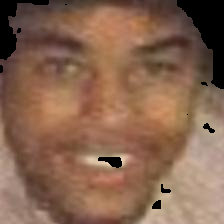

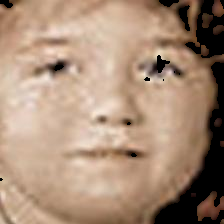

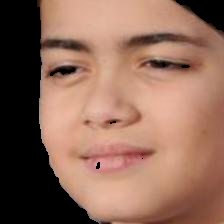

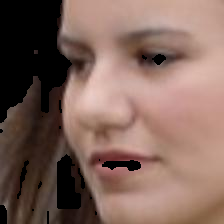

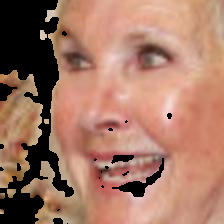

In [42]:
segmented_faces = []

for image in images:
  elem = cv.getStructuringElement(cv.MORPH_RECT, (3, 3))
  hsv_image = cv.cvtColor(image, cv.COLOR_BGR2HSV)
  hsv_mask = cv.inRange(hsv_image, (0, 15, 0), (17, 170, 255))
  hsv_mask = cv.morphologyEx(hsv_mask, cv.MORPH_OPEN, elem)
  ycbcr_image = cv.cvtColor(image, cv.COLOR_BGR2YCrCb)
  ycbcr_mask = cv.inRange(ycbcr_image, (0, 135, 85), (255, 180, 135))
  ycbcr_mask = cv.morphologyEx(ycbcr_mask, cv.MORPH_OPEN, elem)
  mask = cv.bitwise_and(ycbcr_mask, hsv_mask)
  mask = cv.medianBlur(mask, 3)
  elem_2 = cv.getStructuringElement(cv.MORPH_RECT, (4, 4))
  mask = cv.morphologyEx(mask, cv.MORPH_OPEN, elem_2)
  segmented_faces.append(image[mask != 0])
  show_image(cv.bitwise_and(image, np.dstack([mask, mask, mask])))

Una volta segmentati i pixel del volto, è stato determinato il colore della pelle. L'idea è stata quella per la quale i diversi colori possano essere messi su di una scala dove il parametro che varia è la luminosità degli stessi, mentre il contenuto cromatico rimane essenzialmente invariato. Di fatto, il colore della pelle è dato dalla maggiore o minore presenza di un pigmento all'interno della stessa, che determina il suo essere più scura o più chiara, senza modificare le altre proprietà del colore, perciò variando luminosità mantenendo tinta e saturazione invariate. Questa ipotesi è supportata dal fatto che il metodo precedente di segmentazione del volto impone vincoli sulle componenti di "hue" e "saturation" nello spazio HSV e sulle componenti "Cb" e "Cr" nello spazio "YCbCr", ma lascia libero di variare "value" e "Y", che rappresentano non a caso la luminosità dell'immagine.

Per implementare questa idea, sono stati utilizzati dei campioni di colore pensati appositamente per rappresentare i diversi toni del viso. Questi campioni provengono dalla palette di colori "[Monk skin tone scale](https://blog.google/products/search/monk-skin-tone-scale/)" sviluppata da Google per migliorare la rappresentazione delle diverse etnie nei suoi prodotti, pertanto ci si aspetta che sia capace di coprire con sufficiente accuratezza l'intero spettro dei colori facciali. I colori sono stati direttamente rappresentati nello spazio colore CIE La\*b\* per facilitare le operazioni successive.

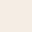

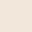

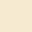

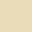

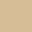

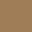

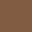

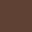

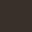

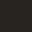

In [43]:
skin_tones = [
  (94.211, 1.503, 5.422),
  (92.275, 2.061, 7.28),
  (93.091, 0.216, 14.205),
  (87.573, 0.459, 17.748),
  (77.902, 3.471, 23.136),
  (55.142, 7.783, 26.74),
  (42.47, 12.325, 20.53),
  (30.678, 11.667, 13.335),
  (21.069, 2.69, 5.964),
  (14.61, 1.482, 3.525)
]
color_images = []
for skin_tone in skin_tones:
  color_image = np.full((32, 32, 3), list(skin_tone), dtype=np.float32)
  color_image = (cv.cvtColor(color_image, cv.COLOR_Lab2BGR) * 255).astype(np.uint8)
  color_images.append(color_image)
  show_image(color_image)
  print()

Fissata la palette di riferimento, non è stato fatto altro che utilizzare i pixel del volto estratti al passo precedente per convertirli in virgola mobile, così da poter applicare la trasformazione nello spazio colore La\*b\*. Per ogni tonalità nella palette, si è costruito un *array* con stessa dimensione del numero di pixel estratti di ciascun volto, in modo tale da poter applicare la formula cosiddetta $\Delta E^\ast$ per la differenza tra colori.

Questa formula si applica infatti nello spazio La\*b\* perché è pensato per meglio rappresentare la vicinanza dei colori da un punto di vista percettivo umano e perciò alcune metriche come appunto la distanza hanno maggiore significato. Inoltre, la formula è stata pensata e studiata per evidenziare le differenze anche impercettibili tra diverse tinte di uno stesso prodotto a livello industriale, perciò vuole essere particolarmente robusta. La variante impiegata è la CIE 2000, ovvero la più raffinata della famiglia di formule $\Delta E^\ast$.

Una volta determinata la distanza tra il colore di ciascun pixel e il colore della palette attualmente in esame, si prende la media tra queste. Minimi e massimi non sono affidabili, perché potrebbero essere influenzati da pixel spuri, come anche macchie della pelle o riflessi. Il valore medio aiuta a ridurre il peso di questi *outlier*, rimanendo comunque spostato verso il valore della maggioranza dei pixel. Il descrittore è poi costruito dalla concatenazione delle diverse medie.

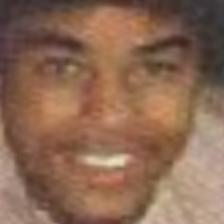

[38.257385, 36.863598, 37.6739, 34.655308, 28.297333, 13.870974, 11.453651, 17.820473, 25.957386, 30.456787]


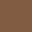

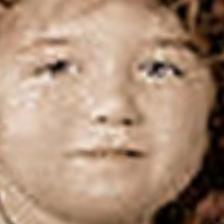

[23.31005, 21.675644, 22.496014, 19.689175, 14.437975, 15.246352, 23.804853, 35.148552, 43.902557, 48.444035]


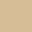

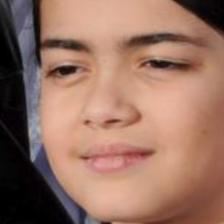

[28.5189, 27.005373, 28.340542, 25.601112, 19.537313, 15.228737, 20.406605, 30.90839, 40.206985, 44.439827]


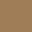

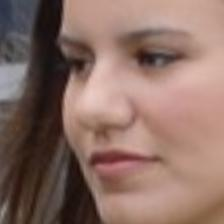

[36.139156, 34.8614, 36.705204, 34.16783, 28.063175, 18.742294, 19.737053, 25.458471, 31.458565, 35.231815]


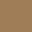

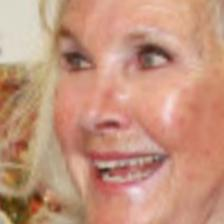

[26.438242, 24.936596, 26.31676, 23.665718, 17.86531, 14.982573, 22.155064, 33.532856, 42.772087, 47.067722]


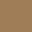

In [44]:
for (original, image) in zip(images, segmented_faces):
  means = []
  image_lab = cv.cvtColor(np.expand_dims(image, axis=0).astype(np.float32) / 255, cv.COLOR_BGR2Lab)
  for skin_tone in skin_tones:
    color_lab = np.full_like(image_lab, list(skin_tone), dtype=np.float32)
    mean_diff = deltaE_ciede2000(image_lab, color_lab).mean()
    means.append(mean_diff)
  show_image(original)
  print(means)
  show_image(color_images[np.argmin(means)])

Detto questo, è stato possibile costruire il metodo di estrazione della tonalità del viso. Poiché talvolta non viene individuato nemmeno un pixel come appartenente al viso, in questi casi estremi vengono utilizzati tutti i pixel dell'immagine, che sono sempre e comunque in maggioranza i pixel del volto.

In [45]:
def extract_skin_tone(image):
  skin_tones = [
    (94.211, 1.503, 5.422),
    (92.275, 2.061, 7.28),
    (93.091, 0.216, 14.205),
    (87.573, 0.459, 17.748),
    (77.902, 3.471, 23.136),
    (55.142, 7.783, 26.74),
    (42.47, 12.325, 20.53),
    (30.678, 11.667, 13.335),
    (21.069, 2.69, 5.964),
    (14.61, 1.482, 3.525)
  ]
  elem = cv.getStructuringElement(cv.MORPH_RECT, (3, 3))
  hsv_image = cv.cvtColor(image, cv.COLOR_BGR2HSV)
  hsv_mask = cv.inRange(hsv_image, (0, 15, 0), (17, 170, 255))
  hsv_mask = cv.morphologyEx(hsv_mask, cv.MORPH_OPEN, elem)
  ycbcr_image = cv.cvtColor(image, cv.COLOR_BGR2YCrCb)
  ycbcr_mask = cv.inRange(ycbcr_image, (0, 135, 85), (255, 180, 135))
  ycbcr_mask = cv.morphologyEx(ycbcr_mask, cv.MORPH_OPEN, elem)
  mask = cv.bitwise_and(ycbcr_mask, hsv_mask)
  mask = cv.medianBlur(mask, 3)
  elem_2 = cv.getStructuringElement(cv.MORPH_RECT, (4, 4))
  mask = cv.morphologyEx(mask, cv.MORPH_OPEN, elem_2)
  pixels = image[mask != 0]
  if pixels.shape[0] == 0:
    pixels = image.reshape((image.shape[0] * image.shape[1], 3))
  means = []
  image_lab = cv.cvtColor(np.expand_dims(pixels, axis=0).astype(np.float32) / 255, cv.COLOR_BGR2Lab)
  for skin_tone in skin_tones:
    color_lab = np.full_like(image_lab, list(skin_tone), dtype=np.float32)
    mean_diff = deltaE_ciede2000(image_lab, color_lab).mean()
    means.append(mean_diff)
  return np.array(means)

### Colore degli occhi

Per quanto riguarda il colore degli occhi, di norma ha una tonalità ben diversa da quelli circostanti, rendendolo un descrittore relativamente facile da estrarre. In questo caso però non possiamo assumere che il loro colore sia dato dalla maggiore o minore presenza di un pigmento al loro interno perché, oltre a non essere vero, quelle che sono considerate le principali varianti, ovvero "marroni", "verdi" e "azzurri", hanno tonalità molto diverse tra di loro. Inoltre, il colore di un occhio ha molte sfumature date dalla sua conformazione interna, anche se in questo caso non possono certo essere apprezzabili.

Per prima cosa, è stato necessario andare ad inviduare la posizione degli occhi, che in tutte le immagini si trova sempre all'incirca nella stessa posizione. Questi si trovano all'incirca ad un'altezza che è i 7/24 dell'immagine. L'occhio sinistro si trova ai 7/24 della larghezza dell'immagine, mentre quello destro ai 2/3.

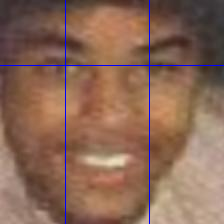

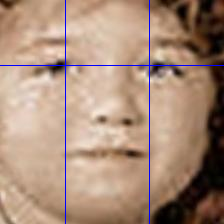

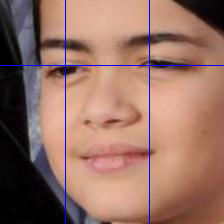

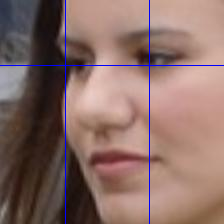

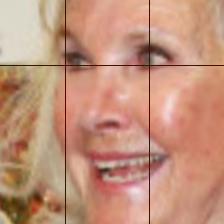

In [46]:
for image in images:
  image_lines = image.copy()
  lines = [
      (  # eye line
          (0, image_lines.shape[0] * 7 // 24),
          (image_lines.shape[1], image_lines.shape[0] * 7 // 24)
      ),
      (  # left eye
          (image_lines.shape[1] * 7 // 24, 0),
          (image_lines.shape[1] * 7 // 24, image_lines.shape[0])
      ),
      (  # right eye
          (image_lines.shape[1] * 2 // 3, 0),
          (image_lines.shape[1] * 2 // 3, image_lines.shape[0])
      ),
  ]
  for line in lines:
      cv.line(
          image_lines,
          line[0],
          line[1],
          (255, 0, 0),
          1
      )
  show_image(image_lines)

Dopodiché, si è andati a determinare un ellisse attorno al presunto centro dell'occhio, fatto in modo tale da far ricadere al suo interno tutti i pixel dell'occhio. Questa ellisse ha un rapporto tra gli assi di 2:1, in quanto l'occhio umano è più largo che lungo.

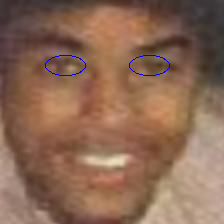

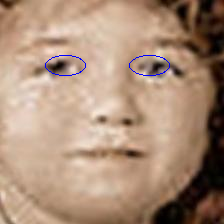

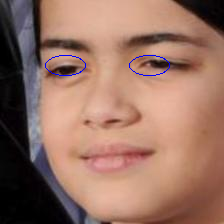

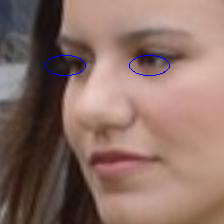

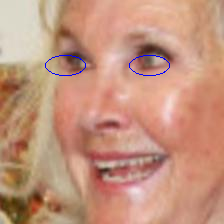

In [47]:
for image in images:
  image_ellipse = image.copy()
  cv.ellipse(
      image_ellipse,
      (image_lines.shape[1] * 7 // 24, image_lines.shape[0] * 7 // 24),
      (20, 10),
      0,
      0,
      360,
      (255, 0, 0),
      1
  )
  cv.ellipse(
      image_ellipse,
      (image_lines.shape[1] * 2 // 3, image_lines.shape[0] * 7 // 24),
      (20, 10),
      0,
      0,
      360,
      (255, 0, 0),
      1
  )
  show_image(image_ellipse)

Questo ellisse è stato poi utilizzato per determinare una maschera da applicare sull'immagine in *grayscale* per estrapolare i pixel degli occhi. Sull'immagine con applicata la maschera sono stati poi posti tutti i pixel esterni ad essa ad una luminosità pari a 255 e poi è stato applicato thresholding globale binario inverso, che perciò pone a 255 tutti i pixel al di sotto di una certa soglia. La soglia, scelta manualmente, è pari a 120. Questo ha prodotto una maschera pensata per estrarre solamente i pixel dell'iride ed eliminare tutti quelli associati alla sclera, ovvero la parte bianca dell'occhio, più chiara.

Riutilizzare la tecnica precedente, ovvero quella di segmentazione dei pixel del viso non avrebbe dato risultati soddisfacenti. Purtroppo i pixel che compongono l'occhio sono molto pochi ed eliminarne qualcuno di troppo avrebbe potuto compromettere effettivamente il funzionamento del descrittore. Dato che la tecnica di segmentazione trattiene molto spesso pixel che non fanno parte del viso vero e proprio, quindi anche degli occhi, creare una maschera "al contrario" avrebbe significato quasi sicuramente perdere pixel che invece dell'occhio fanno parte. Visto che comunque utilizzando la tecnica descritta si restringe molto il campo dei potenziali pixel dell'occhio, ci si è limitati al tentativo di eliminare la sclera.

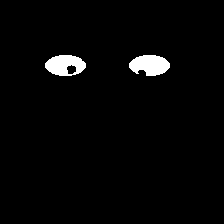

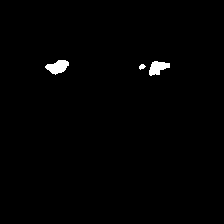

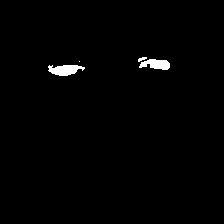

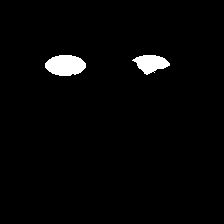

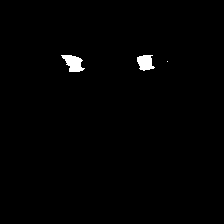

In [48]:
thresholds = []

for image in images:
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  eye_mask = np.zeros((image_gray.shape[0], image_gray.shape[1]), dtype=np.uint8)
  cv.ellipse(
    eye_mask,
    (eye_mask.shape[1] * 7 // 24, eye_mask.shape[0] * 7 // 24),
    (20, 10),
    0,
    0,
    360,
    255,
    -1
  )
  cv.ellipse(
    eye_mask,
    (image_lines.shape[1] * 2 // 3, image_lines.shape[0] * 7 // 24),
    (20, 10),
    0,
    0,
    360,
    255,
    -1
  )
  image_masked = cv.bitwise_and(image_gray, eye_mask)
  image_masked = image_masked + cv.bitwise_not(eye_mask)
  _, threshold = cv.threshold(image_masked, 120, 255, cv.THRESH_BINARY_INV)
  thresholds.append(threshold)
  show_image(threshold)

La maschera è stata poi applicata all'immagine per estrarre il *color histogram* dell'iride, che è stato calcolato come l'istogramma sul canale "hue" dell'immagine nello spazio colore "HSV".

Un istogramma calcolato solamente sul canale "hue" è sufficiente perché, in primo luogo, questo ci rende indipendenti dalla luminosità dell'immagine, che certamente influenza il colore dell'occhio. In secondo luogo, a noi interessa prevalentemente sapere la tonalità, quindi se l'occhio è più marrone, più verde o più azzurro. Per ottenere queste informazioni basta osservare come sono collocati i valori nell'istogramma: se sono presenti solamente tra il rosa e l'arancione, allora l'occhio è prevalentemente marrone, se sono presenti valori tra i verdi allora l'occhio è più verde, mentre se sono presenti valori tra i blu, allora l'occhio è azzurro. Poiché a causa del colore della pelle circostante i toni del rosso e dell'arancione rimangono sempre molto alti a prescindere dal colore dell'occhio, avrebbero potuto essere eliminati dall'istogramma. Si è però preferito lasciarli e fare in modo che sia il successivo classificatore a determinare la loro utilità o meno.

L'istogramma colore così calcolato è stato poi normalizzato: ci interessa il rapporto relativo tra le diverse tonalità e non il valore assoluto delle stesse, che dipende dal numero di pixel sui quali è stato calcolato l'istogramma e il cui valore può portare fuori strada un potenziale classificatore a causa del loro ordine di grandezza.

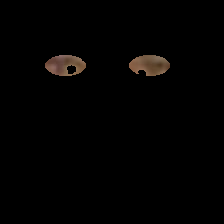

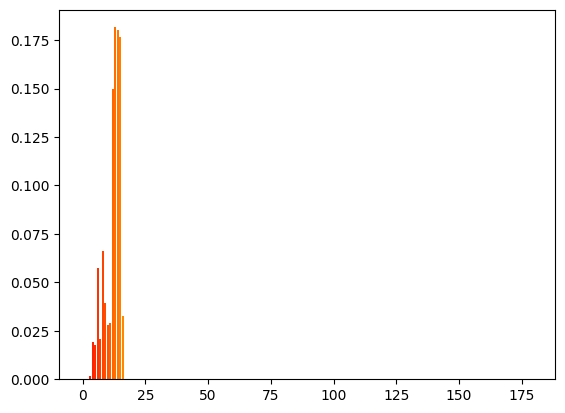

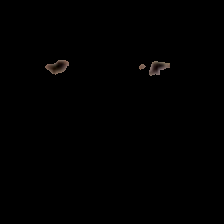

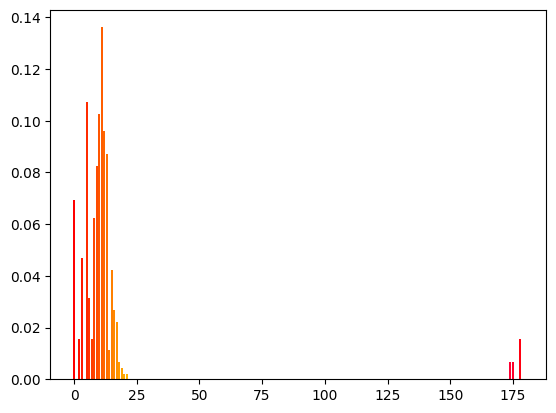

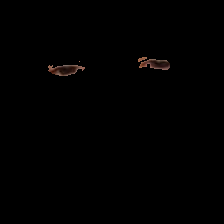

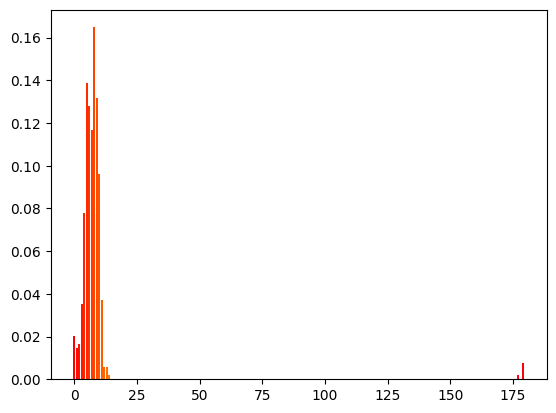

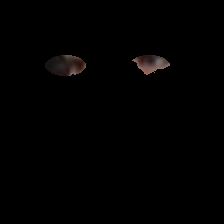

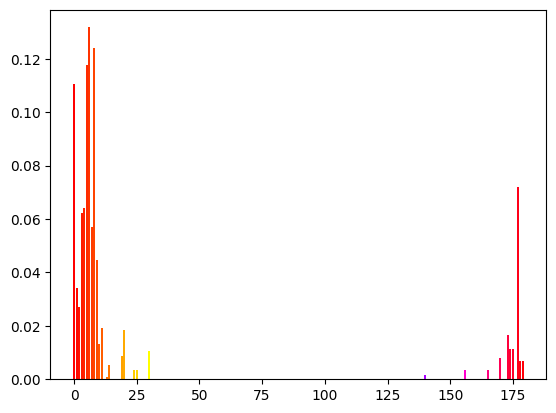

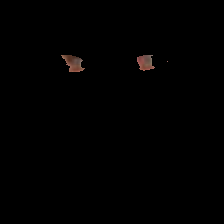

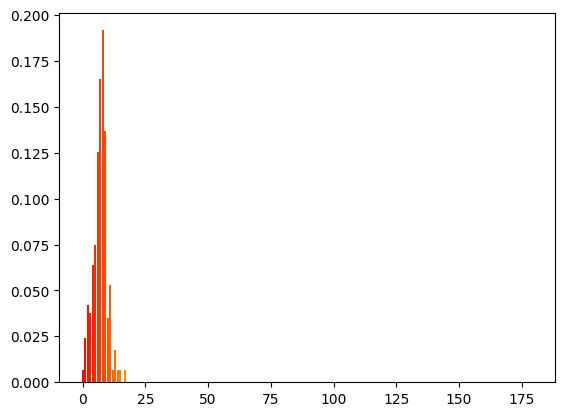

In [49]:
for (image, mask) in zip(images, thresholds):
  image_hue = cv.split(cv.cvtColor(image, cv.COLOR_BGR2HSV))[0]
  hue_hist = np.squeeze(cv.calcHist([image_hue], [0], mask, [180], [0, 180]), axis=1)
  norm_hue_hist = hue_hist / np.sum(hue_hist)
  show_image(cv.bitwise_and(image, np.stack([mask, mask, mask], axis=2)))
  barchart = plt.bar(
    list(range(0, 180)),
    norm_hue_hist,
    color=(np.squeeze(cv.cvtColor(
      np.array([[[x, 255, 255]] for x in range(0, 180)], dtype=np.uint8),
      cv.COLOR_HSV2RGB
    ), axis=1) / 255).tolist()
  )
  plt.show()

In questo modo, si è determinato il processo di estrazione del colore degli occhi da un'immagine, esemplificato dalla funzione seguente. Nel caso in cui non sia stato individuato neanche un pixel come appartenente agli occhi e perciò la somma dei valori nell'istogramma sia zero, viene restituito un valore speciale. Questo servirà per eliminare l'immagine successivamente.

In [50]:
def extract_eyes_hue(image):
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  eye_mask = np.zeros((image_gray.shape[0], image_gray.shape[1]), dtype=np.uint8)
  cv.ellipse(
    eye_mask,
    (eye_mask.shape[1] * 7 // 24, eye_mask.shape[0] * 7 // 24),
    (20, 10),
    0,
    0,
    360,
    255,
    -1
  )
  cv.ellipse(
    eye_mask,
    (image_lines.shape[1] * 2 // 3, image_lines.shape[0] * 7 // 24),
    (20, 10),
    0,
    0,
    360,
    255,
    -1
  )
  image_masked = cv.bitwise_and(image_gray, eye_mask)
  image_masked = image_masked + cv.bitwise_not(eye_mask)
  _, threshold = cv.threshold(image_masked, 120, 255, cv.THRESH_BINARY_INV)
  image_hue = cv.split(cv.cvtColor(image, cv.COLOR_BGR2HSV))[0]
  hue_hist = np.squeeze(cv.calcHist([image_hue], [0], threshold, [180], [0, 180]), axis=1)
  if np.sum(hue_hist) == 0:
    return None
  else:
    return hue_hist / np.sum(hue_hist)

### Texture del volto

Come ultimo gruppo di feature, sono state estratte quelle inerenti alla texture del volto. Queste informazioni potrebbero essere utili per catturare informazioni ancora non individuate come lentiggini, nei, rughe o altre imperfezioni del viso che possono essere trasmesse geneticamente tra parenti.

I due metodi che permettono un'estrazione "handcrafted" delle feature che risultano allo stesso tempo più veloci e capaci di codificare meglio le informazioni sono i filtri di Gabor e i "Local Binary Pattern". Tra queste due tecniche si è preferito utilizzare la seconda, nella sua variante multiscala come illustrata nel *paper* "[Multiresolution gray-scale and rotation invariant texture classification with local binary patterns](https://doi.org/10.1109/TPAMI.2002.1017623)" di Ojala, Pietikainen e Maenpaa. La sua potenza risiede nel fatto che, se si considerano solamente i *pattern* cosiddetti "uniformi e invarianti per rotazione", i quali di norma compongono fino al 90% dei pattern in un'immagine, ne esistono solamente un numero fortemente limitato. Se si indica con $P$ il numero di pixel nell'intorno considerato, allora i pattern uniformi invarianti per rotazione sono solamente $P+2$, anziché i $2^p$ totali. Questo torna utile nella tecnica che li utilizza, che consiste nel suddividere l'immagine in sottoimmagini e per ciascuna estrarre l'istogramma dei L.P.B., che conterà solamente $P+3$ *bin*, uno in più per quelli non uniformi. Quando il descrittore sarà costruito, concatenando i diversi istogrammi, la rappresentazione sarà estremamente compatta ma contenente ancora molte informazioni sulla *texture* del volto.

Per mediare tra il numero delle feature estratte e le informazioni trattenute, si è deciso di suddividere l'immagine in 16 immagini 56x56, sufficientemente piccole. Su ognuna di esse vengono calcolati gli istogrammi di L.B.P. con raggio 1, e intorno dei pixel 8, e con raggio 2, e intorno dei pixel 16, come fossero due cornici rispettivamente 3x3 e 5x5. Ciascun istogramma è stato poi normalizzato.

I filtri di Gabor non sono stati considerati adeguati perché, per ottenere dei risultati simili, avrebbero dovuto quantomeno essere generati in un banco da 2 risoluzioni per 8 direzioni, quelle tipiche della distanza Chebyshev, per un totale di 16 filtri, senza contare gli altri parametri che si possono introdurre per modificare i filtri. Dopodiché, ciascuno di essi avrebbe dovuto essere applicato su di una "saliency image" che, anche nel caso possedesse un numero basso come un centinaio di posizioni, avrebbe voluto dire 1600 *feature*, contro le 448 che estraggono così i Local Binary Pattern.

In [51]:
for image in images:
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  patterns = np.empty((0,), dtype=np.uint16)
  for neighboorhood in [(8, 1), (16, 2)]:
    for i in range(0, 4):
      for j in range(0, 4):
        pattern = local_binary_pattern(
          image_gray[(i * 56):((i + 1) * 56),(j * 56): ((j + 1) * 56)],
          neighboorhood[0],
          neighboorhood[1],
          "uniform"
        )
        hist, _ = np.histogram(pattern, neighboorhood[0] + 2, range=[0, neighboorhood[0] + 3])
        patterns = np.concatenate([patterns, hist / np.sum(hist)])
  print(patterns.shape)

(448,)
(448,)
(448,)
(448,)
(448,)


L'estrazione delle feature facciali è perciò facilmente codificata come segue.

In [52]:
def extract_face_texture(image):
  image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  patterns = np.empty((0,), dtype=np.uint16)
  for neighboorhood in [(8, 1), (16, 2)]:
    for i in range(0, 4):
      for j in range(0, 4):
        pattern = local_binary_pattern(
          image_gray[(i * 56):((i + 1) * 56),(j * 56): ((j + 1) * 56)],
          neighboorhood[0],
          neighboorhood[1],
          "uniform"
        )
        hist, _ = np.histogram(pattern, neighboorhood[0] + 2, range=[0, neighboorhood[0] + 3])
        patterns = np.concatenate([patterns, hist / np.sum(hist)])
  return patterns

## Classificazione tradizionale

### Preparazione del dataset

Una volta determinate le *feature* da estrarre, non si è fatto altro che effettuare la loro elaborazione per ogni immagine a colori corretta, indipendentemente dal fatto che quest'ultima appartenesse al *training set* o al *test set*. Come già osservato in precedenza, nel caso in cui da un'immagine non fosse possibile estrarre una o più *feature*, questa viene interamente scartata. Per questo motivo, è necessario salvare assieme ai *feature vector* i percorsi che fanno riferimento all'immagine da cui sono stati estratti.

Le operazioni di estrazione necessitano di un po' di tempo per essere portate a termine, a causa dei descrittori di Fourier ellittici, dei Local Binary Pattern e del calcolo della funzione $\Delta E^\ast$, ognuno dei quali richiede un tempo non irrilevante per essere calcolato. Alla fine delle diverse trasformazioni, perciò, le *feature* saranno salvate in file pensati per realizzare la loro *cache*. Per questo motivo se i file sono presenti i *dataset* vengono caricati, mentre se non esistono i *dataset* vengono semplicemente calcolati.

Poiché le operazioni successive necessiteranno di parametri che dipendono dai *dataset* in fase di trasformazione, anche i parametri sono stati salvati in file appositi. In questo modo, è possibile riutilizzarli sul *test set* e valutare l'accuratezza del sistema realizzato sulle immagini estratte dalle puntate della trasmissione.

In [53]:
def extract_all_features(images, cache_filename):
  if not os.path.exists(cache_filename + ".bin"):
    paths = []
    features = []
    for i, (image_path, image) in enumerate(images.items()):
      if i % 500 == 0:
        print("{:.2%}".format(i / len(images)))
      features_list = [
        extract_skin_tone(image),
        extract_eyes_hue(image),
        extract_nose_shape(image),
        extract_mouth_shape(image),
        extract_eye_eyebrow_shape(image),
        extract_face_texture(image),
      ]
      if all(type(e) is np.ndarray for e in features_list):
        paths.append(image_path)
        features.append(np.concatenate(features_list))
    return np.vstack(paths), np.vstack(features)
  else:
    return load_binary(cache_filename + "-paths.bin"), load_binary(cache_filename + ".bin")

train_paths, train_features = extract_all_features(images_train, "handcrafted/train-features")
test_paths, test_features = extract_all_features(images_test, "handcrafted/test-features")

Una volta estratte le *feature*, è stato necessario normalizzarle. I descrittori che sono realizzati come istogrammi non possono però esserlo, in quanto ciascuna componente ha un significato che è legato a quello delle altre. Riscalare i valori presi singolarmente altererebbe i rapporti tra questi, facendo perdere parte del significato che portano con sé. Tanto più che la normalizzazione degli istogrammi viene già fatta, semplicemente dividendo il valore di ciascun "bin" per la somma dei valori, dando origine ad una funzione di distribuzione di probabilità discreta.

Discorso analogo vale per i descrittori di Fourier ellittici: sono coefficienti che codificano informazioni sullo "spettro delle frequenze" di una forma in termini di ellissi la cui somma restituisce la silhouette originale. Non sono perciò importanti solamente i rapporti tra questi, ma anche il loro valore assoluto, che indica con che ampiezza una data frequenza è presente nel segnale di partenza. Si ricorda inoltre che la loro estrazione già prevede una fase di normalizzazione degli stessi.

I descrittori che non ricadono in queste categorie sono invece i centroidi, che sono stati resi indipendenti dalle dimensioni dell'immagine da cui sono stati estratti, ma non sono normalizzati. Analogamente non sono normalizzati l'elongazione e la convessità, così come i descrittori del tono della pelle del volto, che sono distanze, quindi possono variare tra $0$ e $+\infty$.

Per questo motivo, tutti questi descrittori sono stati normalizzati mediante "standard scaling", ovvero tramite la sottrazione della media dei valori e divisione per la deviazione standard. In questo modo, la distribuzione dei valori di ciascun descrittore, se può essere espressa mediante una funzione gaussiana, è una gaussiana di media 0 e varianza 1.

In [54]:
skin_tone_indexes = np.arange(10)
nose_indexes = 190 + np.arange(4)
mouth_indexes = nose_indexes + 65
left_eye_indexes = mouth_indexes + 65
left_eyebrow_indexes = left_eye_indexes + 65
right_eye_indexes = left_eyebrow_indexes + 65
right_eyebrow_indexes = right_eye_indexes + 65
scaler_indexes = np.concatenate([
  skin_tone_indexes,
  nose_indexes,
  mouth_indexes,
  left_eye_indexes,
  left_eyebrow_indexes,
  right_eye_indexes,
  right_eyebrow_indexes
])

def normalize_features(train_features, test_features, cache_filename):
  if not os.path.exists(cache_filename + ".bin"):
    scaler = StandardScaler()
    train_features[:, scaler_indexes] = scaler.fit_transform(train_features[:, scaler_indexes])
    test_features[:, scaler_indexes] = scaler.transform(test_features[:, scaler_indexes])
    print(scaler.mean_.shape)
    os.makedirs(os.path.dirname(cache_filename), exist_ok=True)
    dump_binary(scaler, cache_filename)
    return train_features, test_features, scaler
  else:
    scaler = load_binary(cache_filename)
    return train_features, test_features, scaler

train_features, test_features, scaler = normalize_features(train_features, test_features, "handcrafted/scaler.bin")

(34,)


Come già detto, l'ultima operazione è quella di salvataggio dei descrittori nei file di cache, se questi non sono già stati creati in precedenza.

In [55]:
def save_cache(paths, features, cache_filename):
  if not os.path.exists(cache_filename + ".bin"):
    os.makedirs(os.path.dirname(cache_filename), exist_ok=True)
    dump_binary(paths, cache_filename + "-paths.bin")
    dump_binary(features, cache_filename + ".bin")

save_cache(train_paths, train_features, "handcrafted/train-features")
save_cache(test_paths, test_features, "handcrafted/test-features")

### Addestramento del classificatore per il primo problema

Una volta fatto questo, si tratta di sostituire le *feature* delle immagini ai percorsi delle stesse nel *dataset* di training delle coppie del primo problema. Viene quindi costruito un nuovo *dataset* che ha tante righe quante sono le istanze dalle quali è stato possibile estrarre tutte le *feature* e un numero di colonne pari al doppio delle *feature* per ciascuna immagine. Questo perché le *feature* estratte da ciascuna delle due immagini della coppia vengono affiancate in questo nuovo *dataset*. Nel *dataset* originale si trattengono solamente le coppie di immagini per cui le *feature* sono state estratte da entrambe, così da avere le etichette delle classi.

In [56]:
train_binary = train_binary[(train_binary["p1"].isin(train_paths.flatten())) & (train_binary["p2"].isin(train_paths.flatten()))]

features_train_binary = np.empty((train_binary.shape[0], train_features.shape[1] * 2), dtype=np.float32)
features_train_binary[:, :train_features.shape[1]] = \
  np.array([train_features[np.argwhere(train_paths == path)[0][0]] for path in train_binary["p1"]])
features_train_binary[:, train_features.shape[1]:] = \
  np.array([train_features[np.argwhere(train_paths == path)[0][0]] for path in train_binary["p2"]])

train_y = train_binary['label']

features_train_binary.shape

(86033, 2056)

La stessa cosa viene fatta anche per il *dataset* di *test* delle coppie per il primo problema.

In [57]:
test_binary = test_binary[(test_binary["p1"].isin(test_paths.flatten())) & (test_binary["p2"].isin(test_paths.flatten()))]

features_test_binary = np.empty((test_binary.shape[0], test_features.shape[1] * 2), dtype=np.float32)
features_test_binary[:, :test_features.shape[1]] = \
  np.array([test_features[np.argwhere(test_paths == path)[0][0]] for path in test_binary["p1"]])
features_test_binary[:, test_features.shape[1]:] = \
  np.array([test_features[np.argwhere(test_paths == path)[0][0]] for path in test_binary["p2"]])

test_y = test_binary['label']

features_test_binary.shape

(12294, 2056)

Le operazioni di estrazione variano leggermente le percentuali sul totale delle due classi, sia per il *training set* che per il *test set*. Ciò ci permette di non effettuare ulteriori operazioni di aggiustamento delle istanze, ma verranno considerati i diversi pesi di ciascuna classe durante l'addestramento.

In [58]:
train_binary["label"].value_counts()

0    44396
1    41637
Name: label, dtype: int64

In [59]:
test_binary["label"].value_counts()

1    6255
0    6039
Name: label, dtype: int64

Vengono calcolati i pesi delle classi positiva e negativa sul *training set*.

In [60]:
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(train_y), y=train_y)
weights = np.ones_like(train_y, np.float32)
for class_val, weight in zip(np.unique(train_y), class_weights):
  weights[train_y == class_val] = weight
class_weights

array([0.96892738, 1.03313159])

Le funzioni che possono essere utilizzate per combinare le *feature* delle coppie di immagini sono:

* somma: $x + y$
* prodotto: $x \cdot y$
* differenza: $x-y$
* somma al quadrato: $(x+y)^2$
* differenza al quadrato: $(x-y)^2$
* somma dei quadrati: $x^2 + y^2$
* differenza dei quadrati: $x^2 - y^2$

Queste funzioni vogliono essere delle versioni semplificate di metriche di distanza o di similarità. In generale, somme o prodotti "_element-wise_" restituiscono valori tanto più elevati quanto più gli operandi sono vicini tra loro, le differenze valori tanto più grandi quanto più gli operandi sono diversi tra loro. Si è voluto evitare l'utilizzo dell'operazione di divisione, che non è definita nel caso di divisione per 0, così come la moltiplicazione o la somma di costanti, che avrebbe solamente modificato lo *scaling* delle *features*. L'uso di queste funzioni è stato ispirato dal vincitore della competizione, che utilizzava alcune di esse per combinare le *feature* estratte dalle diverse reti neurali. Infatti, questo ha permesso lui di ottenere modelli sufficientemente indipendenti tra di loro, per poterli utilizzare come "*ensemble*".



In [61]:
def sum_vectors(X):
  return X[:, :(X.shape[1] // 2)] + X[:, (X.shape[1] // 2):]

def prod(X):
  return X[:, :(X.shape[1] // 2)] * X[:, (X.shape[1] // 2):]

def diff(X):
  return X[:, :(X.shape[1] // 2)] - X[:, (X.shape[1] // 2):]

def squared_sum(X):
  return (X[:, :(X.shape[1] // 2)] + X[:, (X.shape[1] // 2):]) ** 2

def squared_diff(X):
  return (X[:, :(X.shape[1] // 2)] - X[:, (X.shape[1] // 2):]) ** 2

def sum_squares(X):
  return X[:, :(X.shape[1] // 2)] ** 2 + X[:, (X.shape[1] // 2):] ** 2

def diff_squares(X):
  return X[:, :(X.shape[1] // 2)] ** 2 - X[:, (X.shape[1] // 2):] ** 2

functions = {
  'sum_vectors': sum_vectors,
  'prod': prod,
  'diff': diff,
  'squared_sum': squared_sum,
  'squared_diff': squared_diff,
  'sum_squares': sum_squares,
  'diff_squares': diff_squares
}

Una volta definiti i *dataset* da utilizzare e le funzioni, è stato effettuato l'addestramento vero e proprio per ottenere i migliori modelli. La famiglia di classificatori utilizzati è "XGBoost", in quanto capace di poter addestrare concorrentemente i *decision tree* che fanno parte degli "*ensemble*" che costruiscono sulla GPU. Questo rende possibile effettuare efficientemente il loro addestramento su *cluster* dotati di molte risorse di GPU.

È necessario specificare la funzione obiettivo, che altro non è che una regressione logistica che permette di effettuare classificazione. Il problema è a due sole classi, perciò è una "logistic regression" binaria. La metrica scelta per valutare l'errore del modello sul *validation set* è il più semplice tasso di errore, ovvero $\frac{FP + FN}{P + N}$.

In [62]:
base_XGBoost = XGBClassifier(
  objective='binary:logistic',
  num_class=len(np.unique(train_y)),
  eval_metric='error',
  tree_method='gpu_hist',
  seed=1234
)

È stata effettuata una "*grid search*" per ottenere i migliori iperparametri in corrispondenza dell'applicazione di ciascuna delle funzioni per l'aggregazione delle *feature* corrispondenti. I valori che sono stati lasciati qui indicati sono stati quelli che si sono rivelati migliori dopo diversi tentativi su differenti intervalli. Nella *grid search* gli iperparametri che si sono rivelati più significativi sono stati:

* "min_child_weight": il peso minimo che deve essere associato ad una foglia di un albero costruito, valori più grandi portano ad una terminazione maggiormente precoce del processo di costruzione-suddivisione di ogni singolo albero;
* "gamma": minima riduzione della funzione di *loss* definita perché un'ulteriore suddivisione di una foglia possa essere considerata;
* "subsample": percentuale del *training set* da campionare per la costruzione degli alberi, fatto per ridurre il potenziale *overfitting*;
* "colsample_bytree": la percentuale di colonne del *training set* da campionare durante la costruzione degli alberi, per ogni nuovo albero costruito;
* "max_depth": la profondità massima di un singolo albero, regola la complessità dello stesso e con essa la possibilità di *overfitting*;
* "learning_rate": parametro moltiplicativo che ha per scopo ridurre mano a mano il peso dei risultati degli alberi costruiti, in modo tale da evitare "salti" troppo grandi nella ricerca dei parametri ottimali del modello;
* "n_estimators": il numero massimo di alberi che verranno addestrati da XGBoost.

In [63]:
grid_params = {
  'min_child_weight': (1, 10),
  'gamma': (0.01, 9.0, 'log-uniform'),
  'subsample': (0.06, 1.0, 'uniform'),
  'colsample_bytree': (0.06, 1.0, 'uniform'),
  'max_depth': (1, 15),
  'learning_rate': (0.01, 1.0, 'log-uniform'),
  'n_estimators': (100, 1000),
}

grid_search_params = \
  {'classifier__' + grid_params_name: grid_params_value for grid_params_name, grid_params_value in grid_params.items()}

Il vero e proprio "*estimator*" addestrato durante la *grid search* è stato costruito mediante una "Pipeline" che applica in sequenza la funzione di aggregazione dei dati scelta e in seguito il modello da addestrare. Questo implica quindi che viene costruita una "Pipeline" per ognuna delle possibili funzioni.

La tecnica di *grid search* impiegata è la cosiddetta "Bayesian Optimization", ovvero una tecnica iterativa che si basa sulla formula di Bayes per trovare i massimi di una funzione sconosciuta a partire da un insieme di campionamenti limitato perché "costosi" da calcolare.
L'obiettivo è quello di individuare un insieme di valori, un insieme di input, su un dominio limitato da usare come "sonda". Occorre tenere conto sia di dove si ha maggiore incertezza sulla forma, sull'output, della funzione, sia di dove ci si aspetta che siano presenti i massimi della funzione, usando le informazioni già accumulate ed euristiche adeguate. Ecco quindi perché è coinvolto il teorema di Bayes, che infatti permette di calcolare la probabilità condizionata di un evento rispetto ad un secondo già accaduto, a priori, conoscendo la probabilità che quello già accaduto si verifichi.

Nel nostro caso, la funzione di cui si sta cercando di individuare il massimo è il modello che si sta addestrando che prende per input vettori nello spazio degli iperparametri e come output restituisce l'accuratezza sul *training set*, che deve essere massima. La tecnica non farà altro che campionare il modello in corrispondenza dei punti per lui sensati alla ricerca del massimo.

Si è osservato come l'uso di questa tecnica, in corrispondenza dei parametri scelti, abbia accelerato l'effettuazione della *grid search*. È stato infatti specificato di tentare 100 vettori nello spazio degli iperparametri, testandone 4 concorrentemente alla volta. La valutazione delle prestazioni degli iperparametri è stata effettuata considerando l'accuratezza come *score* e facendo "stratified k-fold cross validation". Questo significa che per ogni combinazione degli iperparametri il *training set* è stato suddiviso in tre parti: due sono state utilizzate per l'addestramento vero e proprio e una per la valutazione, cambiandole ogni volta in modo tale da poter ottenere alla fine tre *score* su cui trarre un giudizio. Il fatto che la *cross validation* fosse "stratified" ha permesso di mantenere la stessa proporzione tra le due classi in ciascuno dei *fold*, cioè delle partizioni.

In [64]:
def train_models(models_directory, lambdas, base_model, grid, train_X, train_y, fit_params={}, cv=3):
  best_models = []
  best_models_results = []

  for function_name, function in list(lambdas.items()):
    if not os.path.exists(f"{models_directory}/{function_name}.bin"):
      estimator = Pipeline([
        ("lambda", FunctionTransformer(function)),
        ("classifier", base_model)
      ])
      model = BayesSearchCV(
        estimator=estimator,
        search_spaces=grid,
        fit_params=fit_params,
        n_points=4,
        n_iter=100,
        cv=cv,
        scoring="accuracy",
        random_state=1234
      )
      model.fit(train_X, train_y)
      dump_binary(model.best_estimator_, f"{models_directory}/{function_name}.bin")
      pd.DataFrame(model.cv_results_) \
        .sort_values(by=["rank_test_score"]) \
        .to_csv(f"{models_directory}/{function_name}_results.csv", index=False)
      best_models.append(model.best_estimator_)
      best_models_results.append(model.cv_results_)
    else:
      best_models.append(load_binary(f"{models_directory}/{function_name}.bin"))
      best_models_results.append(pd.read_csv(f"{models_directory}/{function_name}_results.csv"))

  return best_models, best_models_results

La definizione di una funzione per effettuare l'addestramento di un modello per ogni funzione di aggregazione dei dati, e il conseguente salvataggio dei risultati dell'addestramento e del miglior modello ottenuto, è stato fatto per poter effettuare il suo *caching*. L'operazione di *training* è infatti molto lunga ed è sempre uguale, sia che si tratti del primo problema binario, che del secondo problema multiclasse. Analogamente a quanto fatto in precedenza, perciò, se i file di *cache* sono presenti vengono caricati, se non lo sono vengono generati e i risultati restituiti.

In [65]:
%%capture
fit_params = {
    'classifier__sample_weight': weights
}

best_models_binary, best_models_results_binary = \
  train_models("xgboost_binary", functions, base_XGBoost, grid_search_params, features_train_binary, train_y, fit_params=fit_params)

I risultati dell'addestramento dei modelli che fanno uso della funzione somma ci dicono che i migliori 5 modelli hanno uno *score* medio sugli *split* che non si discosta molto dal 64,5%. L'addestramento ha prediletto un *ensemble* molto numeroso, con un numero di alberi nell'ordine del migliaio, relativamente profondi, tutti con una profondità massima pari al valore più alto scelto. Il *learning rate* scelto è stato molto basso, segno che è stato preferito un approccio conservativo. L'addestramento ha preferito non scartare una percentuale di colonne e di istanze del *dataset* di *training* molto elevata in corrispondenza di ogni nuovo albero, segno che non è stato individuato particolare *overfitting*. Da ultimo, anche il valore del parametro "gamma" rimane particolarmente elevato tra i modelli migliori.

In [66]:
best_models_results_binary[0]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,137.789615,7.235560,2.597290,0.139393,0.802124,0.026820,0.010000,15,4,846,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.677630,0.608520,0.656291,0.647480,0.028894,1
1,72.271756,1.324025,1.336976,0.011234,1.000000,2.443495,0.018041,13,5,1000,0.866232,"OrderedDict([('classifier__colsample_bytree', ...",0.676748,0.607396,0.654246,0.646130,0.028888,2
2,35.776298,0.782405,1.461001,0.012426,0.233232,0.010000,0.010000,12,10,852,0.691285,"OrderedDict([('classifier__colsample_bytree', ...",0.674421,0.608800,0.654286,0.645836,0.027448,3
3,115.391793,6.015541,2.659916,0.072071,1.000000,0.010000,0.010000,15,10,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.678513,0.606554,0.652441,0.645836,0.029746,3
4,110.847577,3.961051,2.147401,0.039903,1.000000,0.010000,0.011388,15,6,758,0.784925,"OrderedDict([('classifier__colsample_bytree', ...",0.673860,0.607838,0.655008,0.645568,0.027768,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,7.415342,0.012115,0.125609,0.003691,0.609326,0.015648,0.839096,1,4,656,0.118880,"OrderedDict([('classifier__colsample_bytree', ...",0.597489,0.552806,0.572701,0.574332,0.018278,96
96,30.695449,1.181492,1.172601,0.039680,0.783669,3.535019,0.351317,10,2,935,0.153018,"OrderedDict([('classifier__colsample_bytree', ...",0.584413,0.548394,0.566122,0.566310,0.014705,97
97,6.592072,0.023598,0.125265,0.000920,1.000000,9.000000,1.000000,15,10,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.574024,0.529782,0.560066,0.554624,0.018467,98
98,7.054405,0.040018,0.157533,0.005333,0.834873,9.000000,0.628129,11,6,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.565842,0.535999,0.560587,0.554143,0.013007,99


I risultati dell'addestramento dei modelli che fanno uso della funzione prodotto ci dicono che i migliori 5 modelli hanno uno *score* medio sugli *split* che non si discosta molto dal 64,5%. I risultati sono simili a quelli precedenti, con le principali differenze legate al fatto che l'*ensemble* in questo caso è mediamente ancora più numeroso e con alberi più profondi. Il numero di colonne e di istanze del *dataset* considerate per ogni albero si mantiene alto, come è alto, ma solo in questo caso, il peso che ogni foglia dell'albero deve avere. Il parametro *gamma* mantiene dei valori relativamente ridotti come in precedenza, mentre il *learning rate* ci dice che l'addestramento mediamente è stato meno conservativo.

In [67]:
best_models_results_binary[1]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,56.412993,1.113497,1.544233,0.009777,0.665253,0.052783,0.023511,14,10,729,0.768908,"OrderedDict([('classifier__colsample_bytree', ...",0.670811,0.612129,0.657535,0.646825,0.025125,1
1,96.334300,2.545035,2.256876,0.020795,1.000000,0.010000,0.023677,15,10,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.669648,0.614857,0.655489,0.646665,0.023222,2
2,40.351218,0.626279,2.278589,0.031111,0.060000,0.010000,0.035623,15,10,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.663752,0.614536,0.660222,0.646170,0.022415,3
3,208.614336,7.289697,3.999483,0.070561,0.605776,0.010000,0.012676,15,1,1000,0.864286,"OrderedDict([('classifier__colsample_bytree', ...",0.666078,0.610004,0.661586,0.645889,0.025441,4
4,99.002043,2.369381,2.301122,0.024625,1.000000,0.010000,0.010000,15,10,1000,0.518437,"OrderedDict([('classifier__colsample_bytree', ...",0.664594,0.614817,0.658217,0.645876,0.022116,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,6.490602,0.054210,0.098404,0.000217,0.436690,2.903366,0.010190,2,2,115,0.287519,"OrderedDict([('classifier__colsample_bytree', ...",0.585937,0.548153,0.590309,0.574800,0.018927,96
96,32.836501,0.079538,1.182949,0.001603,0.783669,3.535019,0.351317,10,2,935,0.153018,"OrderedDict([('classifier__colsample_bytree', ...",0.588785,0.540773,0.563034,0.564197,0.019618,97
97,10.073598,0.037818,0.255293,0.003309,0.522944,2.991067,0.954115,15,4,100,0.386892,"OrderedDict([('classifier__colsample_bytree', ...",0.574746,0.541735,0.559103,0.558528,0.013483,98
98,6.284586,0.027980,0.093171,0.000926,0.060000,0.010000,0.010000,1,10,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.563435,0.544663,0.561630,0.556576,0.008456,99


I risultati dell'addestramento dei modelli che fanno uso della funzione di differenza ci dicono che i migliori 5 modelli hanno uno *score* medio sugli *split* che non si discosta molto dal 66%. L'addestramento ha sempre prediletto un *ensemble* molto numeroso con alberi relativamente profondi. Il *learning rate* scelto è stato molto basso, segno che è stato preferito un approccio conservativo. L'addestramento ha preferito non scartare una percentuale di istanze del *dataset* di *training* molto elevata in corrispondenza di ogni nuovo albero, ma ha voluto trattenere molte poche colonne. Da ultimo, il valore del parametro "gamma" ha un atteggiamento un po' ondivago, anche se rimane contenuto, così come il peso minimo delle foglie dell'albero.

In [68]:
best_models_results_binary[2]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,70.041233,2.055172,3.137176,0.097610,0.060000,0.010000,0.016749,13,1,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.708074,0.654125,0.615218,0.659139,0.038074,1
1,80.670331,1.902600,4.334663,0.093252,0.060000,0.010000,0.020556,15,1,1000,0.796015,"OrderedDict([('classifier__colsample_bytree', ...",0.706590,0.655810,0.613293,0.658564,0.038138,2
2,36.001955,0.855326,1.944549,0.021423,0.060000,1.075005,0.011965,12,10,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.706029,0.653925,0.614456,0.658136,0.037503,3
3,43.458529,0.727765,2.499987,0.145916,0.060000,0.114916,0.024228,15,9,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.708957,0.652040,0.613092,0.658029,0.039365,4
4,22.058532,0.167950,1.046370,0.001958,0.060000,3.900492,0.023904,12,1,728,0.726144,"OrderedDict([('classifier__colsample_bytree', ...",0.704504,0.651959,0.616100,0.657521,0.036304,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,27.476074,0.586725,1.076779,0.011057,0.783669,3.535019,0.351317,10,2,935,0.153018,"OrderedDict([('classifier__colsample_bytree', ...",0.593277,0.578316,0.561710,0.577768,0.012893,96
96,6.931896,0.023412,0.109151,0.000161,0.878634,9.000000,0.613972,1,1,399,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.575589,0.577594,0.549637,0.567607,0.012733,97
97,8.347527,0.050849,0.141477,0.000954,0.575285,0.010000,1.000000,1,3,1000,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.572941,0.550439,0.543059,0.555480,0.012709,98
98,11.833401,0.032536,0.265451,0.001444,1.000000,0.010000,0.265704,15,1,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.566443,0.548153,0.542738,0.552445,0.010142,99


I risultati dell'addestramento dei modelli che fanno uso della funzione somma al quadrato ci dicono che i migliori 5 modelli hanno uno *score* medio sugli *split* che non si discosta molto dal 64%. L'addestramento ha prediletto come sempre un *ensemble* molto numeroso con alberi relativamente profondi. Il *learning rate* scelto è stato molto basso, segno che è stato preferito un approccio conservativo, così come il parametro "gamma", che nei migliori modelli è sempre stato fisso sul minimo possibile. L'addestramento ha preferito non scartare una percentuale di colonne e di istanze del *dataset* di *training* molto elevata in corrispondenza di ogni nuovo albero, segno che non è stato individuato particolare *overfitting*, anche se mediamente rispetto ai casi predenti il numero di istanze considerate per ciascun albero è stato più contenuto, sempre al di sotto dell 86%. Anche qui notiamo la mancanza di una tendenza precisa per quanto riguarda il peso minimo delle foglie.

In [69]:
best_models_results_binary[3]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,69.626858,1.612859,1.705827,0.012597,1.000000,0.010000,0.022026,15,10,729,0.742544,"OrderedDict([('classifier__colsample_bytree', ...",0.670250,0.605471,0.652962,0.642894,0.027387,1
1,109.893549,0.451679,1.852485,0.022901,1.000000,0.010000,0.023166,11,1,1000,0.767799,"OrderedDict([('classifier__colsample_bytree', ...",0.671533,0.603746,0.653363,0.642881,0.028649,2
2,223.859284,4.725737,3.861689,0.056784,1.000000,0.010000,0.017559,15,1,1000,0.858010,"OrderedDict([('classifier__colsample_bytree', ...",0.670210,0.603506,0.653764,0.642493,0.028374,3
3,67.065403,1.358238,1.714784,0.035687,1.000000,0.010000,0.013566,15,10,725,0.513371,"OrderedDict([('classifier__colsample_bytree', ...",0.669969,0.606193,0.651278,0.642480,0.026769,4
4,86.180637,1.990018,3.100340,0.155933,0.461564,0.010000,0.010000,15,5,1000,0.599802,"OrderedDict([('classifier__colsample_bytree', ...",0.667081,0.605872,0.653604,0.642186,0.026260,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,8.169070,0.045101,0.252610,0.001926,0.455692,2.817110,0.082560,15,5,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.612731,0.559665,0.587060,0.586485,0.021668,96
96,6.143618,0.010603,0.103275,0.000043,0.540582,0.122459,0.089376,1,9,136,0.512714,"OrderedDict([('classifier__colsample_bytree', ...",0.612170,0.553367,0.590269,0.585269,0.024265,97
97,7.680412,0.003817,0.135975,0.000696,0.060000,9.000000,0.010000,1,5,767,0.511567,"OrderedDict([('classifier__colsample_bytree', ...",0.604789,0.547110,0.584453,0.578784,0.023886,98
98,31.241069,0.139182,1.189321,0.002323,0.783669,3.535019,0.351317,10,2,935,0.153018,"OrderedDict([('classifier__colsample_bytree', ...",0.578196,0.545826,0.560587,0.561537,0.013232,99


I risultati dell'addestramento dei modelli che fanno uso della funzione differenza al quadrato ci dicono che i migliori 5 modelli hanno uno *score* medio sugli *split* che non si discosta molto dal 64%. Questo è il caso in cui l'addestramento ha prediletto un *ensemble* mediamente più numeroso possibile e tutti quanto più profondi possibile. Il *learning rate* scelto è rimasto stabilmente attorno al minimo possibile. L'addestramento ha preferito non scartare colonne del *dataset* di *training* in corrispondenza di ogni nuovo albero, ma di campionare almeno in parte le sue istanze, per controllare un potenziale *overfitting*. Da ultimo, anche il valore del parametro "gamma" rimane particolarmente ridotto tra i modelli migliori.

In [70]:
best_models_results_binary[4]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,282.984616,4.770434,4.560651,0.066691,1.000000,0.163098,0.010000,15,1,1000,0.828985,"OrderedDict([('classifier__colsample_bytree', ...",0.662589,0.615218,0.651237,0.643015,0.020194,1
1,95.796803,1.764836,2.502842,0.026978,1.000000,0.010000,0.016852,15,10,1000,0.759000,"OrderedDict([('classifier__colsample_bytree', ...",0.669648,0.610806,0.647868,0.642774,0.024291,2
2,230.950702,4.928402,4.097624,0.056071,1.000000,0.065364,0.015445,15,1,1000,0.712451,"OrderedDict([('classifier__colsample_bytree', ...",0.664073,0.613092,0.648951,0.642039,0.021379,3
3,38.615776,0.465742,2.633288,0.054866,0.060000,0.010000,0.024183,15,10,1000,0.848745,"OrderedDict([('classifier__colsample_bytree', ...",0.664915,0.610966,0.650034,0.641972,0.022750,4
4,197.937984,4.986158,3.267150,0.077902,1.000000,0.010000,0.010000,13,1,1000,0.656426,"OrderedDict([('classifier__colsample_bytree', ...",0.664073,0.613293,0.647708,0.641691,0.021163,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,6.032442,0.013094,0.102602,0.001036,0.936988,0.291819,0.010000,1,1,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.571136,0.560146,0.564959,0.565414,0.004498,96
96,16.967056,0.088808,0.225278,0.000627,0.579732,1.083346,0.965014,15,1,961,0.702180,"OrderedDict([('classifier__colsample_bytree', ...",0.573623,0.549035,0.565240,0.562633,0.010206,97
97,30.885652,0.564035,1.177057,0.019273,0.783669,3.535019,0.351317,10,2,935,0.153018,"OrderedDict([('classifier__colsample_bytree', ...",0.566443,0.542176,0.547431,0.552017,0.010424,98
98,6.019916,0.023716,0.102399,0.000672,0.060000,5.252503,1.000000,1,10,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.548795,0.539008,0.566443,0.551415,0.011353,99


I risultati dell'addestramento dei modelli che fanno uso della funzione somma di quadrati ci dicono che i migliori 5 modelli hanno uno *score* medio sugli *split* che non si discosta molto dal 64%. Come in tutti i casi precedenti, l'addestramento ha prediletto un *ensemble* molto numeroso con alberi relativamente profondi. L'approccio è stato molto conservativo, con il *learning rate* fisso sul minimo possibile, così come il parametro "gamma". Questa volta, il comportamento indeciso si riscontra sia sulla percentuale di colonne da utilizzare nella costruzione di un nuovo albero, sia sul peso minimo di una foglia, che in parte anche sulla percentuale di istanze da campionare, anche se rimane sempre sopra il 56%.

In [71]:
best_models_results_binary[5]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,62.026652,1.405051,2.706966,0.082607,0.060000,0.010000,0.010000,12,1,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.672336,0.601139,0.656532,0.643336,0.030527,1
1,41.109707,0.777876,2.159309,0.023340,0.060000,0.010000,0.010000,13,10,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.672095,0.600337,0.656532,0.642988,0.030821,2
2,94.319681,2.135742,2.245388,0.031442,1.000000,0.010000,0.010000,14,10,1000,0.590942,"OrderedDict([('classifier__colsample_bytree', ...",0.670089,0.597890,0.658658,0.642213,0.031686,3
3,79.817638,2.039305,2.098088,0.022935,0.674740,0.010000,0.010000,15,7,804,0.559558,"OrderedDict([('classifier__colsample_bytree', ...",0.671092,0.599414,0.655329,0.641945,0.030755,4
4,72.289176,1.255326,3.353209,0.042469,0.060000,0.010000,0.010000,13,1,1000,0.781443,"OrderedDict([('classifier__colsample_bytree', ...",0.667643,0.601139,0.657013,0.641932,0.029169,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,6.612711,0.005247,0.118281,0.000145,1.000000,0.562052,0.094539,1,1,100,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.608118,0.547110,0.588825,0.581351,0.025461,96
96,7.998220,0.014043,0.147100,0.000875,0.060000,9.000000,0.010000,1,1,657,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.602423,0.544743,0.588023,0.578396,0.024512,97
97,6.689461,0.015921,0.125527,0.002246,0.060000,0.053343,0.010000,2,10,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.581124,0.546027,0.580201,0.569117,0.016332,98
98,6.600614,0.016387,0.119612,0.001340,0.518343,0.154180,1.000000,1,10,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.601019,0.538246,0.563596,0.567620,0.025785,99


Da ultimo, consideriamo l'addestramento che ha coinvolto i modelli che hanno fatto uso della funzione differenza di quadrati. In questo caso, l'addestramento sembra essere stato molto deciso: numero di alberi massimo per ogni *ensemble*, profondità massima degli stessi sempre vicina al massimo, *learning rate*, parametro "gamma" e percentuale di colonne per albero minimi. La percentuale di istanze campionate per albero rimane elevata, anche se non sempre massima, segno di un basso *overfitting*, mentre come spesso è successo il peso minimo di una foglia varia considerevolmente tra i migliori modelli.

In [72]:
best_models_results_binary[6]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,48.578336,1.286811,2.978384,0.010952,0.060000,0.010000,0.010000,15,10,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.704986,0.648349,0.613092,0.655476,0.037852,1
1,67.925253,1.308779,3.326798,0.056554,0.060000,0.010000,0.010000,13,1,1000,0.703547,"OrderedDict([('classifier__colsample_bytree', ...",0.704625,0.645341,0.613052,0.654339,0.037922,2
2,36.164848,0.746155,1.906629,0.057063,0.060000,0.010000,0.010000,12,10,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.704665,0.646264,0.610605,0.653845,0.038772,3
3,39.897912,0.776287,2.386345,0.048639,0.060000,0.010000,0.010000,14,10,1000,0.688946,"OrderedDict([('classifier__colsample_bytree', ...",0.703662,0.644338,0.612731,0.653577,0.037693,4
4,42.230258,0.569555,1.972724,0.025664,0.060000,0.010000,0.015310,11,1,1000,0.697751,"OrderedDict([('classifier__colsample_bytree', ...",0.703341,0.648831,0.607396,0.653189,0.039290,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,9.300967,0.034857,0.301547,0.002563,0.060000,0.010000,0.074953,13,1,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.611728,0.594521,0.575428,0.593892,0.014826,96
96,15.684322,0.032926,0.236598,0.002056,0.060000,9.000000,1.000000,15,1,1000,0.737674,"OrderedDict([('classifier__colsample_bytree', ...",0.606634,0.588304,0.571618,0.588852,0.014301,97
97,16.034121,0.126220,0.170461,0.002462,1.000000,9.000000,1.000000,13,1,1000,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.612771,0.584132,0.563315,0.586739,0.020275,98
98,27.876443,0.533934,1.055075,0.019643,0.783669,3.535019,0.351317,10,2,935,0.153018,"OrderedDict([('classifier__colsample_bytree', ...",0.589708,0.582207,0.557378,0.576431,0.013816,99


Una volta identificato il migliore modello in corrispondenza di ciasuna funzione, ognuno di questi viene riaddestrato sull'intero *dataset* di *training* per poter valutare le sue prestazioni sul *dataset* di test. Gli *score* per ciascun modello mostrano un discreto *overfitting*, con delle differenze tra accuratezza di *training* e di *test* che oscillano attorno a 30-40 punti percentuali. La differenza minore si ha per le funzioni che impiegano la differenza, con uno scarto tra le accuratezze mai superiore al 25%. In generale comunque, i risultati sono abbastanza scoraggianti: le accuratezze sul *test set* non superano mai il 55%, segno che i modelli non sono stati in grado di generalizzare e di apprendere qualcosa di significativo dalle *feature*. Questo lo si nota anche dalle "*confusion matrix*", dove osservando i positivi e i negativi predetti, sono sempre all'incirca lo stesso numero, sia che lo fossero davvero sia che non lo fossero, con una predilezione generale per la classe dei negativi. Osservando le matrici, il modello che tendenzialmente sbaglia di meno è di nuovo quello che si basa sulla differenza, seguito dalla differenza al quadrato e dal quadrato delle differenze.

Scores for model with function "sum_vectors": train score is 0.8965513233294201, test score is 0.5262729786887913


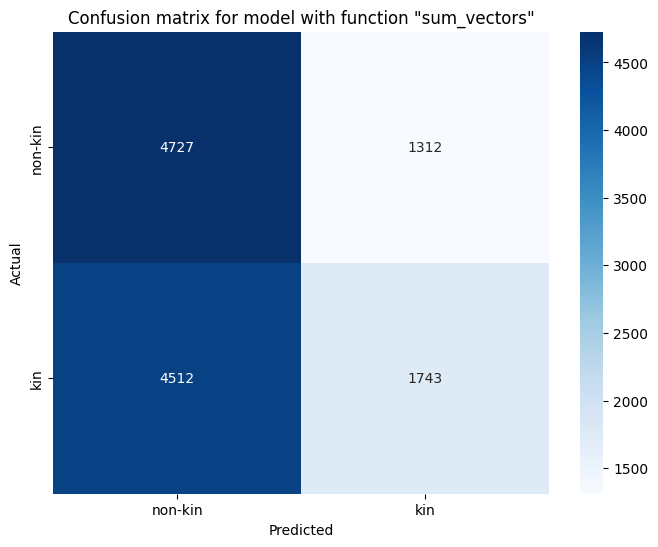

Scores for model with function "prod": train score is 0.8796857019980705, test score is 0.5392061168049455


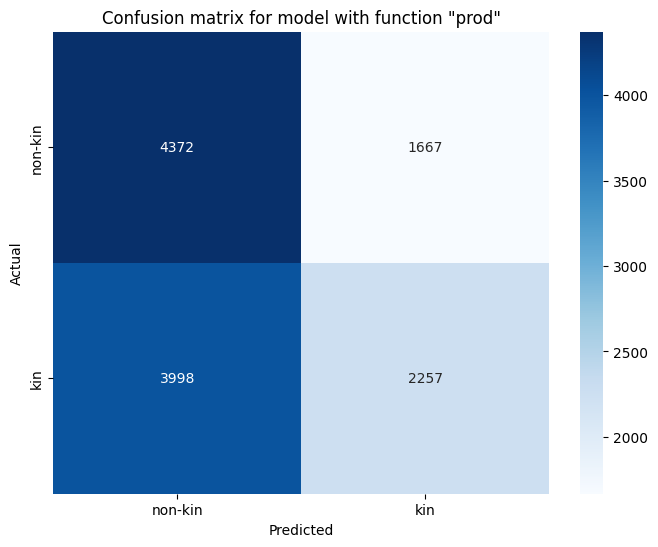

Scores for model with function "diff": train score is 0.6870851882417212, test score is 0.5447372702131121


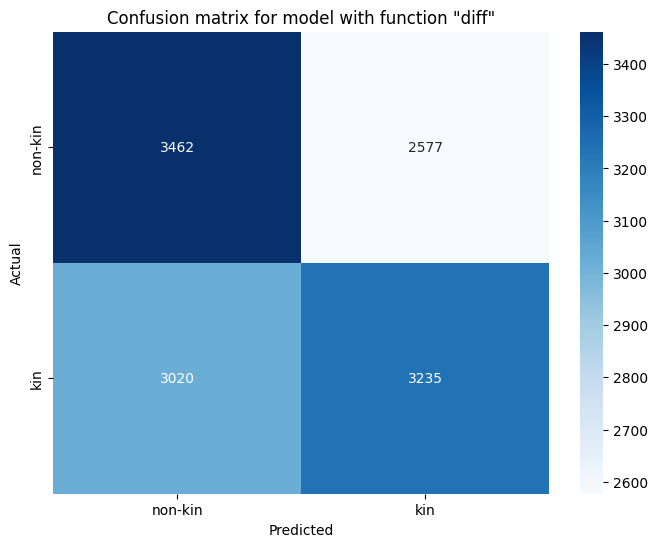

Scores for model with function "squared_sum": train score is 0.8864273011518836, test score is 0.5330242394664064


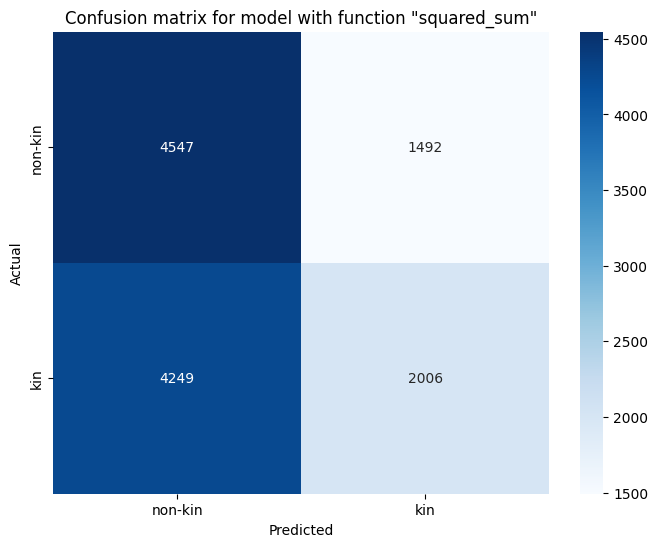

Scores for model with function "squared_diff": train score is 0.7877791080166913, test score is 0.5501870831299821


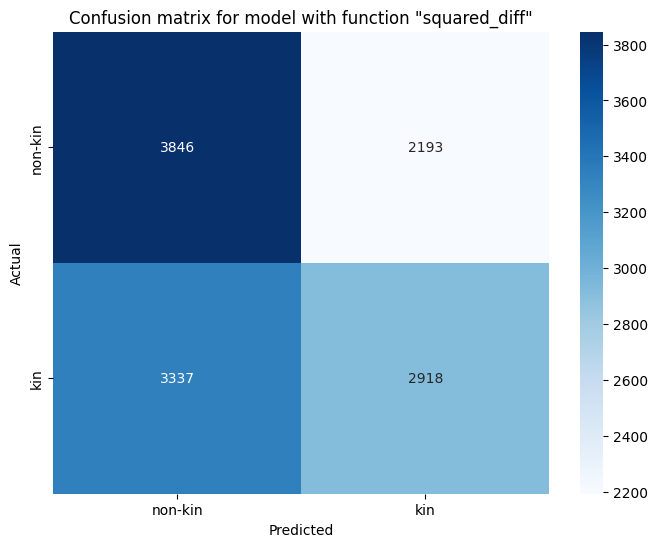

Scores for model with function "sum_squares": train score is 0.8931921471993305, test score is 0.5231006995282251


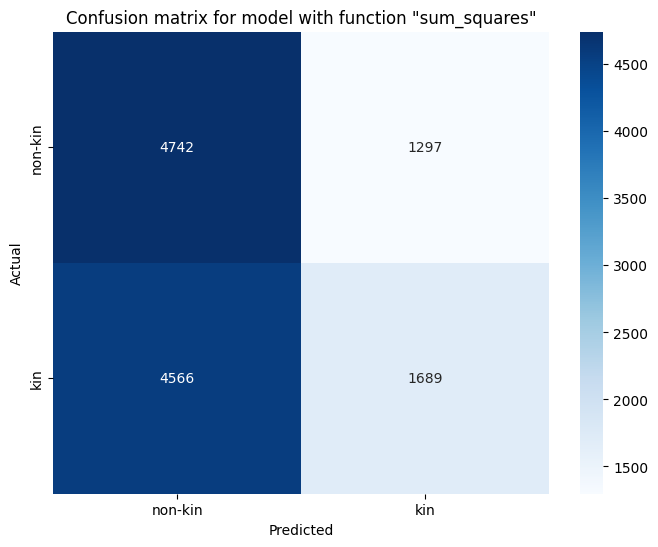

Scores for model with function "diff_squares": train score is 0.7113200748549975, test score is 0.5339189848706686


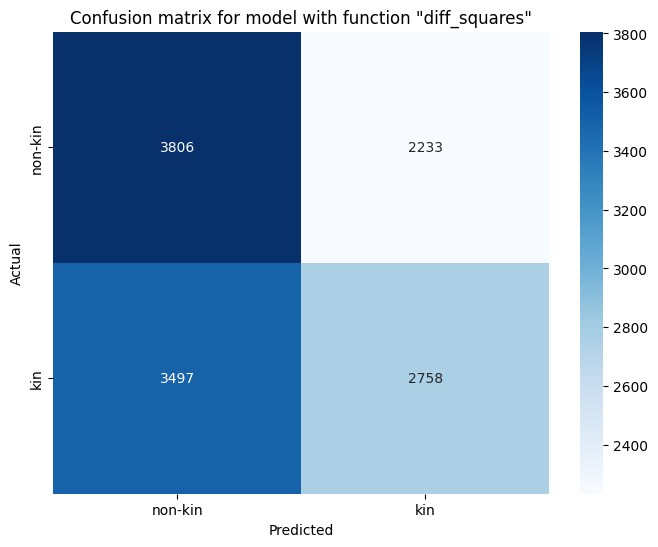

In [73]:
for i, function_name in enumerate(functions.keys()):
  train_score = accuracy_score(train_y, best_models_binary[i].predict(features_train_binary))
  pred_y = best_models_binary[i].predict(features_test_binary)
  test_score = accuracy_score(test_y, pred_y)
  print(f"Scores for model with function \"{function_name}\": train score is {train_score}, test score is {test_score}")
  cm = confusion_matrix(test_y, pred_y)
  plt.figure(figsize=(8, 6))
  sns.heatmap(cm, annot=True, cmap='Blues', fmt='d', xticklabels=["non-kin", "kin"], yticklabels=["non-kin", "kin"])
  plt.title(f'Confusion matrix for model with function \"{function_name}\"')
  plt.xlabel('Predicted')
  plt.ylabel('Actual')
  plt.show()

Scegliere i migliori classificatori per ciascuna funzione ci permette quindi di utilizzarli per la costruzione di un "ensemble classifier". Di norma, utilizzare delle strategie per aggregare i risultati di più classificatori in un unico modello restituisce dei risultati migliori, in quanto è possibile fare in modo che ognuno compensi le imprecisioni degli altri. Questo è possibile se c'è indipendenza statistica tra i diversi classificatori. Come suggerisce il comportamento della "rete siamese" che il vincitore della *competition* ha utilizzato, il fatto di processare le *feature* attraverso diverse funzioni sembra garantire sufficiente indipendenza.

Questo modello può essere visto come una generalizzazione dei metodi di fusione dei risultati: prende come input le *prediction* di un'insieme di modelli e le utilizza per addestrare un nuovo classificatore con le etichette del *dataset* di partenza. Questo è stato fatto per imitare proprio la rete siamese del vincitore della competizione. Il modello combinava attraverso diverse funzioni le *feature* estratte, per poi concatenarle ed utilizzarle nell'addestramento di un unico classificatore. La principale differenza con questo approccio è che il nostro classificatore finale fonde i risultati dei modelli e non *feature* iniziali.

Per poter costruire quindi il modello finale, occorre sostituire nei *dataset* di *training* e di *test* originali ciascun *pattern* con l'output di ciascuno dei classificatori addestrati e poi concatenare questi valori. Questi saranno poi il *training set* e il *test set* utilizzati per l'addestramento del modello finale.

In [74]:
features_train_meta_binary = np.column_stack([estimator.predict(features_train_binary) for estimator in best_models_binary])
features_test_meta_binary = np.column_stack([estimator.predict(features_test_binary) for estimator in best_models_binary])

Anche in questo caso, per velocizzare il processo di addestramento, è stato utilizzato come "classificatore finale" un modello della famiglia XGBoost, lo stesso che in precedenza. Gli iperparametri da tarare per esso sono quindi gli stessi che in precedenza. Se i classificatori che forniscono il loro output sono stati determinati al passo precedente, quello finale che compone i loro risultati viene determinato tramite una seconda *grid search* con "Bayesian Optimization", che riutilizza gli stessi valori per gli iperparametri della precedente. Anche in questo caso viene fatto *caching* dell'operazione.

In [75]:
%%capture

def train_final_model(models_directory, base_model, grid, train_X, train_y, fit_params={}, cv=3):
  if not os.path.exists(f"{models_directory}/final_model.bin"):
    model = BayesSearchCV(
      estimator=base_model,
      search_spaces=grid,
      fit_params=fit_params,
      n_points=4,
      n_iter=100,
      cv=cv,
      scoring="accuracy",
      random_state=1234
    )
    model.fit(train_X, train_y)
    dump_binary(model.best_estimator_, f"{models_directory}/final_model.bin")
    pd.DataFrame(model.cv_results_) \
      .sort_values(by=["rank_test_score"]) \
      .to_csv(f"{models_directory}/final_model_results.csv", index=False)
    return model.best_estimator_, model.cv_results_
  else:
    return (
      load_binary(f"{models_directory}/final_model.bin"),
      pd.read_csv(f"{models_directory}/final_model_results.csv")
    )

best_final_model_binary, best_final_model_results_binary = \
  train_final_model("xgboost_binary", base_XGBoost, grid_search_params, features_train_meta_binary, train_y)

I risultati dell'addestramento mostrano come il modello finale risulti troppo complesso e affetto da chiaro *overfitting*, in quanto lo *score* medio tra tutti i modelli non sia mai inferiore al 99,99%. Questo si nota anche dai valori degli iperparametri per quelli che teoricamente sono i migliori modelli: in praticamente nessuno di essi si nota una chiara tendenza. La percentuale di istanze campionate, il numero di alberi, il peso minimo di una foglia, la profondità massima di un albero e la percentuale di colonne considerate per un nuovo albero possono essere alti o bassi indifferentemente rispetto allo *score* finale. Gli iperparametri che mostrano meno variabilità sono il *learning rate*, che non supera mai il 45% e il parametro "gamma".

In [76]:
best_final_model_results_binary

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.057727,0.001614,0.006665,0.000084,0.446751,4.690933,0.023526,13,7,968,0.428649,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
1,0.056909,0.000625,0.006678,0.000102,0.896809,0.049933,0.358495,4,3,221,0.916784,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
2,0.056613,0.000133,0.006497,0.000031,0.133527,0.034745,0.434118,9,4,834,0.229917,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
3,0.056778,0.000341,0.006518,0.000120,0.643629,0.019280,0.111039,5,8,740,0.953977,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
4,0.056592,0.000056,0.006549,0.000030,0.395388,0.083173,0.286019,7,5,124,0.127079,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.056907,0.000560,0.006571,0.000078,0.289529,0.134227,0.082493,12,6,746,0.158829,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
96,0.056880,0.000147,0.006568,0.000050,0.450492,0.049136,0.202844,10,5,405,0.947753,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
97,0.056547,0.000122,0.006656,0.000129,0.825220,0.032396,0.580115,10,7,537,0.224468,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1
98,0.056929,0.000515,0.006592,0.000096,0.772810,1.553239,0.013923,7,6,543,0.488400,"OrderedDict([('classifier__colsample_bytree', ...",0.99996,0.99996,0.99992,0.999947,0.000019,1


Scelto quello che teoricamente è il miglior modello addestrato, viene poi valutato sul *test set*. Il risultato finale mostra quello che già abbiamo notato in precedenza: l'accuratezza sul *training set* è oltre il 90%, ma quella sul *test set* è attorno al 50%, segno che non ha generalizzato nulla ed ha imparato i *pattern* "a memoria". Anche in questo caso, la rete preferisce catalogare tutte le istanze come negativi, avendo una percentuale di veri positivi e veri negativi molto bassa.

Scores for final model: train score is 0.9261213720316622, test score is 0.5278997885147226


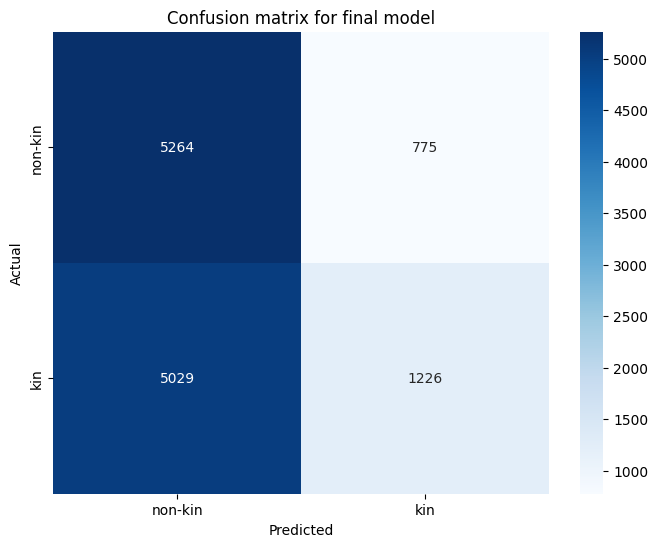

In [77]:
train_score = accuracy_score(train_y, best_final_model_binary.predict(features_train_meta_binary))
pred_y = best_final_model_binary.predict(features_test_meta_binary)
test_score = accuracy_score(test_y, pred_y)
print(f"Scores for final model: train score is {train_score}, test score is {test_score}")
cm = confusion_matrix(test_y, pred_y)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='d', xticklabels=["non-kin", "kin"], yticklabels=["non-kin", "kin"])
plt.title(f'Confusion matrix for final model')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

Vengono predette le probabilità di ciascuna istanza di appartenere alla classe "parenti". Successivamente viene calcolata la *logistic loss* rispetto ai dati reali che corrisponde all'errore commesso nella predizione.

In [78]:
pred_y_proba = best_final_model_binary.predict_proba(features_test_meta_binary)[:, 1]
errors = binary_crossentropy(test_y.values[:, np.newaxis], pred_y_proba[:, np.newaxis]).numpy()

Vengono mostrati con la funzione `show_tops` i casi in cui il modello ha dato i migliori risultati in ordine decrescente, cioè prima i migliori in assoluto. Come si può osservare il modello classifica tutte le coppie come "non parenti". Questo è in linea con la *confusion matrix* mostrata in precedenza e indica che il modello ha appreso poco dalle *feature* e classifica la maggior parte delle coppie di persone come "non parenti". Tra le *feature* che noi riteniamo che il modello utilizzi maggiormente per classificare siano il colore della pelle, la posa e/o posizione del volto e la forma degli occhi. La maggiore risoluzione delle immagini permette una estrazione migliore delle *feature* e un conseguente miglioramento nelle prestazioni del modello.

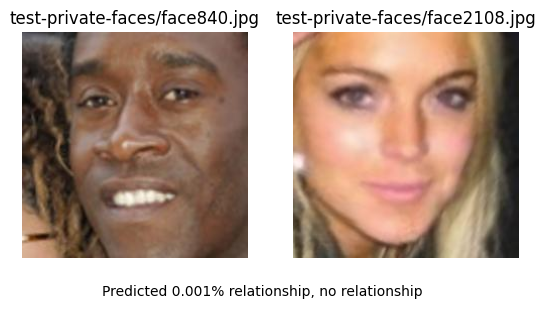

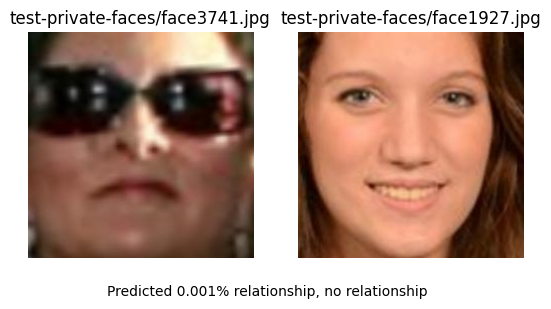

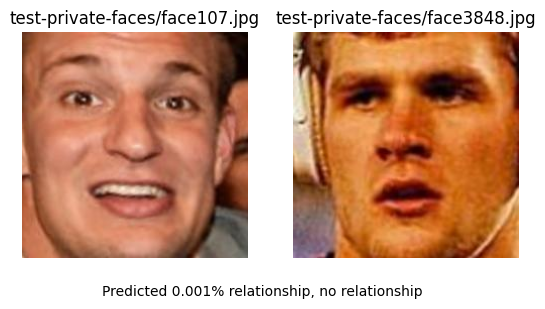

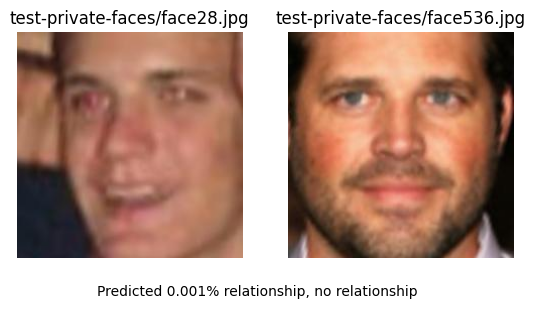

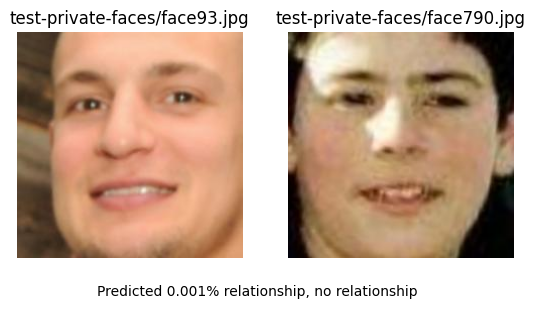

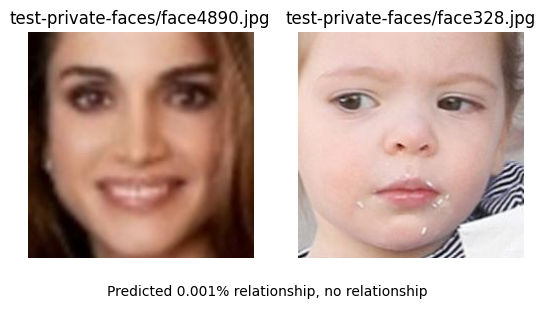

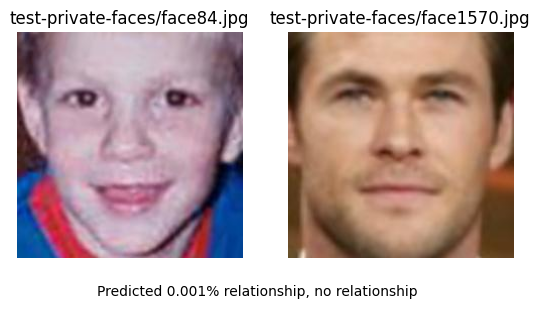

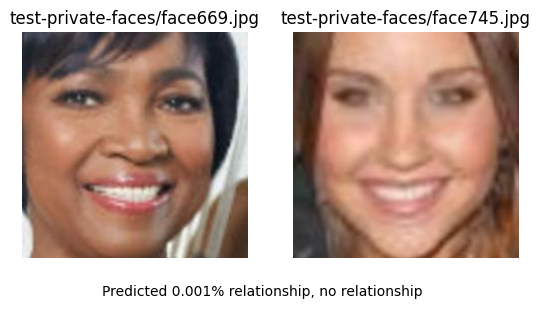

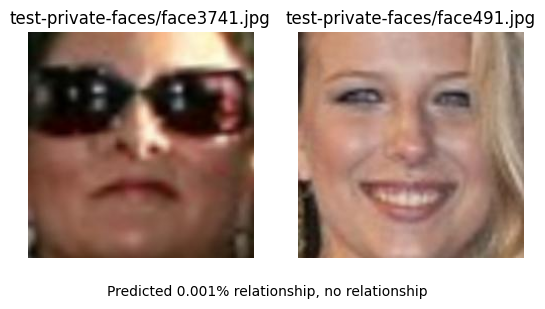

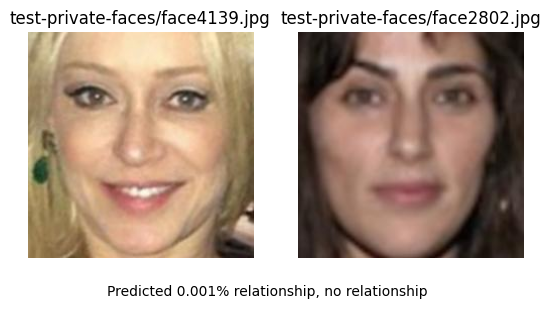

In [79]:
show_tops(pred_y_proba, errors, test_binary, give_best=True, is_binary=True, top_n=10)

Se osserviamo le istanze per le quali il modello predice la classe "parente" commettendo minore errore pensiamo si possa osservare che, oltre alle caratteristiche individuate nel punto precedente, anche la forma della bocca e un sorriso che mostra i denti contribuiscano alla classificazione corretta.

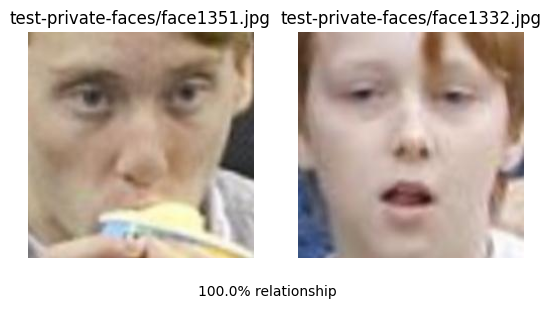

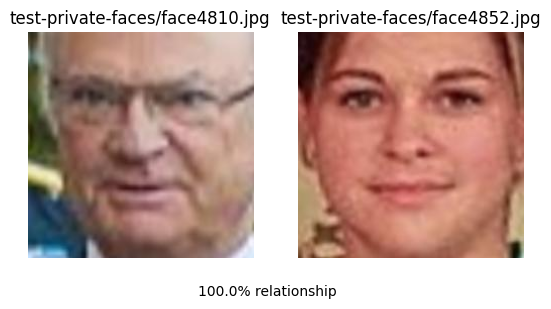

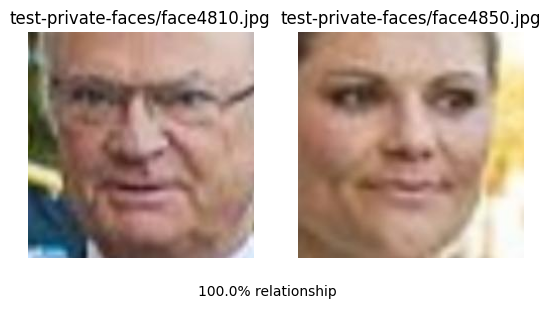

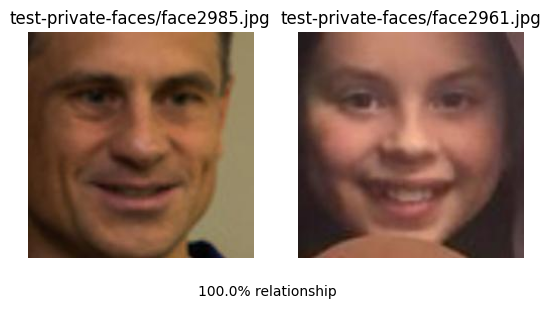

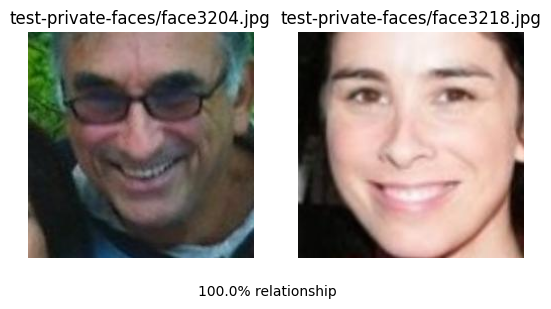

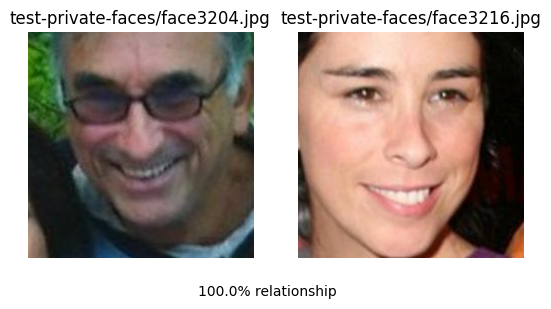

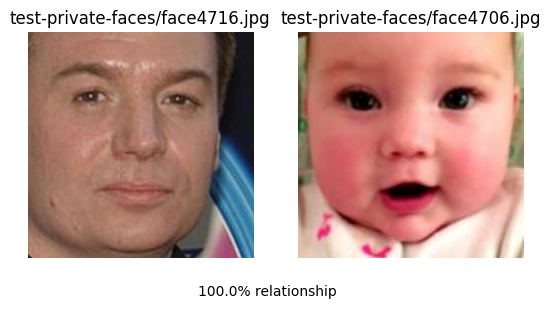

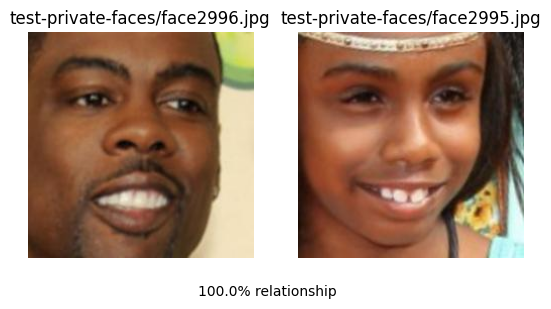

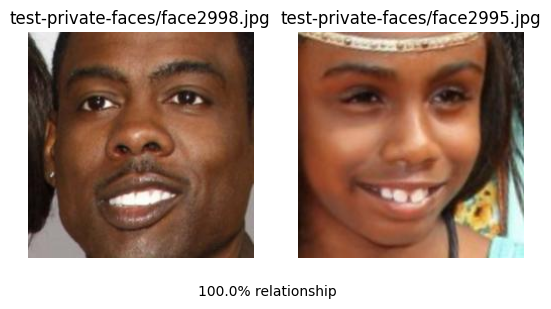

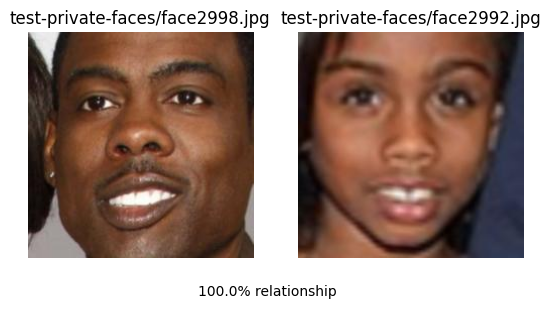

In [80]:
best_kins = errors[test_binary['label'] == 1].argsort()
test_binary = test_binary.reset_index(drop=True)
for best_kin in best_kins[:10]:
  image_1 = f'test-private-faces/{test_binary.at[best_kin, "p1"]}'
  image_2 = f'test-private-faces/{test_binary.at[best_kin, "p2"]}'
  plot_images(image_1, image_2, f'{round(pred_y_proba[test_binary["label"] == 1][best_kin], 2) * 100}% relationship')

Vengono mostrati con la funzione `show_tops` i casi in cui il modello ha dato i peggiori risultati in ordine decrescente, prima i peggiori in assoluto.
Specularmente rispetto a prima, gli errori maggiori commessi dal modello riguardano in maggioranza le coppie legate da una parentela. Tra le caratteristiche delle immagini che portano il modello a compiere errori c'è il fatto che sono rimaste immagini "grayscale" dal processo di *preprocessing* delle immagini. Altri fattori che pensiamo abbiano inciso negativamente sulla qualità della predizione sono la bassa qualità dell'immagine, la differente illuminazione tra le due immagini, la presenza di occhi chiusi o socchiusi e la presenza di occhiali.

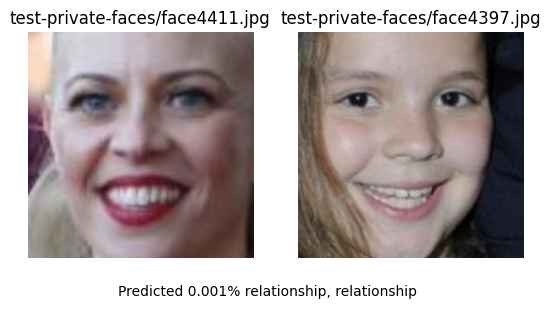

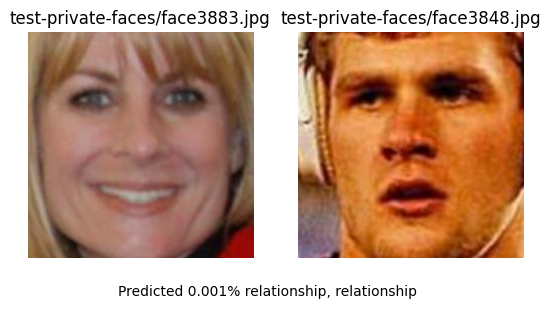

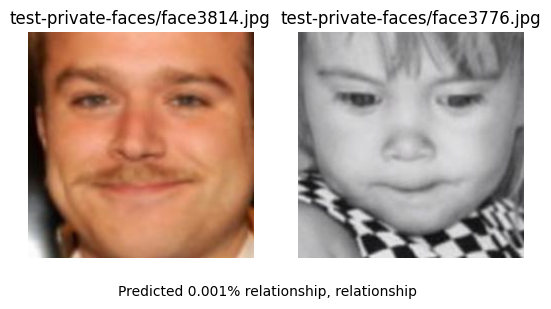

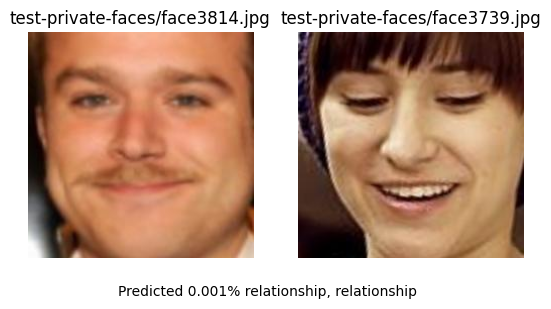

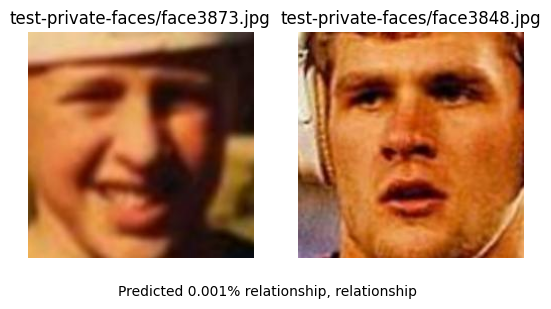

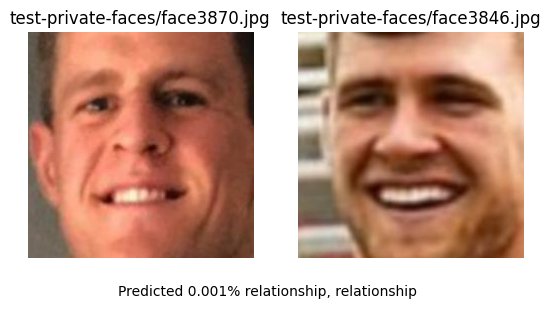

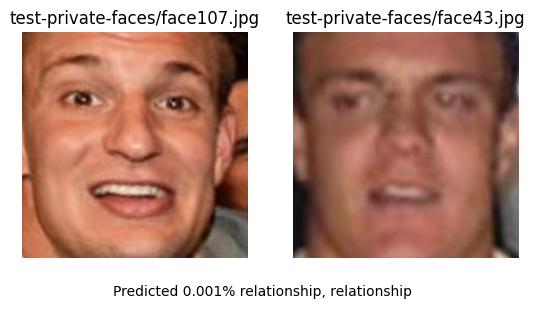

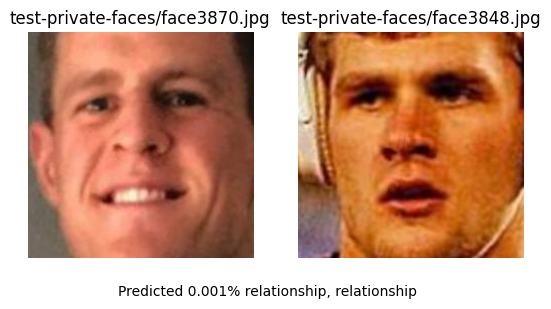

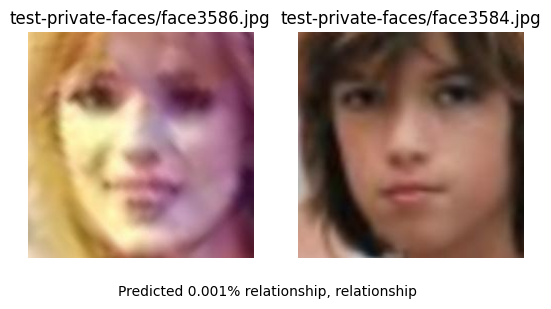

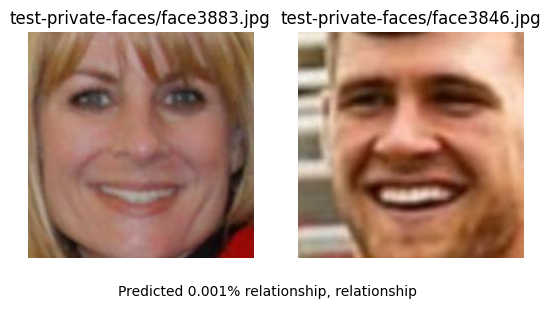

In [81]:
show_tops(pred_y_proba, errors, test_binary, give_best=False, is_binary=True, top_n=10, classes=classes)

### Addestramento del classificatore per il secondo problema

L'addestramento del secondo classificatore si è svolto in maniera analoga a quello del primo. Questo significa che le *feature* utilizzate per ciascuna immagine sono sempre le stesse, cambia solamente l'etichetta utilizzata per ciascuna delle coppie di immagini, dato che si utilizza il *dataset* inerente al secondo problema.

Come prima cosa perciò si è costruito il *dataset* delle coppie di *training* per il secondo problema, dove il percorso di ogni immagine è sostituito con le *feature* corrispondenti. Viene perciò creata una matrice con tante righe quante sono le istanze dalle quali è stato possibile estrarre tutte le *feature*, ma con un numero di colonne che è doppio rispetto al numero di *feature* per immagine. Nel *dataset* originale si trattengono solamente le coppie di immagini per cui le *feature* sono state estratte da entrambe, così da avere le etichette delle classi.

In [82]:
train_multiclass = \
  train_multiclass[(train_multiclass["p1"].isin(train_paths.flatten())) & (train_multiclass["p2"].isin(train_paths.flatten()))]

features_train_multiclass = np.empty((train_multiclass.shape[0], train_features.shape[1] * 2), dtype=np.float32)
features_train_multiclass[:, :train_features.shape[1]] = \
  np.array([train_features[np.argwhere(train_paths == path)[0][0]] for path in train_multiclass["p1"]])
features_train_multiclass[:, train_features.shape[1]:] = \
  np.array([train_features[np.argwhere(train_paths == path)[0][0]] for path in train_multiclass["p2"]])

train_y = train_multiclass['relation']

features_train_multiclass.shape

(41637, 2056)

La stessa cosa viene fatta anche per il *dataset* di test delle coppie per il secondo problema.

In [83]:
test_multiclass = \
  test_multiclass[(test_multiclass["p1"].isin(test_paths.flatten())) & (test_multiclass["p2"].isin(test_paths.flatten()))]

features_test_multiclass = np.empty((test_multiclass.shape[0], test_features.shape[1] * 2), dtype=np.float32)
features_test_multiclass[:, :test_features.shape[1]] = \
  np.array([test_features[np.argwhere(test_paths == path)[0][0]] for path in test_multiclass["p1"]])
features_test_multiclass[:, test_features.shape[1]:] = \
  np.array([test_features[np.argwhere(test_paths == path)[0][0]] for path in test_multiclass["p2"]])

test_y = test_multiclass['relation']

features_test_multiclass.shape

(6255, 2056)

La rimozione di coppie dal *dataset* di *training* ha fatto in modo di modificare le frequenze delle diverse classi. Ora la relazione più presente è quella tra fratelli maschi, precedentemente terza, seguita da quella "padre - figlio", precedentemente prima, e infine quella "fratello - sorella", precedentemente settima. La relazione "madre - figlio", in origine seconda, ora è quarta. Rimangono invece pressoché invariate le altre, ovvero "madre - figlia", "padre - figlia" e quella tra sorelle. In fondo alla classifica per frequenza troviamo sempre quelle che coinvolgono i nonni, già sottorappresentate in origine.

Se si osserva bene, però, non c'è stato uno sbilanciamento particolarmente significativo tra le frequenze: se si considerano i rapporti tra esse, ad esempio tra la prima e la sesta, si nota come sono rimasti pressoché invariati, segno che l'eliminazione è avvenuta pressoché in maniera casuale e perciò simile ad un *downsampling* del *dataset*. Per questo motivo, ci si è riservati di non effettuare ulteriori manipolazioni su questo *dataset* per correggere le frequenze.

Una distribuzione simile di frequenze, anche se, anche in questo caso, con le varie classi ordinate in modo differente, si riscontra anche nel *test set*. Essendo quindi un *dataset* rappresentativo per il corrispettivo *training set*, anche su questo non sono state effettuate ulteriori manipolazioni.

In [84]:
train_multiclass["relation"].value_counts().rename({v: k for (k, v) in classes.items()})

bb      8019
fs      6776
sibs    6484
ms      6145
md      5139
fd      4873
ss      2851
gmgs     669
gmgd     258
gfgs     240
gfgd     183
Name: relation, dtype: int64

In [85]:
test_multiclass["relation"].value_counts().rename({v: k for (k, v) in classes.items()})

ms      1161
bb      1016
fd       968
fs       948
md       817
sibs     748
ss       282
gmgd     103
gfgd      90
gmgs      65
gfgs      57
Name: relation, dtype: int64

Questo secondo problema è un problema multiclasse dove le istanze per ciascuna di esse sono sbilanciate. Per fare in modo che questo non influenzi negativamente l'addestramento, è stato assegnato un peso a ciascuna classe inversamente proporzionale alla sua presenza nel *dataset* di *training*: più è presente e meno peso avrà nell'addestramento.

In [86]:
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(train_y), y=train_y)
weights = np.ones_like(train_y, np.float32)
for class_val, weight in zip(np.unique(train_y), class_weights):
  weights[train_y == class_val] = weight
class_weights

array([ 0.47202666,  0.77676623,  0.55861597,  5.65796983, 14.67124736,
       15.77159091, 20.68405365,  0.73656   ,  0.61597751,  0.58377264,
        1.32766812])

Anche per questo secondo problema viene utilizzato un modello della famiglia "XGBoost", l'unica differenza risiede nel fatto che la funzione obiettivo è ora "softmax", la stessa utilizzata nelle reti neurali quando occorre risolvere un problema di classificazione multiclasse. Questa funzione fa infatti sì che per ogni input sia restituito un vettore di output i cui valori sommino a 1, in modo tale che possano essere interpretati come le probabilità di appartenenza alle diverse classi.

In [87]:
base_XGBoost = XGBClassifier(
  objective='multi:softmax',
  num_class=len(np.unique(train_y)),
  eval_metric='error',
  tree_method='gpu_hist',
  seed=1234
)

L'addestramento avviene sempre utilizzando *grid search* con "Bayesian Optimization" a partire dagli stessi valori utilizzati nei casi precedenti.
In questo caso passiamo anche i pesi come parametro della fit di "XGBoost".

In [88]:
%%capture

fit_params = {
    'classifier__sample_weight': weights
}

best_models_multiclass, best_models_results_multiclass = \
  train_models("xgboost_multiclass", functions, base_XGBoost, grid_search_params, features_train_multiclass, train_y, fit_params=fit_params)

L'addestramento dei modelli che facevano uso della funzione di somma ha avuto come risultato il fatto che i migliori tra essi hanno uno *score* attorno al 25%, sicuramente non incoraggiante. Tra questi modelli, l'addestramento ha prediletto degli *ensemble* tendenzialmente con molti alberi, ma molto bassi, dato che l'altezza massima non supera il valore di 2. Il *learning rate* è rimasto relativamente contenuto, segno di un approccio più conservativo nell'introdurre nuovi "weak classifiers". Comportamento simile, anche se più variegato, per quanto riguarda il parametro "gamma". Da ultimo invece, non si nota una chiara tendenza per quanto riguarda la percentuale di colonne e di istanze del *dataset* di *training* da considerare per ogni nuovo albero, così come il peso minimo di ogni foglia.

In [89]:
best_models_results_multiclass[0]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,24.984092,0.051489,0.677476,0.003275,0.464586,0.100170,0.010137,2,9,787,0.543101,"OrderedDict([('classifier__colsample_bytree', ...",0.203113,0.305498,0.240435,0.249682,0.042307,1
1,24.616542,0.063430,0.452525,0.015001,0.769733,0.010000,0.039587,1,10,1000,0.317449,"OrderedDict([('classifier__colsample_bytree', ...",0.205130,0.294762,0.243029,0.247640,0.036737,2
2,23.596221,0.092644,0.439851,0.004684,0.462868,8.910025,0.016230,1,1,993,0.670060,"OrderedDict([('classifier__colsample_bytree', ...",0.198645,0.309460,0.233806,0.247304,0.046236,3
3,15.395075,0.022716,0.431467,0.009735,0.093421,0.011098,0.109303,2,1,467,0.414536,"OrderedDict([('classifier__colsample_bytree', ...",0.208228,0.273723,0.259313,0.247088,0.028101,4
4,22.939328,0.078092,0.430331,0.003368,0.129216,0.105568,0.023945,1,10,1000,0.239507,"OrderedDict([('classifier__colsample_bytree', ...",0.202464,0.304201,0.234311,0.246992,0.042491,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,38.018726,1.321765,1.104633,0.014709,0.965396,0.024726,0.010000,15,1,100,0.108366,"OrderedDict([('classifier__colsample_bytree', ...",0.195763,0.257079,0.240003,0.230948,0.025838,96
96,20.167724,0.855991,0.348278,0.014048,0.864351,6.894275,0.777899,5,10,545,0.293506,"OrderedDict([('classifier__colsample_bytree', ...",0.176093,0.242885,0.271633,0.230204,0.040021,97
97,7.506415,0.055461,0.132378,0.001154,0.663552,6.733751,1.000000,7,4,100,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.174220,0.246920,0.263564,0.228235,0.038794,98
98,58.778439,0.726592,0.263780,0.003619,0.254067,5.914844,0.899135,15,1,628,0.724391,"OrderedDict([('classifier__colsample_bytree', ...",0.171770,0.243245,0.259889,0.224968,0.038225,99


Leggermente più alto lo *score* per il modello che utilizza la funzione prodotto, attorno al 26%, comunque decisamente basso. In questo caso, l'addestramento ha prediletto degli *ensemble* con molti alberi, di altezza che non supera la metà del valore previsto per il suo massimo. Il *learning rate* rimane relativamente basso, come stabile rimane la percentuale di istanze campionate per ogni albero, tra il 60% e il 70%, e la percentuale di colonne considerate del *dataset* di *training* per ogni albero, ovvero pressoché la totalità delle stesse. Più ondivago il comportamento del parametro "gamma" e del peso minimo delle foglie.

In [90]:
best_models_results_multiclass[1]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,43.878078,1.017328,1.061675,0.092001,1.000000,2.984637,0.101352,5,1,1000,0.586424,"OrderedDict([('classifier__colsample_bytree', ...",0.220693,0.282945,0.274948,0.259529,0.027654,1
1,65.497227,1.376191,1.990076,0.063161,0.637658,4.445503,0.025906,7,1,650,0.642953,"OrderedDict([('classifier__colsample_bytree', ...",0.221197,0.284819,0.271705,0.259241,0.027428,2
2,43.755614,0.246580,1.348177,0.021041,1.000000,0.010000,0.183186,3,10,1000,0.682832,"OrderedDict([('classifier__colsample_bytree', ...",0.217235,0.278262,0.282081,0.259193,0.029710,3
3,134.105562,7.084278,4.469794,0.026179,1.000000,0.025478,0.046973,7,10,1000,0.585530,"OrderedDict([('classifier__colsample_bytree', ...",0.222711,0.280568,0.273867,0.259048,0.025840,4
4,211.772071,4.883562,5.735746,0.073691,1.000000,0.010000,0.047802,8,1,1000,0.563865,"OrderedDict([('classifier__colsample_bytree', ...",0.228907,0.277758,0.268968,0.258544,0.021262,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,69.222523,2.273612,2.330390,0.174625,0.631586,0.010415,0.862274,9,10,959,0.275584,"OrderedDict([('classifier__colsample_bytree', ...",0.175733,0.245767,0.276821,0.232774,0.042279,96
96,48.153238,0.090920,0.270617,0.003202,0.440969,9.000000,1.000000,11,2,773,0.759737,"OrderedDict([('classifier__colsample_bytree', ...",0.174869,0.256863,0.260826,0.230852,0.039620,97
97,6.125120,0.023043,0.104133,0.000459,0.640854,9.000000,1.000000,1,2,100,0.209829,"OrderedDict([('classifier__colsample_bytree', ...",0.183947,0.250594,0.255422,0.229988,0.032615,98
98,79.008558,0.516216,1.342147,0.016197,0.593019,0.445616,0.965277,15,1,978,0.119903,"OrderedDict([('classifier__colsample_bytree', ...",0.176310,0.236328,0.258880,0.223839,0.034847,99


Per quanto riguarda l'addestramento dei modelli che utilizzano la funzione differenza, lo score rimane inalterato rispetto al caso precedente, così come il numero di alberi nell'*ensemble*, la profondità massima degli stessi, la percentuale di istanze campionate per ogni nuovo albero e il *learning rate*. Diversamente da prima, invece, la percentuale di colonne mantenute per albero, mediamente molto poche. Il parametro "gamma" e il il peso minimo delle foglie non mostrano nessuna tendenza particolare.

In [91]:
best_models_results_multiclass[2]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,53.269066,0.828918,3.247133,0.007101,0.060000,0.010000,0.035172,5,1,1000,0.718219,"OrderedDict([('classifier__colsample_bytree', ...",0.229627,0.281865,0.270120,0.260538,0.022376,1
1,39.134011,1.627017,1.473059,0.026975,0.060000,9.000000,0.027833,6,1,1000,0.682292,"OrderedDict([('classifier__colsample_bytree', ...",0.229339,0.285107,0.266662,0.260369,0.023198,2
2,82.935003,1.109742,4.057537,0.031667,0.382318,0.010000,0.022104,6,10,1000,0.752021,"OrderedDict([('classifier__colsample_bytree', ...",0.227106,0.281432,0.270481,0.259673,0.023458,3
3,52.322772,0.124266,1.959806,0.056932,0.060000,9.000000,0.017227,8,1,1000,0.596381,"OrderedDict([('classifier__colsample_bytree', ...",0.227898,0.283306,0.267094,0.259433,0.023260,4
4,43.324881,0.358207,2.622914,0.046132,0.060000,0.010000,0.037686,5,10,816,0.653423,"OrderedDict([('classifier__colsample_bytree', ...",0.229339,0.279127,0.268175,0.258880,0.021362,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,7.931584,0.035314,0.138767,0.001417,0.060000,9.000000,0.015443,1,1,213,0.371123,"OrderedDict([('classifier__colsample_bytree', ...",0.200375,0.219108,0.228114,0.215866,0.011554,96
96,6.880075,0.050437,0.157552,0.000493,0.592401,0.038435,0.782080,2,6,109,0.174107,"OrderedDict([('classifier__colsample_bytree', ...",0.190215,0.217595,0.231645,0.213152,0.017203,97
97,23.424108,0.127895,0.429321,0.002888,0.308432,2.491586,0.846779,1,9,998,0.182337,"OrderedDict([('classifier__colsample_bytree', ...",0.192809,0.215217,0.226313,0.211447,0.013935,98
98,13.812042,0.164468,0.697742,0.008623,0.136133,0.034216,0.395738,15,2,100,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.174869,0.200735,0.209021,0.194875,0.014545,99


I migliori modelli addestrati che utilizzano la somma al quadrato come funzione di aggregazione hanno mediamente uno *score* del 25%. In generale, l'addestramento ha prediletto come sempre *ensemble* fatti da alberi profondi e numerosi. L'approccio seguito è rimasto tendenzialmente conservativo, con *learning rate* relativamente bassi. Diversamente dal solito, ha inciso particolarmente il peso delle foglie degli alberi, che nei migliori modelli è sempre rimaso relativamente elevato e comunque superiore a 3. Tutti gli altri parametri invece non mostrano una tendenza precisa.

In [92]:
best_models_results_multiclass[3]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,33.788685,0.026937,0.929271,0.002623,0.906084,0.015553,0.109453,2,3,989,0.104083,"OrderedDict([('classifier__colsample_bytree', ...",0.204193,0.267094,0.274299,0.248529,0.031488,1
1,46.068494,0.087288,0.967576,0.029860,0.060000,9.000000,0.039554,15,7,1000,0.543388,"OrderedDict([('classifier__colsample_bytree', ...",0.213128,0.271705,0.257728,0.247520,0.024980,2
2,20.666635,0.402782,0.400894,0.010635,1.000000,9.000000,0.052133,15,10,561,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.210102,0.280280,0.252035,0.247472,0.028831,3
3,161.517629,5.284389,6.299276,0.215309,0.397353,0.010765,0.091310,14,6,962,0.581167,"OrderedDict([('classifier__colsample_bytree', ...",0.210822,0.263924,0.267671,0.247472,0.025961,3
4,81.737682,1.758026,4.052583,0.064627,0.549951,2.093872,0.012507,15,10,997,0.071698,"OrderedDict([('classifier__colsample_bytree', ...",0.213992,0.277398,0.251027,0.247472,0.026007,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,87.934582,0.879223,0.406455,0.005366,0.962230,1.311349,0.887936,15,10,922,0.958330,"OrderedDict([('classifier__colsample_bytree', ...",0.189279,0.248145,0.264644,0.234023,0.032348,96
96,21.461443,0.585186,0.852675,0.022386,0.868970,0.170305,0.188497,13,5,144,0.069572,"OrderedDict([('classifier__colsample_bytree', ...",0.181930,0.247856,0.266806,0.232197,0.036377,97
97,90.753496,0.780006,0.374278,0.022892,0.564651,6.578894,0.960173,14,2,995,0.656767,"OrderedDict([('classifier__colsample_bytree', ...",0.170978,0.243533,0.261114,0.225208,0.039013,98
98,22.142447,0.036481,0.428739,0.019691,0.921402,0.134490,0.881034,1,1,869,0.150085,"OrderedDict([('classifier__colsample_bytree', ...",0.173500,0.228691,0.266013,0.222735,0.038003,99


I modelli che utilizzano come funzione di aggregazione il quadrato della differenza hanno uno *score* che rimane mediamente più basso tra tutti quelli visti finora, infatti non supera mai il 22%, neanche tra i migliori. In questo caso, praticamente tutti i parametri non esibiscono tendenze precise, infatti è sempre presente almeno un "outlier" per ciascuno di essi se si vogliono individuare degli specifici comportamenti. In ogni caso, l'addestramento ha preferito *ensemble* con alberi abbastanza profondi e con un numero elevato di alberi, un valore del parametro "gamma" ridotto e un *learning rate* non alto, ma sicuramente non molto basso come in altri casi. La percentuale di colonne mantenute del *dataset* di *training* per ciascun nuovo albero è rimasta di norma elevata, così come il peso minimo delle foglie. Il numero di istanze campionate non mostra una tendenza particolare.

In [93]:
best_models_results_multiclass[4]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,146.673272,5.451676,4.940090,0.105506,0.887840,0.147251,0.062814,8,1,905,0.150678,"OrderedDict([('classifier__colsample_bytree', ...",0.173283,0.243101,0.250018,0.222134,0.034658,1
1,46.785982,1.690111,1.696861,0.063107,0.848203,0.031866,0.333450,10,10,307,0.947836,"OrderedDict([('classifier__colsample_bytree', ...",0.170978,0.243966,0.249225,0.221390,0.035711,2
2,19.251409,0.040641,0.361748,0.000474,0.531915,0.734781,0.360407,1,10,761,0.861206,"OrderedDict([('classifier__colsample_bytree', ...",0.169393,0.249730,0.244398,0.221173,0.036679,3
3,51.490064,0.983948,2.980467,0.114784,0.060000,0.010000,0.192915,9,10,518,0.797312,"OrderedDict([('classifier__colsample_bytree', ...",0.174436,0.244974,0.242885,0.220765,0.032771,4
4,62.317795,1.852936,2.086473,0.025718,1.000000,0.010000,0.089984,8,6,364,0.292251,"OrderedDict([('classifier__colsample_bytree', ...",0.173283,0.246920,0.241876,0.220693,0.033587,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,26.017880,0.769879,1.460118,0.124804,0.060000,9.000000,0.010000,15,10,264,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.174292,0.231861,0.202896,0.203017,0.023503,96
96,6.378252,0.041108,0.125734,0.008660,0.938258,0.344982,0.063939,1,10,121,0.791255,"OrderedDict([('classifier__colsample_bytree', ...",0.164133,0.233518,0.209597,0.202416,0.028778,97
97,20.323923,0.102655,0.404354,0.000603,0.105034,0.010000,0.013432,1,2,856,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.170978,0.232365,0.200159,0.201167,0.025072,98
98,46.166093,2.216770,1.109367,0.004670,0.966634,0.010000,0.589985,15,10,1000,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.153181,0.202104,0.223071,0.192785,0.029283,99


Utilizzando come funzione di aggregazione la somma di quadrati, lo score medio dei migliori modelli si aggira attorno al 24,5%. Pur con un outlier, i migliori 5 modelli hanno tutti *ensemble* con molti alberi, minimamente profondi e con un peso minimo delle foglie pari al massimo possibile. Inoltre, la percentuale di istanze campionate per ciascun nuovo albero è sempre pari al minimo, segno di una tendenza a voler mantenere quanto più basso possibile l'*overfitting*. Anche l'approccio nell'introdurre nuovi alberi si è mantenuto conservativo, con *learning rate* nell'ordine di $10^{-2}$. Nessuna tendenza si può individuare per i parametri "gamma" e percentuale delle colonne campionate.

In [94]:
best_models_results_multiclass[5]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,24.519573,0.138725,0.376927,0.002046,0.668967,8.266384,0.099644,1,10,1000,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.204410,0.279127,0.257151,0.246896,0.031353,1
1,24.654537,0.213929,0.443429,0.001152,1.000000,0.010000,0.068628,1,10,1000,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.209237,0.274660,0.255638,0.246512,0.027477,2
2,18.129683,0.095469,0.368591,0.001530,0.060000,0.015011,0.060008,1,4,734,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.203257,0.289646,0.243533,0.245479,0.035295,3
3,13.149734,0.171648,0.248924,0.020414,0.704048,2.463322,0.053165,1,10,436,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.207364,0.288061,0.240867,0.245431,0.033102,4
4,24.434022,0.184018,0.398675,0.024186,1.000000,9.000000,0.065861,1,10,1000,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.209237,0.276173,0.249586,0.244998,0.027518,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,91.967134,0.952014,0.528162,0.012386,1.000000,0.066748,1.000000,15,7,865,1.000000,"OrderedDict([('classifier__colsample_bytree', ...",0.180489,0.242669,0.265293,0.229483,0.035855,96
96,33.951430,0.353936,0.734475,0.025519,0.102652,0.082874,0.456596,12,5,248,0.997049,"OrderedDict([('classifier__colsample_bytree', ...",0.190720,0.238346,0.257511,0.228859,0.028081,97
97,21.691761,0.138641,0.390134,0.003911,0.459335,0.014302,0.545557,1,10,878,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.178615,0.231645,0.270336,0.226866,0.037597,98
98,43.261328,0.210550,0.600879,0.007516,1.000000,0.010000,1.000000,14,2,796,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.174436,0.229555,0.255206,0.219732,0.033698,99


L'addestramento dei modelli che utilizzavano la funzione di aggregazione differenza di quadrati hanno ottenuto dei risultati sopra la media, circa del 25,5%, anche se rimangono deludenti. Come spesso visto in passato, si torna ad avere *ensemble* molto grandi e con alberi profondi, pesi minimi delle foglie tendenzialmente elevati, *learning rate* piccoli e percentuale di campionamento delle istanze del *dataset* di *training* ridotto. Anche la percentuale di colonne utilizzate per ogni nuovo albero è relativamente elevata, mentre nulla si può dire per il parametro "gamma".

In [95]:
best_models_results_multiclass[6]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,72.275473,1.129936,3.324456,0.081966,1.000000,0.010000,0.010000,10,10,729,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.226962,0.275668,0.271057,0.257896,0.021955,1
1,89.965327,1.878535,5.025287,0.015918,0.456283,1.049330,0.010569,11,9,998,0.082571,"OrderedDict([('classifier__colsample_bytree', ...",0.224152,0.272642,0.272138,0.256310,0.022741,2
2,98.644117,1.659359,4.368637,0.019771,1.000000,0.010000,0.016330,15,10,1000,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.222783,0.273939,0.270553,0.255758,0.023358,3
3,145.482679,3.552008,7.016811,0.081111,0.625745,0.025392,0.010000,15,3,1000,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.224656,0.268535,0.271345,0.254845,0.021378,4
4,46.302458,0.395708,1.577294,0.064061,1.000000,9.000000,0.014993,9,10,707,0.208406,"OrderedDict([('classifier__colsample_bytree', ...",0.227034,0.265509,0.271633,0.254725,0.019740,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,8.259857,0.015719,0.154878,0.001319,0.924218,0.185787,0.010027,1,9,194,0.097402,"OrderedDict([('classifier__colsample_bytree', ...",0.195835,0.226169,0.234743,0.218916,0.016691,96
96,6.178853,0.063778,0.118688,0.002448,1.000000,5.546650,0.010000,1,1,100,0.276849,"OrderedDict([('classifier__colsample_bytree', ...",0.193818,0.217091,0.225881,0.212263,0.013527,97
97,21.727355,0.828840,0.561893,0.002644,0.547184,4.285693,0.824719,15,6,425,0.063952,"OrderedDict([('classifier__colsample_bytree', ...",0.175517,0.196196,0.226313,0.199342,0.020856,98
98,20.579278,0.058393,0.534379,0.009843,0.060000,1.070704,1.000000,2,3,669,0.060000,"OrderedDict([('classifier__colsample_bytree', ...",0.180416,0.205346,0.201383,0.195715,0.010938,99


Considerando quindi solamente i migliori classificatori e riaddestrandoli sull'intero *dataset* per poter valutare le loro accuratezze, si può notare, eccetto che per la funzione di somma e di somma di quadrati, un forte *overfitting*. Infatti, le accuratezze di *training* si aggirano tra il 70% e il 95%, mentre quelle di *test* si aggirano attorno al 20-25%. Anche per le funzioni citate, comunque, lo *score* di training è rispettivamente del 44% e del 54%. Anche se i modelli sono migliori di uno che tenta semplicemente una risposta casuale, bisogna considerare che le classi non sono tra di loro bilanciate e perciò possono semplicemente avere appreso le distribuzioni delle classi. Per quanto riguarda l'ossevazione delle *confusion matrix*, si può notare come le parentele inerenti ai nonni, quelle con meno istanze di tutte, non vengono praticamente mai classificate come tali, né succede praticamente mai che un'istanza venga classificata come di queste classi, segno che sono state completamente snobbate. Le classi di norma più correttamente classificate sono "padre-figlio", "madre-figlia", "padre-figlia", "madre-figlio", quelle più presenti. Un'altra classe che alcuni modelli come quelli che utilizzano la differenza e la differenza di quadrati riescono ad individuare in un numero di istanze compatibile con le altre è quella dei "fratelli maschi", la più presente nel *training set*. Nonostante questi risultati incoraggianti, è pur sempre vero che le classi citate sono anche quelle per cui la rete si confonde di più e vi classifica istanze che non vi appartengono.

Scores for model with function "sum_vectors": train score is 0.4364867785863535, test score is 0.19936051159072743


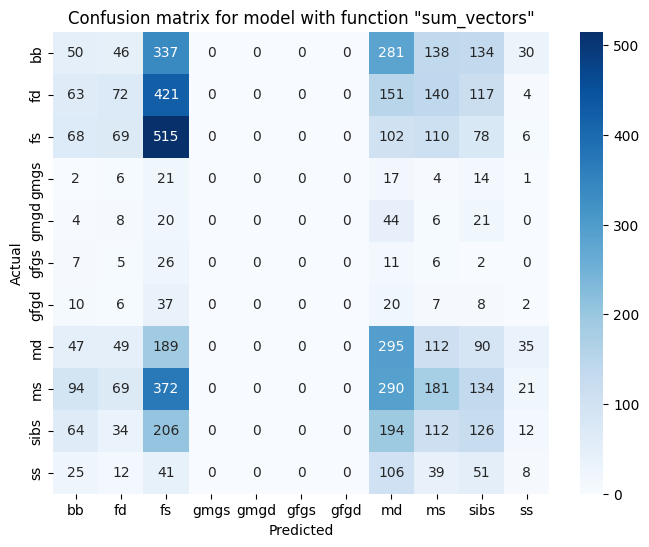

Scores for model with function "prod": train score is 0.9792492254485193, test score is 0.2257394084732214


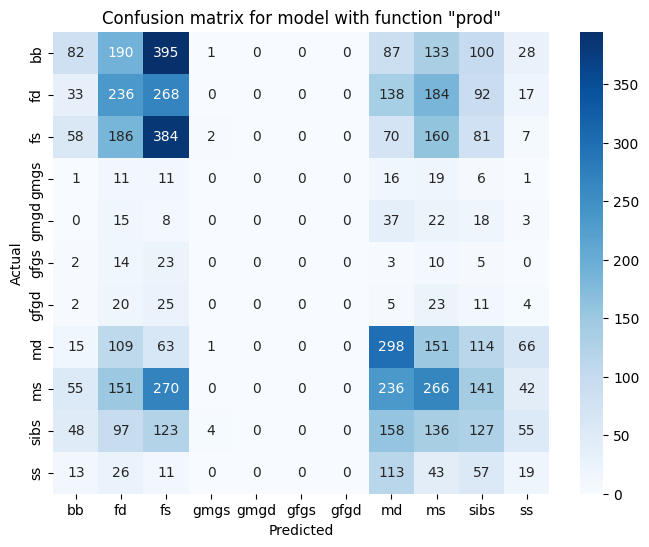

Scores for model with function "diff": train score is 0.956601099983188, test score is 0.26778577138289367


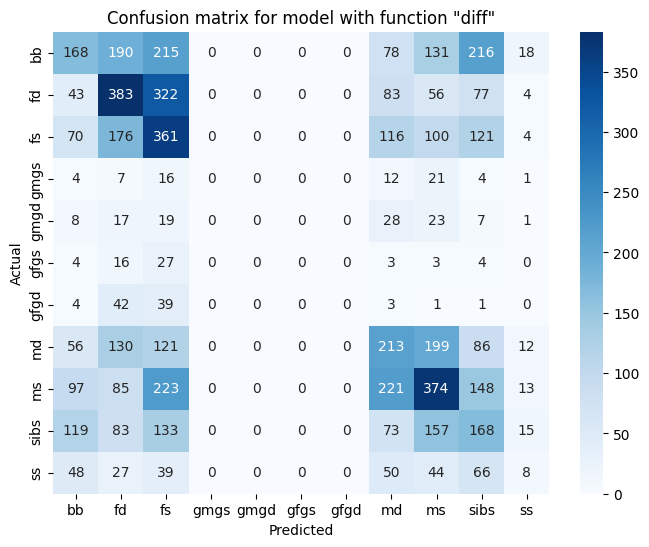

Scores for model with function "squared_sum": train score is 0.725028220092706, test score is 0.2193445243804956


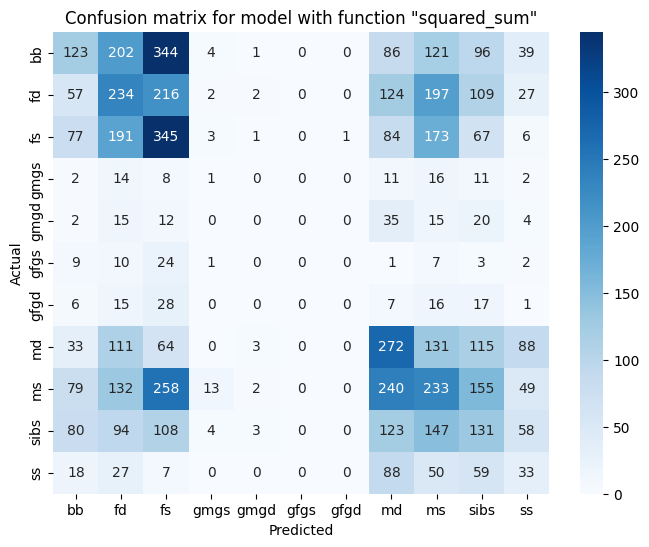

Scores for model with function "squared_diff": train score is 0.9893844417225064, test score is 0.19696243005595523


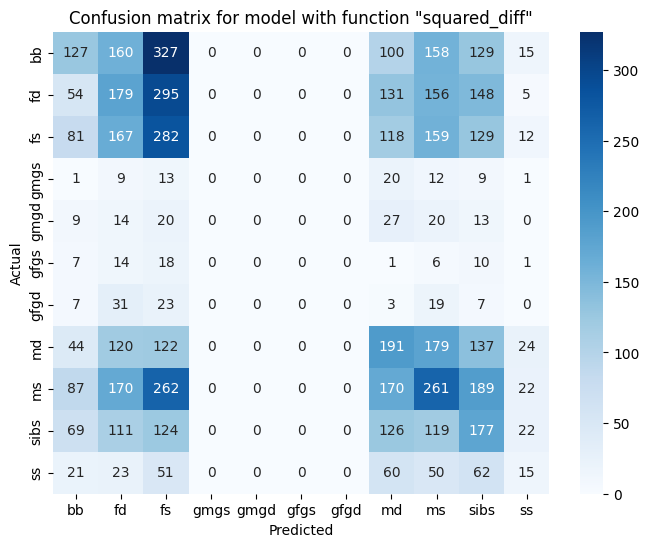

Scores for model with function "sum_squares": train score is 0.5405768907462113, test score is 0.21806554756195043


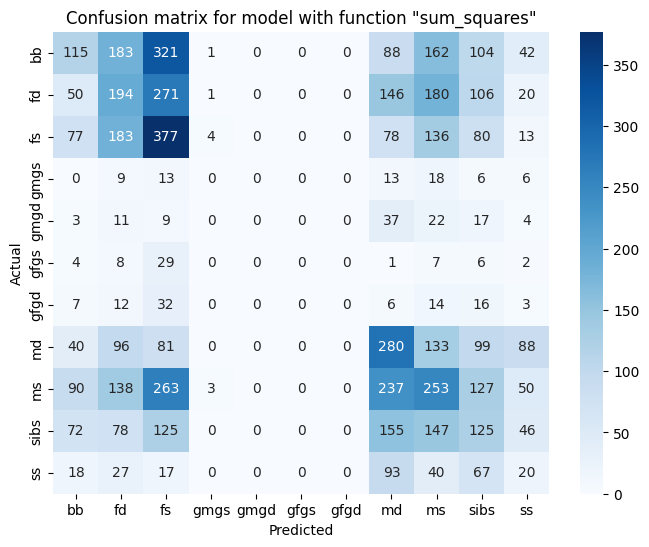

Scores for model with function "diff_squares": train score is 0.7213536037658813, test score is 0.26410871302957634


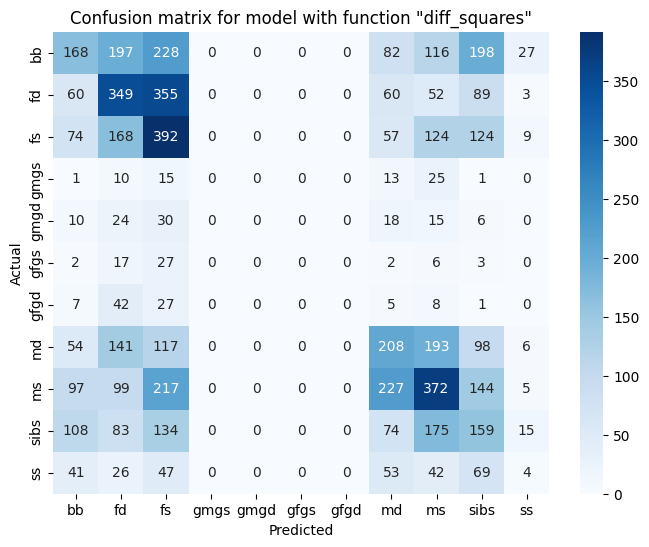

In [96]:
for i, function_name in enumerate(functions.keys()):
  train_score = accuracy_score(train_y, best_models_multiclass[i].predict(features_train_multiclass))
  pred_y = best_models_multiclass[i].predict(features_test_multiclass)
  test_score = accuracy_score(test_y, pred_y)
  print(f"Scores for model with function \"{function_name}\": train score is {train_score}, test score is {test_score}")
  cm = confusion_matrix(test_y, pred_y)
  plt.figure(figsize=(8, 6))
  class_labels = sorted(classes, key=classes.get)
  sns.heatmap(cm, annot=True, cmap='Blues', fmt='d', xticklabels=class_labels, yticklabels=class_labels)
  plt.title(f'Confusion matrix for model with function \"{function_name}\"')
  plt.xlabel('Predicted')
  plt.ylabel('Actual')
  plt.show()

A questo punto, analogamente a quanto fatto nel primo problema, costruiamo i *dataset* che devono essere utilizzati dal modello XGBoost finale, che farà da "ensemble classifier" dei migliori modelli per ciascuna funzione di aggregazione dei dati individuati in precedenza. Una volta fatto, lo addestriamo nello stesso modo in cui abbiamo addestrato il modello finale del primo problema, quindi tarando gli stessi iperparametri scegliendoli tra gli stessi potenziali valori usando la medesima tecnica di "Bayesian Optimization" che in precedenza.

In [97]:
%%capture

features_train_meta_multiclass = \
  np.column_stack([estimator.predict(features_train_multiclass) for estimator in best_models_multiclass])
features_test_meta_multiclass = \
  np.column_stack([estimator.predict(features_test_multiclass) for estimator in best_models_multiclass])

stratified_k_fold = StratifiedKFold(n_splits=3, shuffle=True, random_state=1234)

fit_params = {
    'classifier__sample_weight': weights
}

best_final_model_multiclass, best_final_model_results_multiclass = \
  train_final_model("xgboost_multiclass", base_XGBoost, grid_search_params, features_train_meta_multiclass, train_y, cv=stratified_k_fold, fit_params=fit_params)

In questo caso, l'addestramento del modello finale ha un risultato che indica chiaramente la presenza di *overfitting*, come la sua controparte per il problema binario. Lo *score* è infatti sempre superiore al 98%. Se si vanno ad osservare gli altri parametri, si nota infatti per tutti un comportamento incerto senza tendenze precise. I parametri più "stabili" sono il peso minimo delle foglie, relativamente basso, il parametro "gamma", anch'esso relativamente basso, e il numero di alberi per modello, elevato.

In [98]:
best_final_model_results_multiclass

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__colsample_bytree,param_classifier__gamma,param_classifier__learning_rate,param_classifier__max_depth,param_classifier__min_child_weight,param_classifier__n_estimators,param_classifier__subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.756898,0.023693,0.111081,0.004496,0.446751,4.690933,0.023526,13,7,968,0.428649,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
1,0.801465,0.015248,0.119145,0.008870,0.896809,0.049933,0.358495,4,3,221,0.916784,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
2,0.792212,0.022578,0.122462,0.001068,0.133527,0.034745,0.434118,9,4,834,0.229917,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
3,0.806521,0.024200,0.118055,0.004167,0.063808,8.602232,0.858720,3,2,111,0.876464,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
4,0.795474,0.061391,0.115999,0.007276,0.900542,0.014198,0.878201,2,1,947,0.971248,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.748671,0.037251,0.112448,0.004702,0.289529,0.134227,0.082493,12,6,746,0.158829,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
96,0.749646,0.035916,0.112215,0.004790,0.450492,0.049136,0.202844,10,5,405,0.947753,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
97,0.748452,0.037766,0.112312,0.004431,0.825220,0.032396,0.580115,10,7,537,0.224468,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1
98,0.775797,0.043930,0.120566,0.006138,0.772810,1.553239,0.013923,7,6,543,0.488400,"OrderedDict([('classifier__colsample_bytree', ...",0.971684,0.996542,0.981123,0.983116,0.010246,1


Se si analizza l'accuratezza di quest'ultimo modello, si notano risultati analoghi a quelli dei modelli precedenti: un'accuratezza di *test* attorno al 20% e una di *training* attorno al 99%, chiaro segno di *overfitting*. Le classi più correttamente classificate rimangono le relazioni di parentela "padre-figlio", "madre-figlio", "madre-figlia" e "padre-figlia", che però sono anche le classi dove vengono più classificate istanze estranee. Le classi che riguardano i nonni vengono dal modello completamente ignorate.

Scores for final model: train score is 0.9938756394552921, test score is 0.20367705835331734


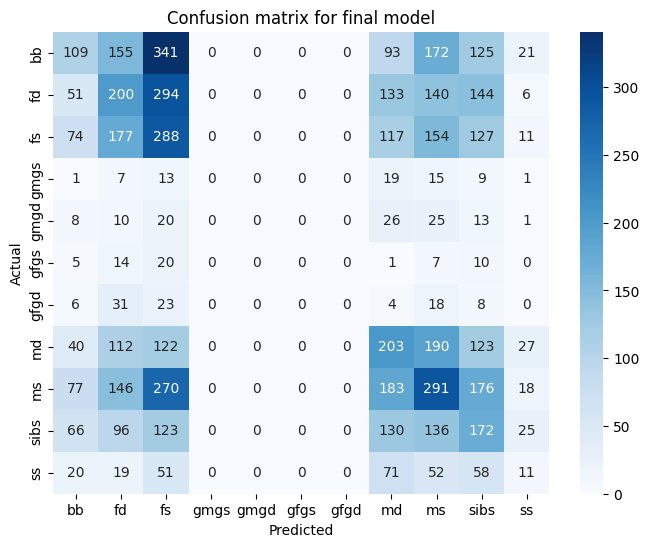

In [99]:
train_score = accuracy_score(train_y, best_final_model_multiclass.predict(features_train_meta_multiclass))
pred_y = best_final_model_multiclass.predict(features_test_meta_multiclass)
test_score = accuracy_score(test_y, pred_y)
print(f"Scores for final model: train score is {train_score}, test score is {test_score}")
cm = confusion_matrix(test_y, pred_y)
plt.figure(figsize=(8, 6))
class_labels = sorted(classes, key=classes.get)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='d', xticklabels=class_labels, yticklabels=class_labels)
plt.title(f'Confusion matrix for final model')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

Vengono predette le probabilità di ciascuna istanza di appartenere a tutte le classi. Successivamente viene filtrata la probabilità di appartenere alla classe corretta corrispondente al valore nel *test set*. Infine, viene calcolata la logistic loss rispetto ai dati reali che corrisponde all'errore commesso nella predizione.

In [100]:
pred_y_proba = best_final_model_multiclass.predict_proba(features_test_meta_multiclass)
test_y_values = test_y.values
pred_y_proba_true_class = pred_y_proba[np.arange(len(test_y_values)), test_y_values]
errors = binary_crossentropy(test_y.values[:, np.newaxis], pred_y_proba_true_class[:, np.newaxis])

Similmente al modello costruito per il primo problema le *feature* meglio rappresentative sono la forma del viso, il colore degli occhi e della pelle. Anche in questo caso la luminosità delle immagini, la loro risoluzione e la posa del volto sembrano ricoprire un ruolo importante per una corretta classificazione.

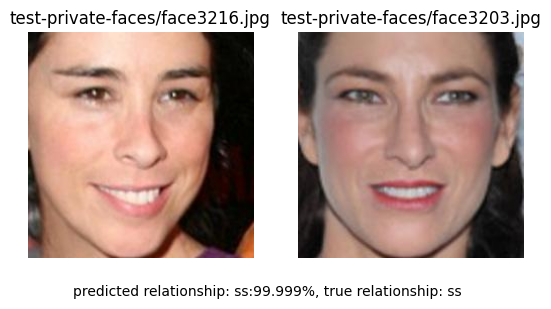

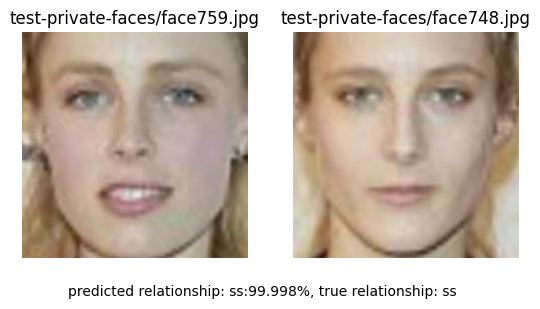

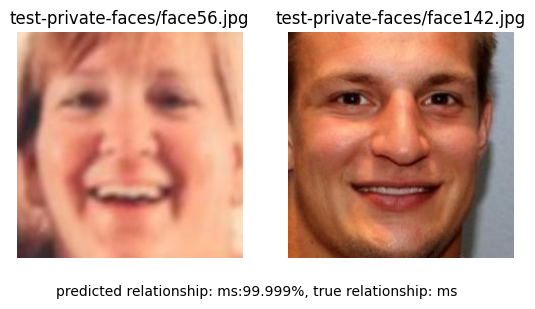

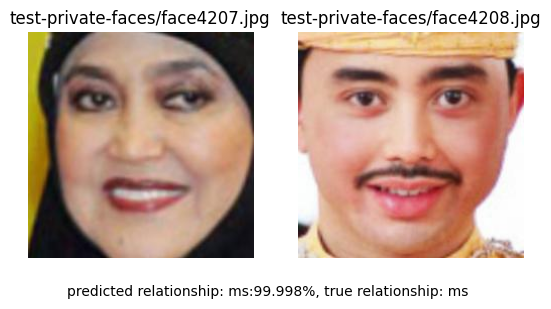

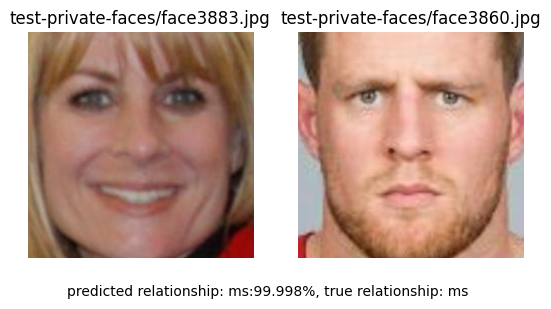

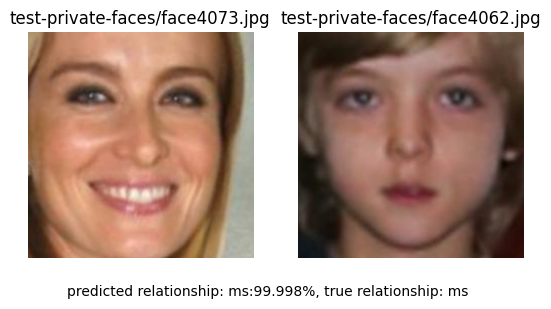

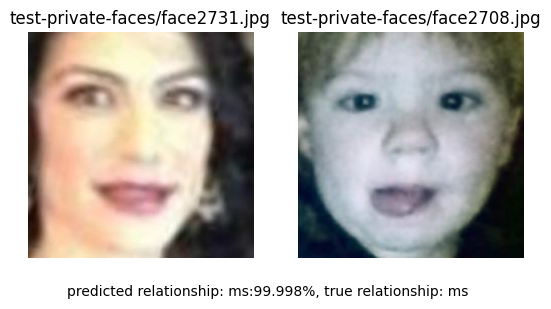

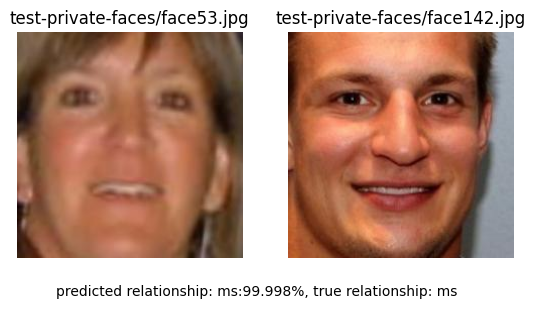

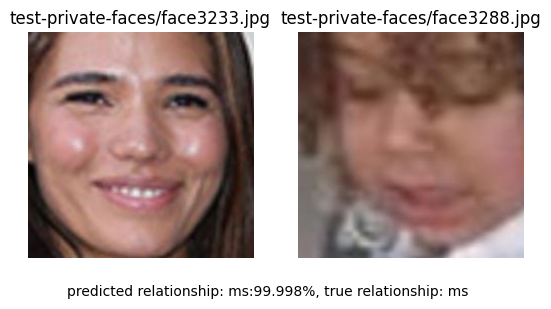

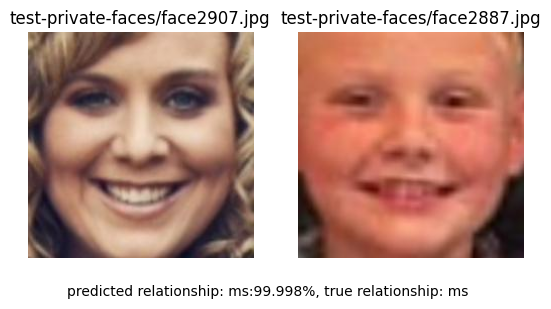

In [101]:
show_tops(pred_y_proba, errors.numpy(), test_multiclass, give_best=True, is_binary=False, top_n=10, classes=classes)

In questo caso peculiari sono le casistiche errate, in cui è presente una grande quantità di bambini. Questo è probabilmente riconducibile alle loro caratteristiche androgine, che rendono difficoltoso distinguere i bambini dalle bambine. Da notare anche il fatto che il modello classifica con più probabilità i volti come maschili, probabilmente perchè gli uomini sono più presenti nel *dataset*. Sicuramente incidono anche le differenze di luminosità, risoluzione e la presenza di immagini con occhi chiusi o socchiusi.

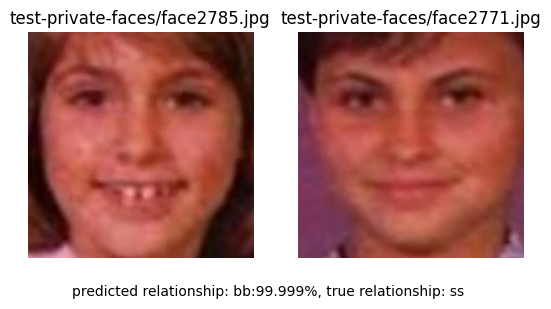

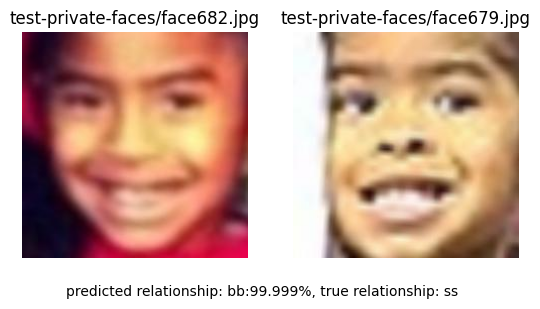

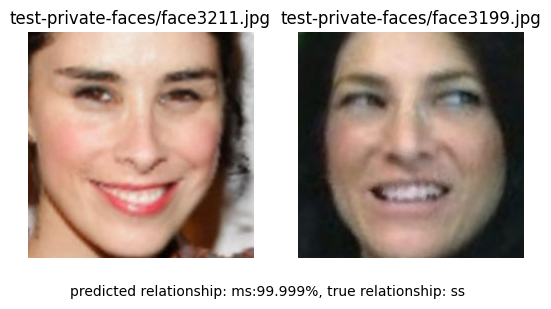

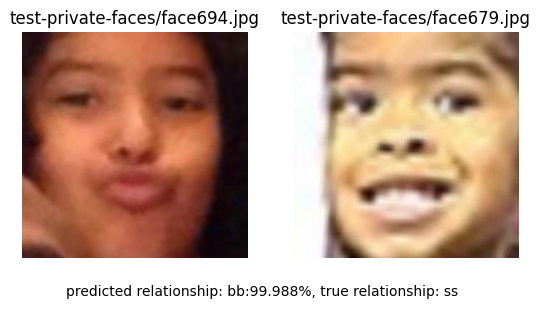

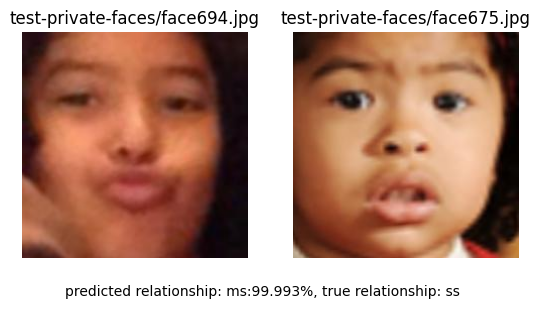

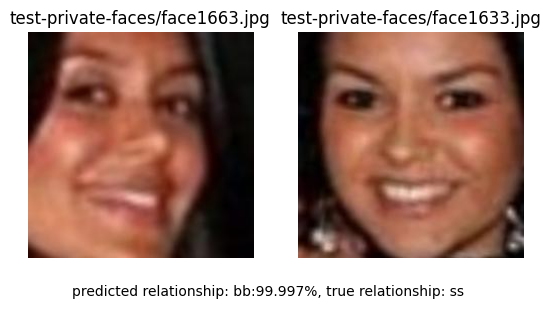

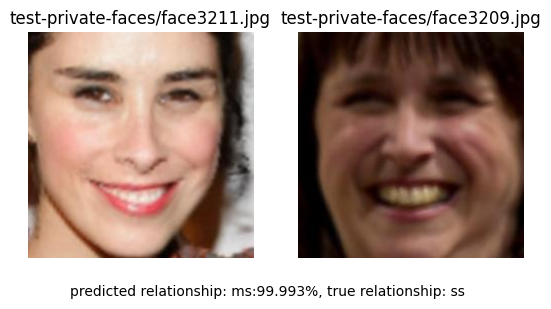

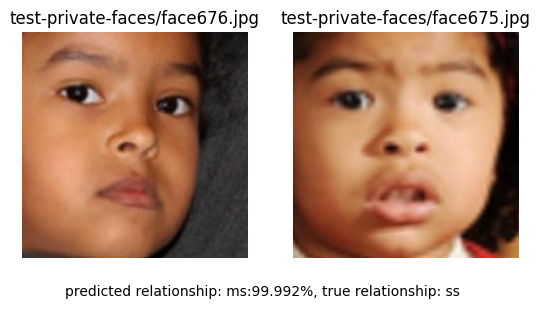

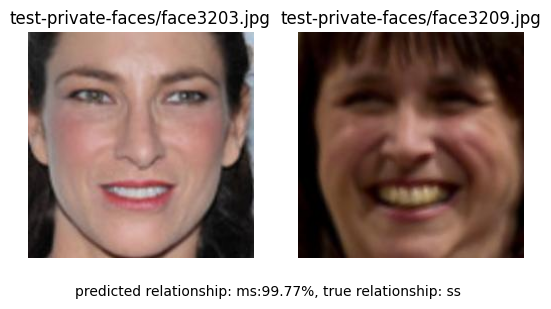

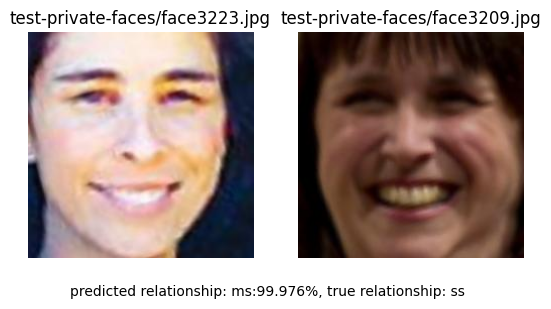

In [102]:
show_tops(pred_y_proba, errors.numpy(), test_multiclass, give_best=False, is_binary=False, top_n=10, classes=classes)

In [103]:
del features_train_binary
del features_train_multiclass
del features_test_binary
del features_test_multiclass
del train_binary
del train_multiclass
gc.collect()

130909

## Classificazione mediante tecniche di Deep Learning

Per la parte di "Representation Learning" abbiamo preso ispirazione dal paper pubblicato nel 2020 [Deep Fusion Siamese Network for Automatic Kinship Verification](https://arxiv.org/pdf/2006.00143.pdf).
La soluzione proposta utilizza una rete siamese in cui si estraggono *feature* dalle immagini in input, si combinano mediante operazioni di fusione per ricavere una metrica di similarità tra di esse. L'uso di questa architettura ci è stato suggerito dalla soluzione del primo classificato della competizione su cui si basa queso progetto.

L'architettura della rete è genericamente rappersentata nella seguente struttura:

<img src="https://drive.google.com/uc?id=1fAUq-R9c2-7XN4R0Q-T1LsF0vSjvCaJh" alt="Alt Text" style="display: block;">

La rete si compone di una parte di *feature extraction* in cui vengono estratte delle *feature* dalle immagini in input utilizzando dei modelli già addestrati, cioè delle reti *backbone*. Da ogni immagine viene estratto un vettore di *feature* il quale viene fuso con il suo corrispondente attraverso diverse operazioni. I vettori fusione risultanti vengono concatenati in un unico vettore che farà da input per i livelli *fully connected* successivi, fino ad arrivare all'ultimo neurone che, grazie alla funzione "sigmoide", restituisce la probabilità che i due volti appartengano alla classe "parenti".   

La nostra versione utilizza l'architettura base proposta nel paper introducendo delle variazioni volte a migliorare le prestazioni in termini di accuratezza, prendendo spunto da quella del primo classificato nella competizione.
Si descrive di seguito l'architettura proposta.

1. Viene definita una funzione `data_augmentation` che prende un'immagine come parametro e vi applica diverse trasformazioni di *data augmentation*. Le trasformazioni includono rotazione, zoom, traslazione, ribaltamento, variazione del contrasto e luminosità in modo casuale. L'output finale di questa funzione è l'immagine sottoposta a tutte queste trasformazioni. Questo costringe la rete ad essere robusta nei confronti delle variazioni indicate precedentemente e inoltre permette di aumentare il numero di istanze del *dataset* fornito in input, dato che sono in numero ridotto. I valori utilizzati nei vari *layer* di *processing* permettono di variare in maniera non trascurabile le immagini di input senza però introdurre varizioni troppo elevate;

2. Vengono generati gli *embedding* per le immagini utilizzando due *backbone* diverse per ciascuna immagine, che abbiamo scelto essere "ResNet-50" e "SeNet-50";

3. Ogni *embedding* viene appiattitito mediante un'operazione di "flattening";

4. Come funzioni di fusione delle *feature* vengono utilizzate le stesse che sono state indicate nella sezione di classificazione tradizionale. Le operazioni includono la somma, la moltiplicazione, la sottrazione, la somma dei quadrati delle componenti, la differenza dei quadrati delle componenti, il quadrato della somma e della differenza delle componenti. Si ottengono così 2 risultati per operazione.

5. Le fusioni vengono sottoposte a un livello *fully connected* di 256 neuroni. Questo serve per ridurre le dimensioni di ogni vettore ottenuto dalla fusione ed introduce anche *layer* addestrabili;

6. I vettori vengono concatenati orizzontalmente formandone uno unico;

7. Il vettore concatenato viene passato attraverso due livelli densi, con 512 e 64 neuroni rispettivamente. Ogni *layer* viene creato con la funzione `dense_layer` che crea un livello denso con il numero specificato di neuroni. Ogni livello ha come funzione di attivazione "ReLU". A questo livello denso seguono un livello di *batch normalization* e uno di *dropout* con una probabilità di 0.1;

8. L'output del secondo livello denso viene passato attraverso il livello di output finale. Se il problema è multiclasse viene utilizzata una funzione di attivazione "softmax" e l'output avrà un numero di neuroni uguale al numero di classi. Altrimenti, viene utilizzata una funzione di attivazione "sigmoide" e l'output sarà un singolo neurone;

9. Viene compilato il modello con una funzione di *loss* appropriata per il tipo di problema, "binary crossentropy" nel caso binario o "categorical crossentropy" nel caso multiclasse, e con Adam come ottimizzatore, usando un *learning rate* molto basso, pari a 0.00001. Questo serve per evitare il fenomeno di "Catastrophic Forgetting" e preservare ciò che la rete ha precedentemente appreso.

Qui di seguito illustriamo l'architettura della nostra rete.

<img src="https://drive.google.com/uc?id=1V12rm1BgcWzvLtLqwX7_td-fdQ1Ycl7y" alt="Alt Text" style="display: block;">

La costruzione del modello avviene tramite la funzione `create_siamese`.

In [104]:
def create_siamese(input_shape, net_1, net_2, classes):

    def data_augmentation(input):
       x = RandomRotation(factor=0.2)(input)
       x = RandomZoom(height_factor=0.2, width_factor=0.2)(x)
       x = RandomTranslation(height_factor=0.2, width_factor=0.2)(x)
       x = RandomFlip(mode='horizontal_and_vertical')(x)
       x = RandomContrast(factor=0.2)(x)
       return RandomBrightness(factor=0.1)(x)


    operations = [
        lambda x,y: x+y,
        lambda x,y: x*y,
        lambda x,y: x - y,
        lambda x,y: K.square(x) + K.square(y),
        lambda x,y: K.square(x) - K.square(y),
        lambda x,y: K.square(x + y),
        lambda x,y: K.square(x - y)
    ]

    def dense_layer(neurons, input, dropout=0.1):
        dense = Dense(neurons)(input)
        batch_normalization = BatchNormalization()(dense)
        activation = Activation('relu')(batch_normalization)
        dropout = Dropout(0.1, seed=1234)(activation)
        return dropout

    image_1 = Input(input_shape)
    image_2 = Input(input_shape)

    augmented_image_1 = data_augmentation(image_1)
    augmented_image_2 = data_augmentation(image_2)

    embedding_net_1_image_1 = Flatten()(net_1(augmented_image_1))
    embedding_net_1_image_2 = Flatten()(net_1(augmented_image_2))
    embedding_net_2_image_1 = Flatten()(net_2(augmented_image_1))
    embedding_net_2_image_2 = Flatten()(net_2(augmented_image_2))

    merged = [operation(*embeddings)
              for operation in operations
              for embeddings in [(embedding_net_1_image_1,embedding_net_1_image_2),
                                 (embedding_net_2_image_1, embedding_net_2_image_2)]]

    reduced = [dense_layer(256, merge) for merge in merged]
    concatenate = Concatenate()(reduced)
    dense_512 = dense_layer(512, concatenate)
    dense_64 = dense_layer(64, dense_512)
    if classes > 2:
        output = Dense(units=classes, activation='softmax')(dense_64)
    else:
        output = Dense(units=1, activation='sigmoid')(dense_64)

    model = Model([image_1, image_2], output)
    model.compile(loss='categorical_crossentropy' if classes > 2 else 'binary_crossentropy',
                  metrics=['accuracy'],
                  optimizer=Adam(0.00001))
    return model

Per il dataset viene creata una classe ad hoc, `FaceDataset`, che estende la classe `Sequence` di Keras. La classe "FaceDataset" è progettata per generare *batch* di dati ed etichette da utilizzare durante l'addestramento. Questa soluzione è stata obbligata dal fatto che le immagini prima di essere date in input alla rete devono essere preprocessate convertendole da un formato `int.8` a `float.32`. Questa conversione causa una saturazione rapida della RAM. Caricando e processando le immagini un *batch* alla volta si evita questa problematica.

1. Nel metodo `__init__`, vengono inizializzati campi della classe, tra cui i dati di input, `self.x_data`, e le etichette, `self.y_data`, l'elenco degli indici, `self.indexes`, la dimensione del *batch*, `self.batch_size` e il numero di classi, `self.n_classes`. Se `is_training` è `True`, viene chiamato il metodo `on_epoch_end` per mescolare i dati;

2. Il metodo `__len__` restituisce la lunghezza del *dataset*, calcolata come il numero di *batch* necessari per completare un epoca di addestramento;

3. Il metodo `__getitem__` restituisce un *batch* di dati e le etichette corrispondenti all'indice specificato. Prende in input l'indice del *batch* da recuperare e seleziona dal vettore `indexes` gli indici di inizio e fine per selezionare gli esempi dal *dataset*. La grandezza del *batch* utilizzato per l'addestramento è di 16 elementi. Le coppie di immagini vengono caricate e pre-processate tramite la funzione `load_image_and_process` e le etichette vengono codificate in "one-hot encoding" se il problema è multiclasse. Ogni canale di ciascuna immagine necessita di essere adeguato rispetto a come i modelli sono stati addestrati. Per fare questo, la libreria "keras_vggface" mette a disposizione la funzione `preprocess_input` che centra ciascun canale sullo 0 rispetto all'insieme di dati su cui i modelli sono stati addestrati;

4. Il metodo `on_epoch_end` viene chiamato alla fine di ogni epoca durante l'addestramento. Randomizza l'ordine degli indici degli esempi nel *dataset* utilizzando la funzione `random.shuffle`.

In [105]:
def load_image_and_process(image_path):
  image = cv.imread(image_path)
  if image is None:
    raise Exception("Failed to load image: {}".format(image_path))
  else:
    return preprocess_input(image.astype(np.float32), version=2)

class FaceDataset(Sequence):
  def __init__(self, data_x, data_y, images_folder, batch_size, classes, is_training):
    self.x_data = data_x.values
    self.y_data = data_y.values
    self.indexes = list(range(len(self.x_data)))
    self.batch_size = batch_size
    self.n_classes = classes
    self.images_folder = images_folder
    if is_training:
      self.on_epoch_end()

  def __len__(self):
    return int(np.ceil(len(self.x_data) / self.batch_size))

  def __getitem__(self, index):
    start_idx = index * self.batch_size
    end_idx = min(start_idx + self.batch_size, len(self.x_data))
    images_1 = []
    images_2 = []
    labels = []

    for i in self.indexes[start_idx:end_idx]:
      partial_path_1, partial_path_2 = self.x_data[i]
      label = self.y_data[i]
      path_1 = f"{self.images_folder}/{partial_path_1}"
      path_2 = f"{self.images_folder}/{partial_path_2}"
      images_1.append(load_image_and_process(path_1))
      images_2.append(load_image_and_process(path_2))

      if self.n_classes > 2:
        labels.append(to_categorical(label, num_classes=self.n_classes))
      else:
        labels.append(label)

    return [np.array(images_1), np.array(images_2)], np.array(labels)

  def on_epoch_end(self):
    random.shuffle(self.indexes)

I modelli utilizzati come *backbone* della rete sono "ResNet-50" e "SeNet-50" addestrati sul dataset "[VGGFace2](https://ieeexplore.ieee.org/document/8373813)". Il dataset contiene 3.31 milioni di immagini di 9131 soggetti diversi, con una media di 362.6 immagini per soggetto. Le immagini derivano da "Google Image Search" e hanno una grande varietà di pose, età, illuminazioni, etnie e professioni (e.g. attori, atleti, politici).

Di queste reti si utilizza solamente la parte convoluzionale, ottenuta specificando `include_top=False`. Inoltre, svolgendo diversi test abbiamo ottenuto migliori risultati impostando tutti i layer delle reti a `trainable = True`. Le due reti accettano immagini di dimensione 224x224x3, quindi le immagini del *dataset* non necessitano di un ridimensionamento.


In [106]:
def create_resnet():
  resnet = VGGFace(model='resnet50', include_top=False)
  resnet.trainable = True
  return resnet

def create_senet():
  senet = VGGFace(model='senet50', include_top=False)
  senet.trainable = True
  return senet

Ora vengono caricati i *dataframe* corrispondenti a *train set* e *test set* del primo problema. Come *validation set* si è deciso di utilizzare tutte le relazioni rappresentate da immagini i cui percorsi dei file iniziano per `F09`.



In [107]:
full_train_binary_dataframe = pd.read_csv(f'labels/train_binary.csv')
filter_condition = full_train_binary_dataframe['p1'].str.contains('F09') | full_train_binary_dataframe['p2'].str.contains('F09')
train_binary_dataframe = full_train_binary_dataframe[~filter_condition]
validation_binary_dataframe = full_train_binary_dataframe[filter_condition]
test_binary_dataframe = pd.read_csv(f'labels/test_binary.csv')

full_trainset_size = len(full_train_binary_dataframe)
trainset_size = len(train_binary_dataframe)
validation_size = len(validation_binary_dataframe)
validation_percentage = round(validation_size * 100 / full_trainset_size)
trainset_percentage = round(trainset_size * 100 / full_trainset_size)
print(f'Grandezza trainset: {trainset_size}, {trainset_percentage}% of full trainset')
print(f'Grandezza validation: {validation_size}, {validation_percentage}% of full trainset')

Grandezza trainset: 465132, 84% of full trainset
Grandezza validation: 89210, 16% of full trainset


Poi si utilizzano i *dataframe* sopra istanziati per creare con la classe `FaceDataset` delle strutture dati processabili da "Keras". Solamente per `train_binary_dataset` e `validation_binary_dataset` viene impostata il parametro `is_training` a `True` in modo che durante l'addestramento i dati vengano mescolati.

In [108]:
full_train_binary_dataset = FaceDataset(data_x=full_train_binary_dataframe.drop(columns='label'),
                                        data_y=full_train_binary_dataframe['label'],
                                        images_folder='train-faces',
                                        batch_size=256,
                                        classes=2,
                                        is_training=False)
train_binary_dataset = FaceDataset(data_x=train_binary_dataframe.drop(columns='label'),
                                   data_y=train_binary_dataframe['label'],
                                   images_folder='train-faces',
                                   batch_size=16,
                                   classes=2,
                                   is_training=True)
validation_binary_dataset = FaceDataset(data_x=validation_binary_dataframe.drop(columns='label'),
                                        data_y=validation_binary_dataframe['label'],
                                        images_folder='train-faces',
                                        batch_size=16,
                                        classes=2,
                                        is_training=True)
test_binary_dataset = FaceDataset(data_x=test_binary_dataframe.drop(columns='label'),
                                  data_y=test_binary_dataframe['label'],
                                  images_folder='test-private-faces',
                                  batch_size=256,
                                  classes=2,
                                  is_training=False)

La funzione `train_model` crea un'istanza della rete siamese nel caso non fosse presente una cartella contenente una versione precedentemente salvata. Vengono anche utilizzate diverse *callback* per l'addestramento:
1. `EarlyStopping` serve per fermare preventivamente l'addestramento in caso non ci fosse un migliramento dell'accuratezza sul *validation set* per un numero di epoche specificato dal parametro `patience`, in questo caso posto a 10;
2. `ModelCheckpoint` salva il modello se quest'ultimo ottiene uno *score* sul *validation* maggiore del precedente salvato;
3. `ReduceLROnPlateau` riduce il learning rate di un fattore dato dal parametro `factor` dopo un numero `patience` di epoche se non ci sono stati miglioramenti nell'accuratezza sul *validation set*.

La funzione restituisce il modello addestrato o caricato e la sua *history* nel primo caso, altrimenti `None`.

In [109]:
def train_model(model_path, train_dataset, validation_dataset, epochs=100, classes=2, class_weights=None):
  if not os.path.exists(model_path):
    senet = create_senet()
    resnet = create_resnet()
    siamese = create_siamese((224, 224, 4), senet, resnet, classes=classes)

    callbacks = [
        EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True),
        ModelCheckpoint(model_path, monitor='val_accuracy', save_best_only=True),
        ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=5)
    ]

    history = siamese.fit(train_dataset,
                          validation_data=validation_dataset,
                          class_weight=class_weights,
                          epochs=100,
                          callbacks=callbacks)
    return siamese, history
  else:
    model = load_model(model_path)
    print(f"Modello Keras caricato da \'{model_path}\'")
    return model, None

Viene effettuato l'addestramento e viene graficata la sua *history* o, se fosse presente la *cache* del modello, viene caricato il modello.



In [110]:
keras_binary, history = train_model('keras_binary', train_binary_dataset, validation_binary_dataset)
if history is not None:
  plot_history(history)

Modello Keras caricato da 'keras_binary'


Vengono calcolate o caricate, se precedentemente salvate, le predizioni su *train* e *test set*. Questo viene fatto perchè i tempi di predizione sono molto lunghi e si è preferito costruirne una *cache*.



In [111]:
if not os.path.exists('keras_predictions'):
  train_binary_predictions = keras_binary.predict(full_train_binary_dataset)
  test_binary_predictions = keras_binary.predict(test_binary_dataset)
else:
  train_binary_predictions = load_binary('keras_predictions/keras_train_binary_predictions.bin')
  test_binary_predictions = load_binary('keras_predictions/keras_test_binary_predictions.bin')

Si utilizza la funzione `show_model_scores` per mostrare gli *score* della rete addestrata su *train* e *test set* e per disegnare la *confusion matrix*. Una delle prime cose che è possibile notare è il deciso miglioramento rispetto ai modelli di XGBoost. Lo *score* sul *test set* è infatti del 63%, rispetto al 53% della sua controparte tradizionale, segno che in questo caso la rete è stata capace di apprendere delle caratteristiche salienti. In più, osservando l'accuratezza sul *train set*, che è del 75%, notiamo come l'*overfitting* sia rimasto decisamente contenuto. Questi ottimi risultati sono confermati infatti dalla *confusion matrix*, che mostra sulla diagonale un numero molto elevato di veri positivi e veri negativi. Si può anche osservare come, nonostante la classe dei negativi nel *training set* fosse la più numerosa, il modello ha imparato a predire nella maggior parte dei casi un'istanza come della classe dei positivi, segno che non sta "tirando a caso" avendo imparando la distribuzione dei *pattern*.


Scores for model binary train score is 0.749461523752485, test score is 0.6297993237430224


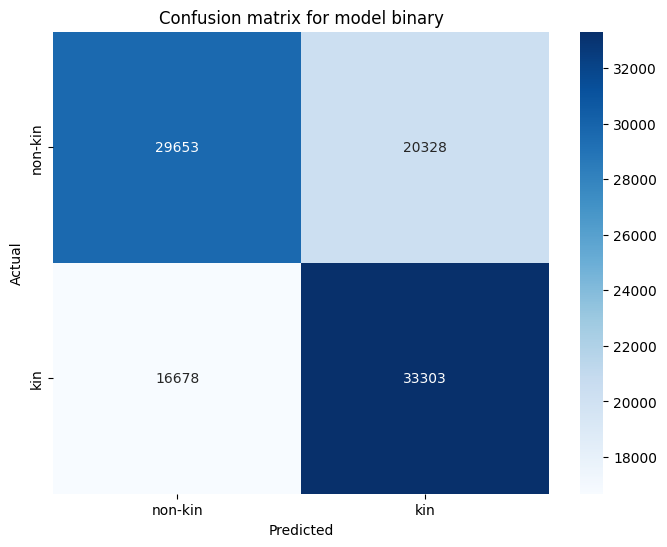

In [112]:
show_model_scores(train_pred=train_binary_predictions,
                  train_y=full_train_binary_dataframe['label'],
                  test_pred=test_binary_predictions,
                  test_y=test_binary_dataframe['label'],
                  is_binary=True)

Qui di seguito calcoliamo l'errore commesso su tutte le istanze del *test set*.

In [113]:
errors = binary_crossentropy(test_binary_dataframe[['label']], test_binary_predictions)

Fatto questo, possiamo mostrare tramite la funzione `show_tops` quei casi in cui la rete ha dato i migliori risultati in assoluto, secondo l'errore, in ordine decrescente. Come si può notare, la rete è stata in grado di considerare tutte le *feature* facciali presenti nelle immagini. Infatti, negli esempi mostrati si può vedere come persone dal profilo asiatico, con occhi a mandorla e nasi più schiacciati, non vengano mai associate con legami di parentela a persone dal profilo caucasico, nemmeno quando queste potrebbero avere alcune caratteristiche simili, come gli occhi più stretti. Più in generale, la rete è stata capace di associare persone che possiedono volti simili tra di loro, come ad esempio persone che hanno le stesse sopracciglia, lo stesso naso, la stessa forma della bocca, anche quando queste si trovano in pose differenti: un volto può sorridere e l'altro no, ma questo non pregiudica il riconoscimento del legame di parentela. Infine, la rete è stata capace di trovare legami di parentela anche utilizzando immagini in bianco e nero, prescindendo dalle *feature* di colore.




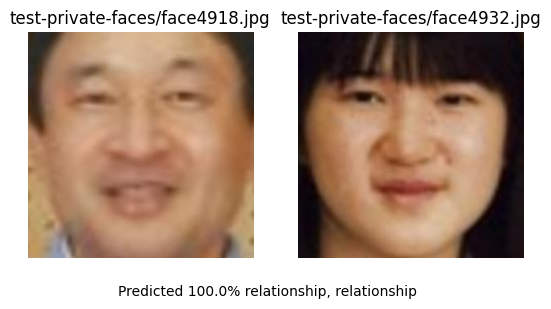

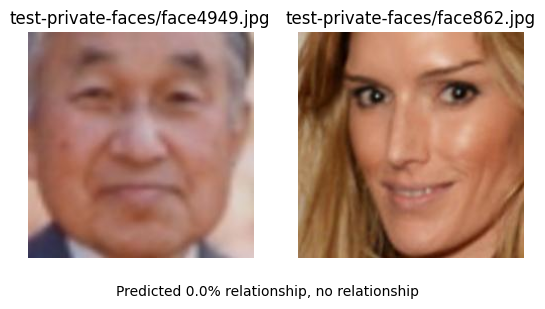

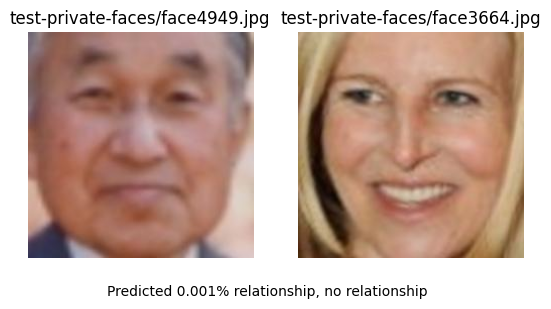

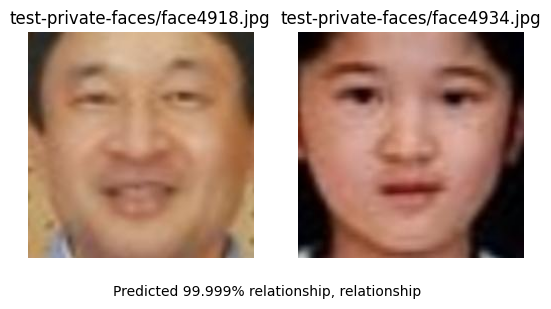

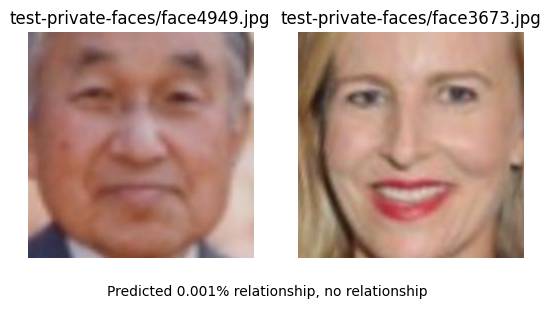

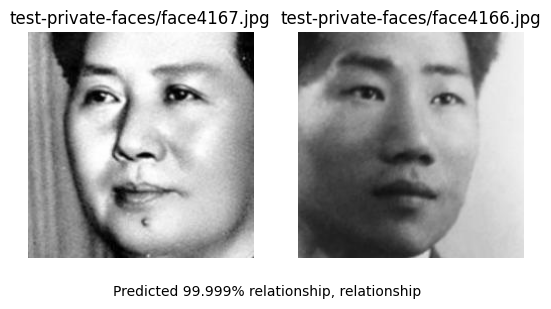

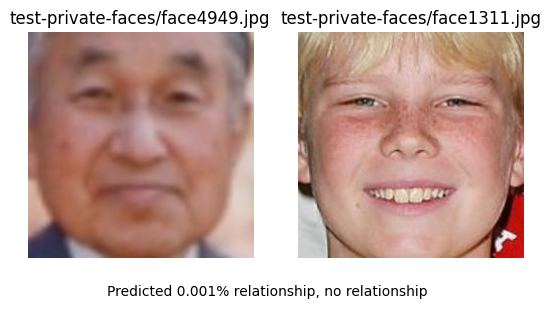

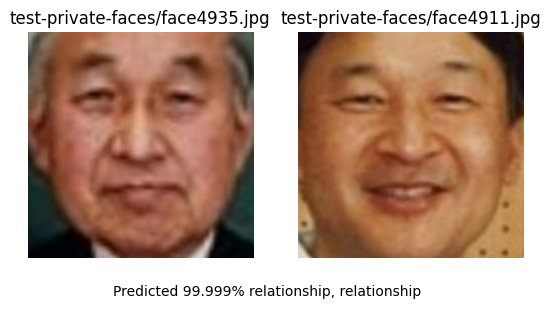

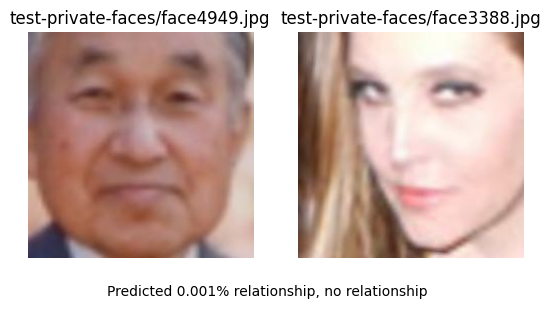

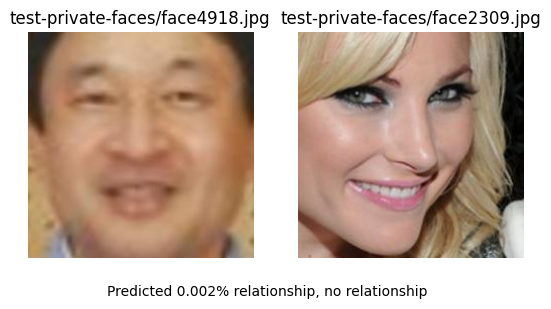

In [114]:
show_tops(test_binary_predictions.flatten(), errors.numpy(), test_binary_dataframe, give_best=True, is_binary=True, top_n=10)

Allo stesso modo vengono mostrati con la funzione `show_tops` i casi in cui la rete ha dato i peggiori risultati in assoluto in ordine decrescente. Dai risultati si può osservare come le caratteristiche che hanno ingannato il classificatore sono state la presenza di occhiali da sole o da vista, volti con smorfie, volti che hanno caratteristiche molto simili tra loro in termini di naso, sopracciglia, labbra, bocca. Un'ultima caratteristica che si può riscontrare nelle immagini che rende difficile la classificazione è la bassa risoluzione delle stesse. È evidente come molte istanze siano difficilmente classificabili anche per un essere umano.

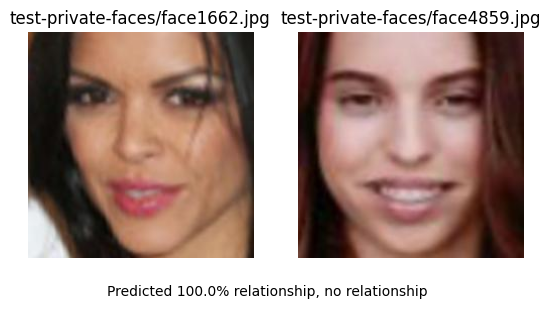

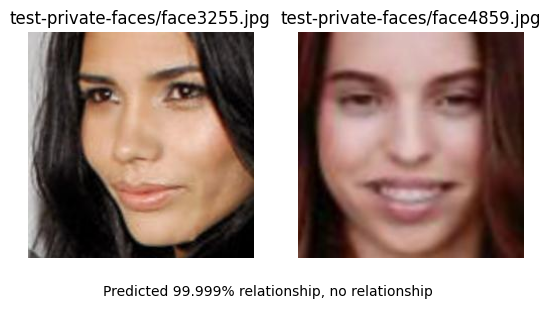

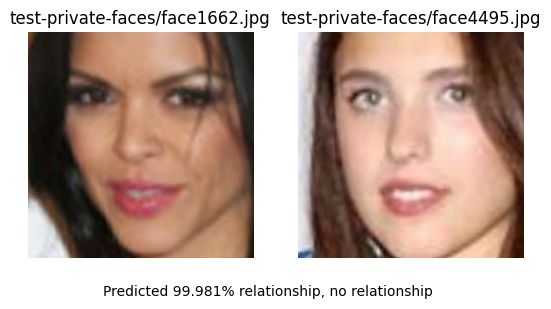

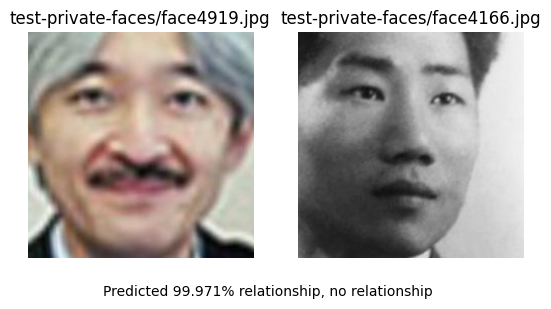

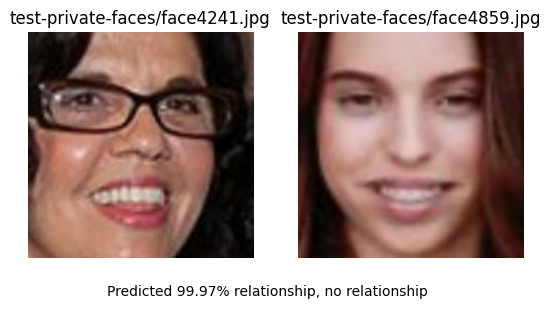

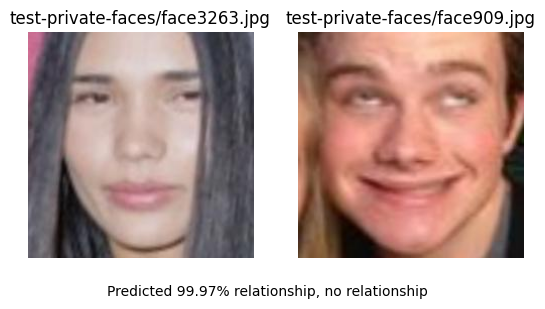

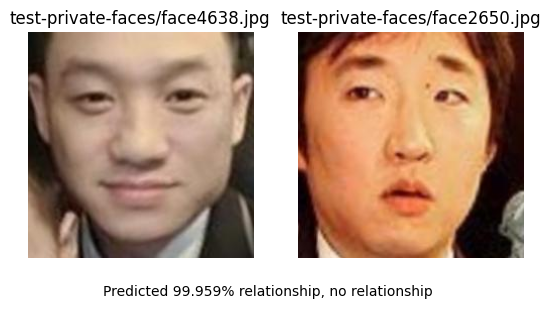

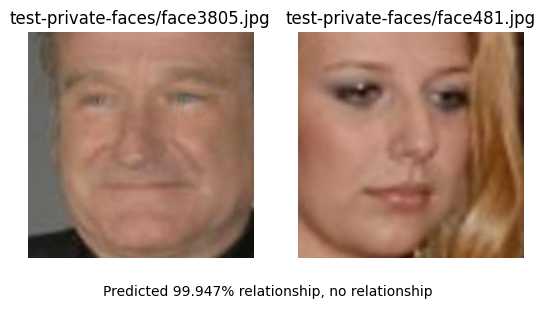

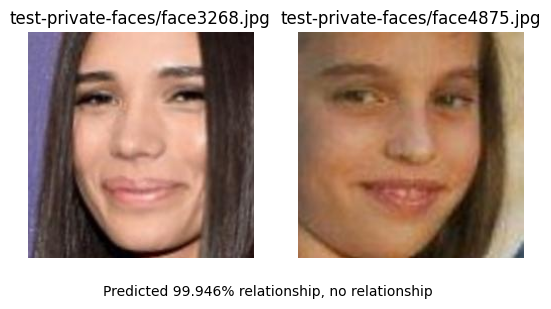

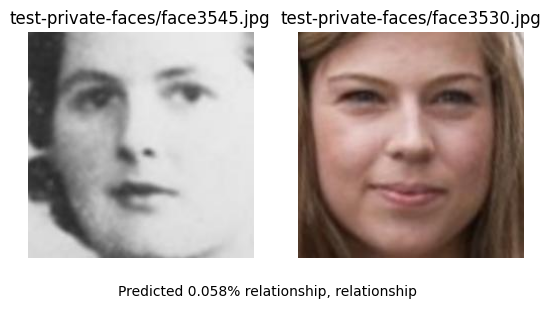

In [115]:
show_tops(test_binary_predictions.flatten(), errors.numpy(), test_binary_dataframe, give_best=False, is_binary=True, top_n=10)

Ora vengono caricati i *dataframe* corrispondenti a *train set* e *test set* del secondo problema. Come *validation set* si è deciso di utilizzare tutte le relazioni rappresentate da immagini i cui percorsi dei file iniziano per `F09`.

In [116]:
full_train_multiclass_dataframe = pd.read_csv(f'labels/train_multiclass.csv')
filter_condition = full_train_multiclass_dataframe['p1'].str.contains('F09') | full_train_multiclass_dataframe['p2'].str.contains('F09')
train_multiclass_dataframe = full_train_multiclass_dataframe[~filter_condition]
validation_multiclass_dataframe = full_train_multiclass_dataframe[filter_condition]
test_multiclass_dataframe = pd.read_csv(f'labels/test_multiclass.csv')

full_trainset_size = len(full_train_multiclass_dataframe)
trainset_size = len(train_multiclass_dataframe)
validation_size = len(validation_multiclass_dataframe)
validation_percentage = round(validation_size * 100 / full_trainset_size)
trainset_percentage = round(trainset_size * 100 / full_trainset_size)
print(f'Grandezza trainset: {trainset_size}, {trainset_percentage}% of full trainset')
print(f'Grandezza validation: {validation_size}, {validation_percentage}% of full trainset')

Grandezza trainset: 218871, 79% of full trainset
Grandezza validation: 58300, 21% of full trainset


Poi si utilizzano i *dataframe* sopra istanziati per creare con la classe `FaceDataset` delle strutture dati processabili da "Keras". Solamente per `train_multiclass_dataset` e `validation_multiclass_dataset` viene impostata il parametro `is_training` a `True` in modo che durante l'addestramento i dati vengano mescolati.

In [117]:
full_train_multiclass_dataset = FaceDataset(data_x=full_train_multiclass_dataframe.drop(columns='relation'),
                                            data_y=full_train_multiclass_dataframe['relation'],
                                            images_folder='train-faces',
                                            batch_size=64,
                                            classes=2,
                                            is_training=False)
train_multiclass_dataset = FaceDataset(data_x=train_multiclass_dataframe.drop(columns='relation'),
                                       data_y=train_multiclass_dataframe['relation'],
                                       images_folder='train-faces',
                                       batch_size=16,
                                       classes=2,
                                       is_training=True)
validation_multiclass_dataset = FaceDataset(data_x=validation_multiclass_dataframe.drop(columns='relation'),
                                            data_y=validation_multiclass_dataframe['relation'],
                                            images_folder='train-faces',
                                            batch_size=16,
                                            classes=2,
                                            is_training=True)
test_multiclass_dataset = FaceDataset(data_x=test_multiclass_dataframe.drop(columns='relation'),
                                      data_y=test_multiclass_dataframe['relation'],
                                      images_folder='test-private-faces',
                                      batch_size=64,
                                      classes=2,
                                      is_training=False)

In questo  caso vengono calcolati i pesi di ciascuna classe in base alla sua frequenza nel *training set*: alle classi le cui istanze hanno frequenza maggiore viene attribuito un peso minore.

In [118]:
classes_list = np.unique(train_multiclass_dataframe['relation'])
n_classes = len(classes_list)
class_weights = compute_class_weight('balanced', classes=classes_list, y=train_multiclass_dataframe['relation'])
class_weights_dict = dict(enumerate(class_weights))
class_weights_dict

{0: 0.9836058943281248,
 1: 0.5743213634395623,
 2: 0.44956649803121707,
 3: 10.193321535022354,
 4: 14.428835124266596,
 5: 11.993588689791222,
 6: 14.971680689513647,
 7: 0.6405486796627382,
 8: 0.45783165293059447,
 9: 0.877579660228626,
 10: 1.2264910088370606}

Viene effettuato l'addestramento e viene graficata la sua *history* o, se fosse presente la *cache* del modello, viene caricato il modello. Questa volta però viene impostato un numero di classi superiori a 2 attraverso il parametro `classes` in quanto ci troviamo di fronte ad un problema multiclasse. Vengono passati anche i pesi `class_weights` calcolati in precedenza tramite l'omonimo parametro.

In [119]:
keras_multiclass, history = train_model('keras_multiclass', train_binary_dataset, validation_binary_dataset, classes=n_classes, class_weights=class_weights_dict)
if history is not None:
  plot_history(history)

Modello Keras caricato da 'keras_multiclass'


Vengono calcolate o caricate, se precedentemente salvate, le predizioni su *train* e *test set*. Questo viene fatto perchè i tempi di predizione sono molto lunghi e si è preferito costruirne una *cache*.

In [120]:
if not os.path.exists('keras_predictions'):
  train_multiclass_predictions = keras_multiclass.predict(full_train_multiclass_dataset)
  test_multiclass_predictions = keras_multiclass.predict(test_multiclass_dataset)
else:
  train_multiclass_predictions = load_binary('keras_predictions/keras_train_multiclass_predictions.bin')
  test_multiclass_predictions = load_binary('keras_predictions/keras_test_multiclass_predictions.bin')

Si utilizza la funzione `show_model_scores` per mostrare gli score della rete addestrata su *train* e *test set* e per disegnare la *confusion matrix*. Una delle prime cose che è possibile notare è il deciso miglioramento rispetto ai modelli di "XGBoost". Lo *score* sul *test set* è infatti del 61%, rispetto al 20% della sua controparte tradizionale, segno che in questo caso la rete è stata capace di apprendere delle caratteristiche salienti. In più, osservando l'accuratezza sul *train set*, che è del 81%, notiamo come l'*overfitting* sia rimasto più contenuto. Questi risultati sono confermati infatti dalla *confusion matrix*, che mostra sulla diagonale un numero elevato di istanze classificate correttamente. Si nota come il modello riesca a classificare correttamente anche una piccola porzione delle relazioni con dei nonni, cosa che la soluzione tradizionale non era riuscita a fare. L'errore più frequente è quello commesso classificando le istanze di "fratelli" come istanze della classe "padre-figlio", probabilmente dovuto alla maggioranza del genere maschile nel *dataset* e ad una somiglianza tra queste due classi. Altri errori comuni sono quelli che vedono scambiate le classi "madre-figlio" con quella "madre-figlia" e quelli che vedono scambiate la classe "padre-figlio" con quella "padre-figlia". Questo sospettiamo sia dovuto alla all'aspetto androgino dei bambini in tenera età. Altri errori meno significativi coninvolgono la difficoltà del modello nello stabilire le relazioni di età di genere per alcune classi.

Scores for model multiclass train score is 0.8166474847657222, test score is 0.6120725875832816


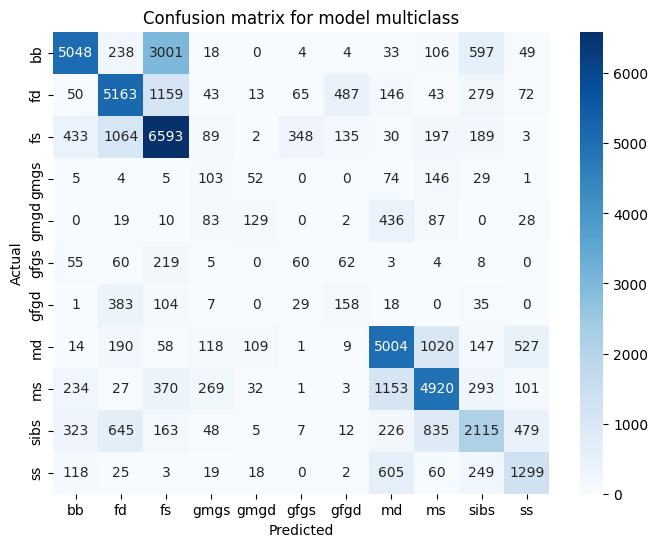

In [121]:
with open("labels/class_encoding.json") as f:
  classes = json.load(f)

show_model_scores(train_pred=train_multiclass_predictions,
                  train_y=full_train_multiclass_dataframe['relation'],
                  test_pred=test_multiclass_predictions,
                  test_y=test_multiclass_dataframe['relation'],
                  is_binary=False,
                  classes=classes)

Qui di seguito calcoliamo l'errore commesso su tutte le istanze del *test set*.

In [122]:
test_y_values = test_multiclass_dataframe['relation']
one_hot_y = to_categorical(test_y_values, num_classes=n_classes)
errors = categorical_crossentropy(one_hot_y, test_multiclass_predictions)

Fatto questo, possiamo mostrare tramite la funzione `show_tops` quei casi in cui la rete ha dato i migliori risultati in assoluto, secondo l'errore, in ordine decrescente. Come si può notare, la rete è stata in grado di considerare tutte le *feature* facciali presenti nelle immagini, in quanto riesce a funzionare correttamente anche in caso di occlusioni parziali del volto. Più in generale, la rete è stata capace di associare persone che possiedono volti simili tra di loro, come ad esempio persone che hanno le stesse sopracciglia, lo stesso naso, la stessa forma della bocca, anche quando queste si trovano in pose differenti: un volto può sorridere e l'altro no, ma questo non pregiudica il riconoscimento del legame di parentela. Infine, la rete è stata capace di trovare legami di parentela anche utilizzando immagini in bianco e nero o in bassa risoluzione, prescindendo dalle *feature* di colore o dai dettagli.

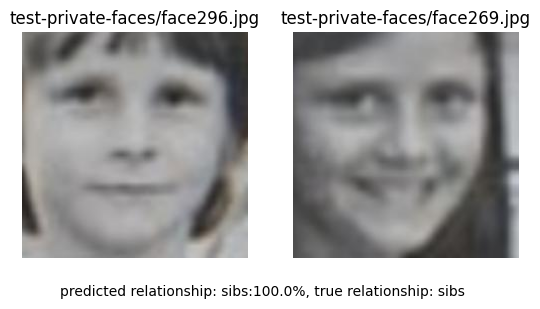

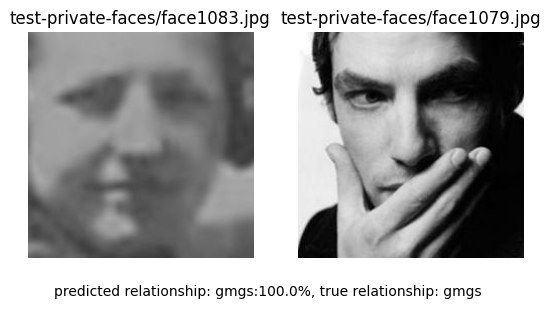

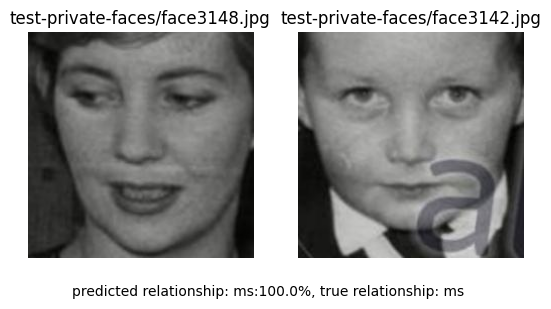

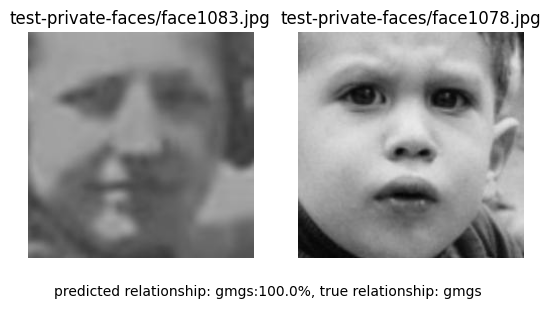

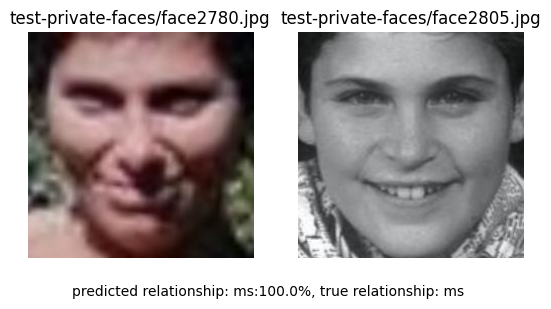

...

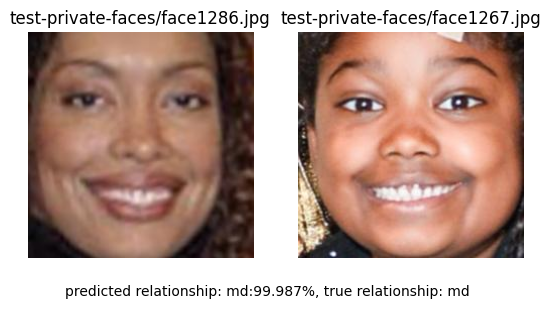

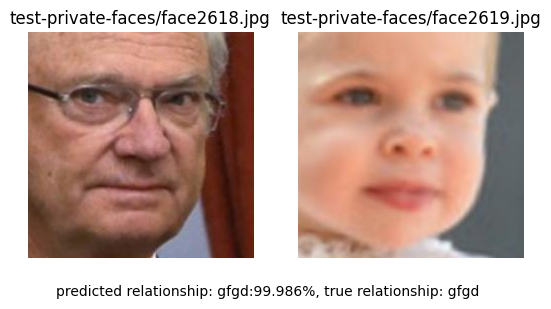

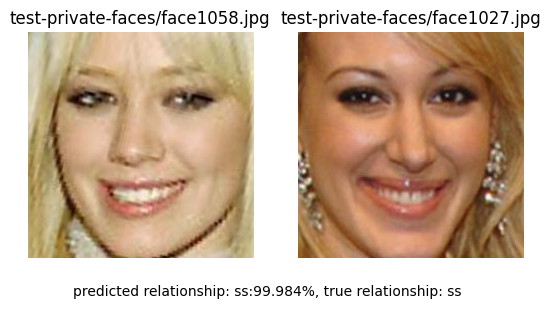

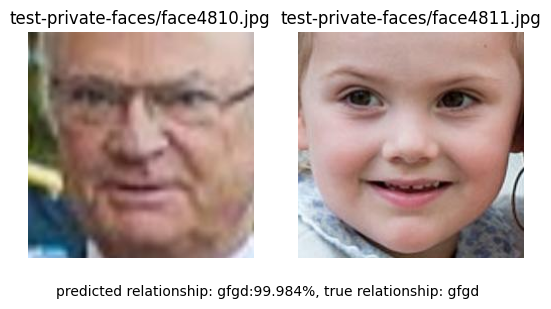

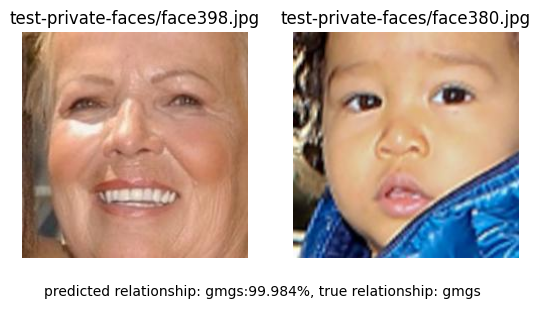

In [123]:
show_tops(test_multiclass_predictions, errors.numpy(), test_multiclass_dataframe, give_best=True, is_binary=False, top_n=50, classes=classes)

Vengono mostrati con la funzione `show_tops` quei casi in cui la rete ha dato i peggiori risultati in assoluto, secondo l'errore, in ordine decrescente. In questo caso si può notare come la rete abbia sbagliato su istanze "*borderline*", cioè immagini particolarmente in bassa risoluzione e anche in bianco e nero. Gli errori riscontrati sono in accordo con i risultati che emergono dalla *confusion matrix*. Talvolta la rete individua una classe simile a quella reale, ma sbaglia le relazioni di età tra i volti o il genere della persona.

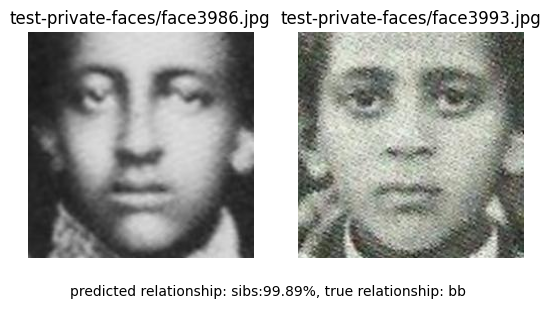

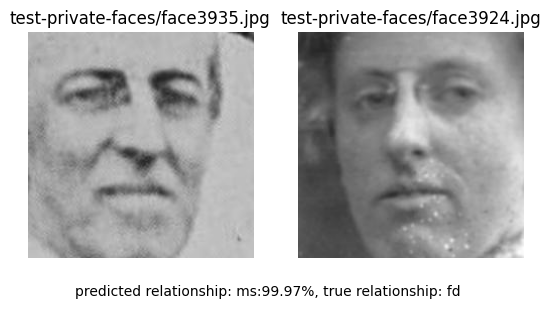

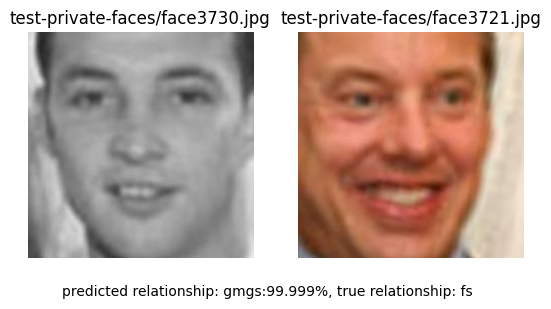

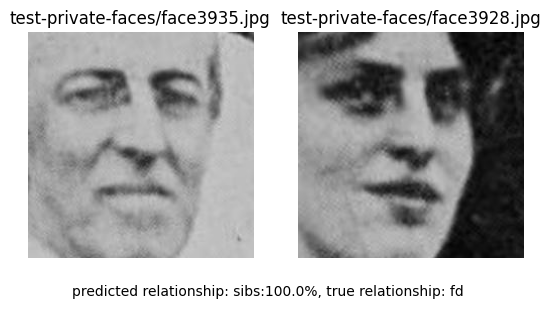

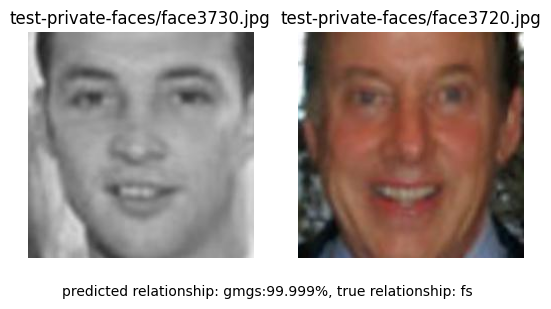

...

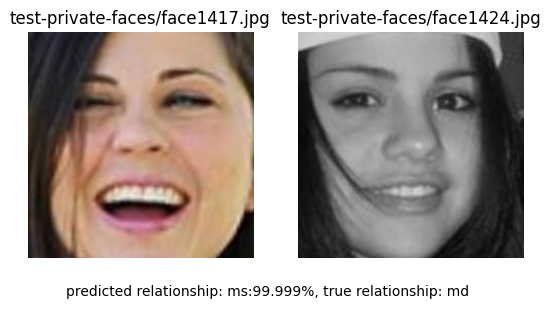

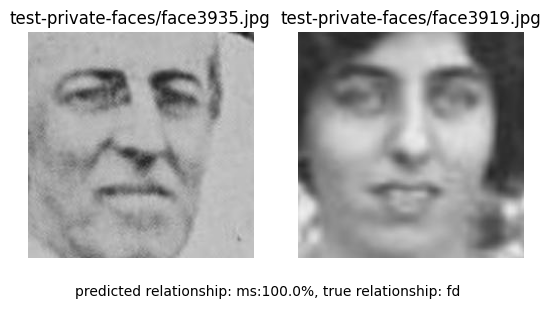

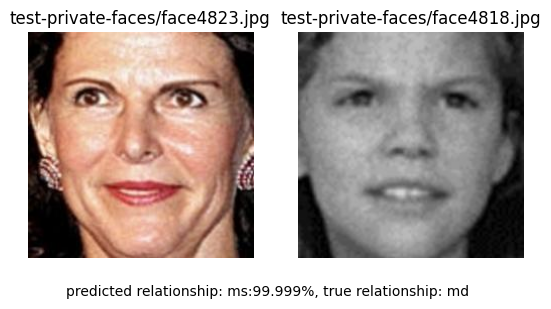

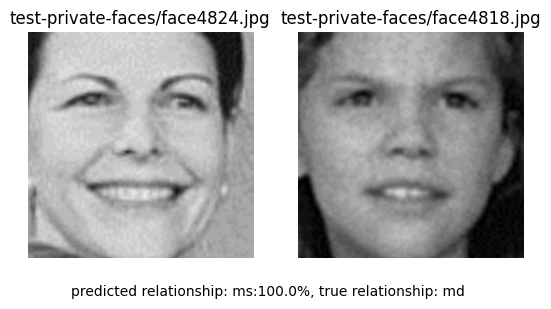

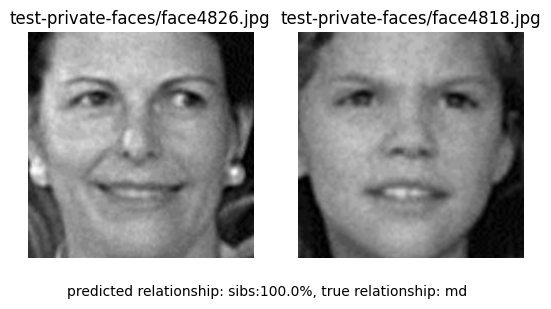

In [124]:
show_tops(test_multiclass_predictions, errors.numpy(), test_multiclass_dataframe, give_best=False, is_binary=False, top_n=20, classes=classes)

## Test su immagini dei "Soliti Ignoti"

Per testare i migliori modelli addestrati in precedenza, sia tra quelli tradizionali che tra le reti neurali, vengono quindi caricate le immagini di cinque puntate del programma televisivo dei "Soliti Ignoti". Le puntate sono tra le ultime trasmesse, ovvero quelle del 9, 11, 13, 14 e 15 aprile 2023. Per ogni puntata sono disponibili i volti degli 8 ignoti e del "parente misterioso".

In [125]:
episodes = [[], [], [], [], []]
for i, day in enumerate(["09", "11", "13", "14", "15"]):
  for index in list(range(1, 9)) + ["parente"]:
    episodes[i].append(cv.resize(load_image(f"soliti_ignoti/puntata_{day}_04_23_{str(index)}.png"), (224, 224)))

Vengono anche estratte le etichette delle classi in ordine, in modo tale da poter confrontare i risultati del sistema con le soluzioni effettive. Il sistema infatti restiuisce degli indici da utilizzare in questa lista, mentre le soluzioni possiedono le etichette delle classi utilizzate nei *dataset* originali.

In [126]:
classes_items = list(classes.items())
classes_items.sort(key=lambda x: x[1])
classes_key = [key for key, _ in classes_items]
classes_key

['bb', 'fd', 'fs', 'gmgs', 'gmgd', 'gfgs', 'gfgd', 'md', 'ms', 'sibs', 'ss']

Sono state caricate anche le soluzioni in un apposito `DataFrame`. Così, per ogni episodio, corrispondente ad una specifica data, è noto quale tra gli "ignoti" era parente del "parente misterioso" e che tipo di relazione avevano i due. L'indice dell'ignoto varia tra 1 e 8, come nella trasmissione, e non tra 0 e 7, come restituisce il sistema di classificazione.

In [127]:
solutions = pd.read_csv("soliti_ignoti/soluzioni.csv", header=None, names=["date", "relative_index", "relation"])
solutions

,date,relative_index,relation
0,15_04_23,8,sibs
1,14_04_23,7,sibs
2,13_04_23,3,ss
3,11_04_23,3,ms
4,09_04_23,7,sibs






Viene definita per il classificatore ottenuto tramite Machine Learning tradizionale una funzione di estrazione delle *feature* che, data un'immagine, effettua una correzione di gamma, le estrae e infine le scala.

In [128]:
def feature_extractor(image):
  def extract_or_zero(image, extr_fn, zero_size):
    val = extr_fn(image)
    return val if val is not None else np.zeros(zero_size)

  hsv_image = cv.cvtColor(image, cv.COLOR_BGR2HSV)
  h, s, v = cv.split(hsv_image)
  gamma = np.log(v.mean()) / np.log(128)
  corrected_v = (255 * ((v / 255) ** gamma)).astype(np.uint8)
  corrected = cv.cvtColor(np.dstack([h, s, corrected_v]), cv.COLOR_HSV2BGR)

  features = [
    extract_or_zero(corrected, extract_skin_tone, 10),
    extract_or_zero(corrected, extract_eyes_hue, 180),
    extract_or_zero(corrected, extract_nose_shape, 65),
    extract_or_zero(corrected, extract_mouth_shape, 65),
    extract_or_zero(corrected, extract_eye_eyebrow_shape, 260),
    extract_or_zero(corrected, extract_face_texture, 448),
  ]

  features = np.expand_dims(np.concatenate(features), axis=0)
  features[:, scaler_indexes] = scaler.transform(features[:, scaler_indexes])
  return features

Dopodiché, vengono definite due funzioni, `create_solution_classic` e `create_soultion_dl`. La prima prende in ingresso i modelli addestrati tramite tecniche di Machine Learning tradizionale sia per il primo che per il secondo problema. La seconda prende in ingresso invece quelli addestrati mediante tecniche di Representation Learning. Entrambe prendono inoltre in ingresso i concorrenti e il "parente misterioso" per effettuare un tentativo nell'individuare il concorrente corretto.

In [129]:
def create_solution_dl(relatives_classifier, relation_classifier, strangers, relative):
  processed_relative = preprocess_input(relative.astype(np.float32), version=2)
  preprocessed_strangers = np.array([preprocess_input(img.astype(np.float32), version=2) for img in strangers])
  preprocessed_relatives =  np.array([processed_relative for _ in range(len(preprocessed_strangers)) ])
  predictions = relatives_classifier.predict([preprocessed_strangers, preprocessed_relatives], verbose=False)
  relative_index = np.argmax(predictions)
  selected_stranger = np.expand_dims(preprocessed_strangers[relative_index], axis=0)
  relative = np.expand_dims(processed_relative, axis=0)
  relation_index = np.argmax(relation_classifier.predict([selected_stranger, relative], verbose=False))
  return relative_index, relation_index

def create_solution_classic(best_binary_models, best_multiclass_models):
  def create_solution(relatives_classifier, relation_classifier, strangers, relative):
    relative_features = feature_extractor(relative)
    relative_pro_predictions = []
    classes_predictions = []
    for stranger in strangers:
      stranger_features = feature_extractor(stranger)
      concat_features = np.hstack([stranger_features, relative_features])
      meta_features_binary = np.array([best_binary_model.predict(concat_features) for best_binary_model in best_binary_models])
      meta_features_multiclass = np.array([best_multiclass_model.predict(concat_features) for best_multiclass_model in best_multiclass_models])
      relative_prediction = relatives_classifier.predict_proba(meta_features_binary.T)[:, 1][0]
      relation_prediction = relation_classifier.predict(meta_features_binary.T)[0]
      relative_pro_predictions.append(relative_prediction)
      classes_predictions.append(relation_prediction)

    relative_index = np.argmax(relative_pro_predictions)
    relation_index = classes_predictions[relative_index]
    return relative_index, relation_index

  return create_solution

Viene chiama la funzione `aggregate_solutions` che utilizza le funzioni definite sopra per giocare tutti gli episodi. Vengono mostrati il "parente misterioso", gli 8 concorrenti e infine la soluzione proposta dalla rete e quella reale. Sotto le immagini viene riportata una frase che cambia in base ai risultati ottenuti dai modelli: il modello può non avere indovintato né il parente né la parentela, solamente il parente oppure il parente e la parentela.

Vengono usati i modelli addestrati tramite tecniche di Machine Learning tradizionale per tentare di vincere il gioco. Sfortunatamente non riescono a vincere nessuna partita.

Episode: 15_04_23


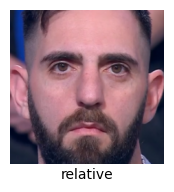

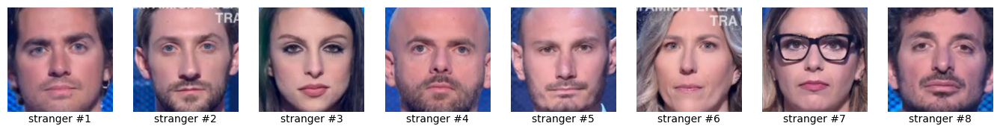

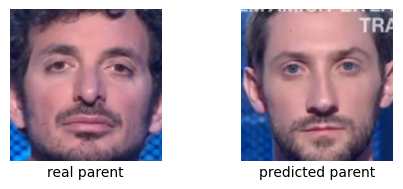

The classifier chose stranger #2 which was in relation "fd"
The classifier did not find the correct relative #8 in relation sibs

Episode: 14_04_23


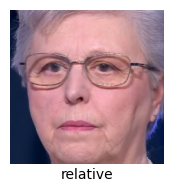

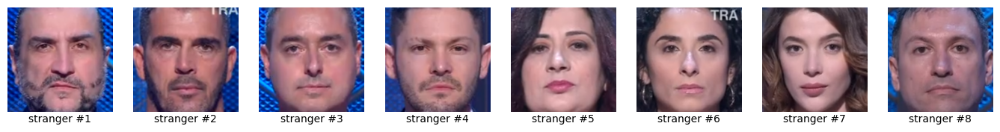

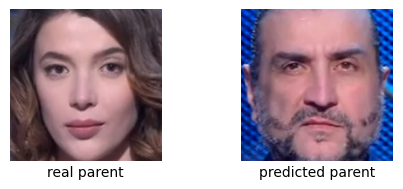

The classifier chose stranger #1 which was in relation "fd"
The classifier did not find the correct relative #7 in relation sibs

Episode: 13_04_23


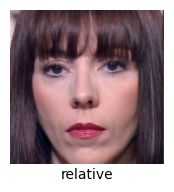

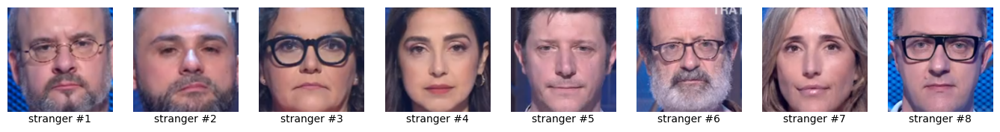

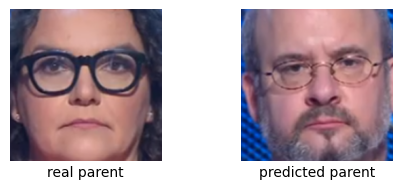

The classifier chose stranger #1 which was in relation "bb"
The classifier did not find the correct relative #3 in relation ss

Episode: 11_04_23


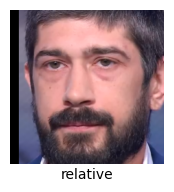

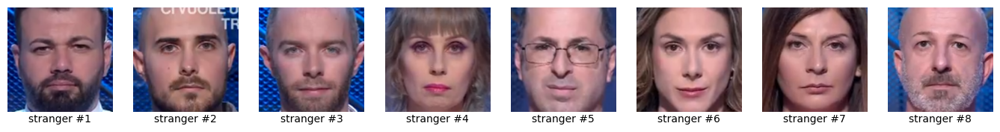

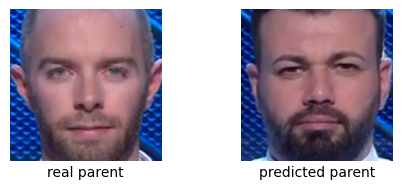

The classifier chose stranger #1 which was in relation "bb"
The classifier did not find the correct relative #3 in relation ms

Episode: 09_04_23


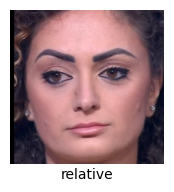

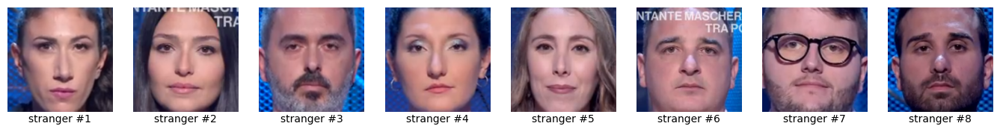

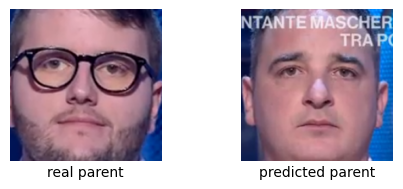

The classifier chose stranger #6 which was in relation "bb"
The classifier did not find the correct relative #7 in relation sibs



In [130]:
aggregate_solutions(best_final_model_binary,
                    best_final_model_multiclass,
                    create_solution_classic(best_models_binary, best_models_multiclass),
                    episodes,
                    solutions,
                    classes_key)

Vengono usati i modelli addestrati tramite tecniche di Representation Learning per tentare di vincere il gioco. Anche in questo caso i modelli non sono riusciti a trovare il conconcorrente in nessuna partita.

Episode: 15_04_23


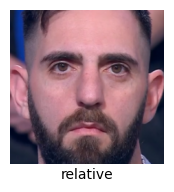

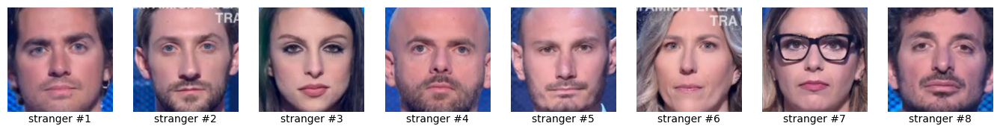

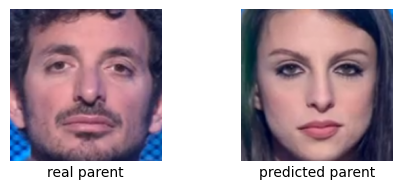

The classifier chose stranger #3 which was in relation "sibs"
The classifier did not find the correct relative #8 in relation sibs

Episode: 14_04_23


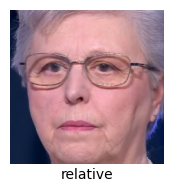

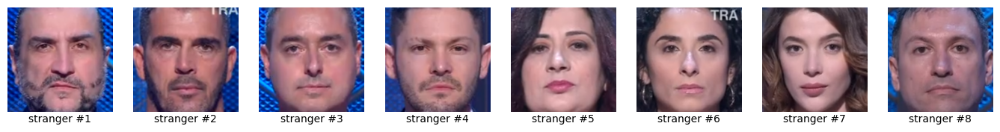

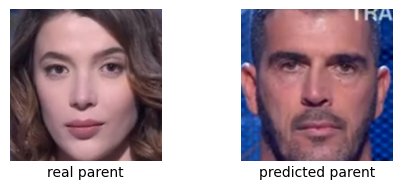

The classifier chose stranger #2 which was in relation "bb"
The classifier did not find the correct relative #7 in relation sibs

Episode: 13_04_23


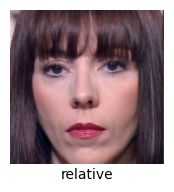

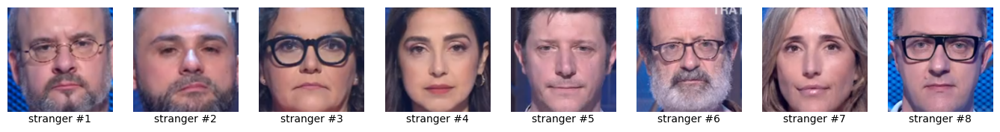

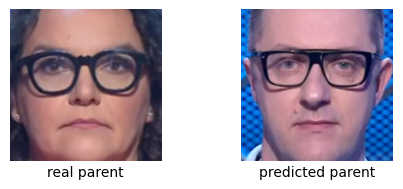

The classifier chose stranger #8 which was in relation "fd"
The classifier did not find the correct relative #3 in relation ss

Episode: 11_04_23


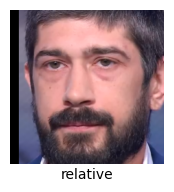

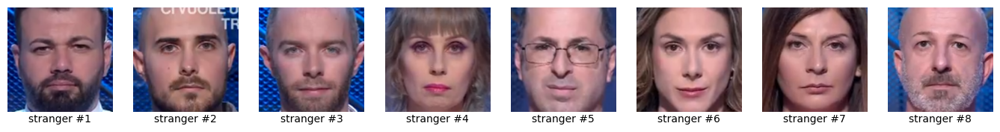

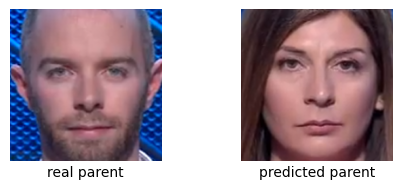

The classifier chose stranger #7 which was in relation "ms"
The classifier did not find the correct relative #3 in relation ms

Episode: 09_04_23


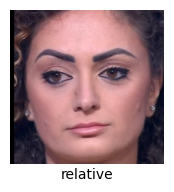

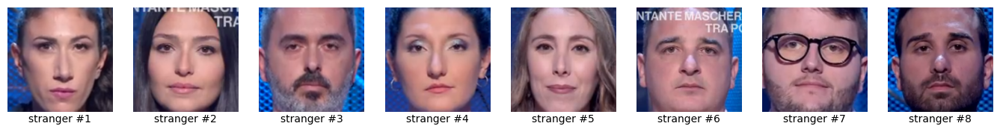

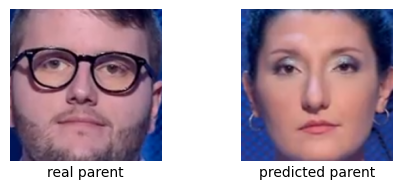

The classifier chose stranger #4 which was in relation "md"
The classifier did not find the correct relative #7 in relation sibs



In [131]:
aggregate_solutions(keras_binary,
                    keras_multiclass,
                    create_solution_dl,
                    episodes,
                    solutions,
                    classes_key)

## Conclusioni e sviluppi futuri

Le tecniche di *representation learning* hanno dimostrato ancora una volta la loro superiorità nel campo del *pattern recognition* rispetto a quelle di estrazione di *feature handcrafted*. I nostri risultati sono corroborati da quelli della *challenge*, dove il primo classificato ha ottenuto un'accuratezza superiore al 90%, utilizzando tecniche più approfondite non pubblicamente disponibili. Il problema, comunque, è tutt'altro che irrisolvibile. I nostri risultati dimostrano ancora una volta che anche modelli il cui addestramento è accessibile a chiunque permettono di ottenere ottimi risultati, ascrivendo questo all'insieme dei problemi che è possibile risolvere mediante tecniche di addestramento automatico.

Per quanto riguarda l'estrazione di *feature handcrafted*, sicuramente successivi tentativi possono focalizzarsi sull'estrazione di migliori e più accurate *feature*. La possibilità di utilizzare modelli per le caratteristiche del volto più precisi, come ad esempio "l'[occhio di Yuille](https://doi.org/10.1007/BF00127169)", permetterebbe di catturare meno pixel che non riguardano il punto saliente di riferimento e perciò di estrarre delle *feature* più precise. Inoltre, si potrebbero sostituire le tecniche utilizzate, come ad esempio il "Canny edge detector" o le operazioni morfologiche di apertura e chiusura, con alcune più nuove, più precise o più robuste al rumore. Si potrebbe anche cercare di sostituire le *feature* estratte con altre simili, ad esempio usando le "shape matrix", i "color moments" o i filtri di Gabor, tenendo conto però delle criticità già evidenziate in precedenza. Si può pensare di effettuare maggior *preprocessing* delle immagini, per uniformarle maggiormente e trattenere quelle che davvero rispettano un determinato standard di qualità. Infine, è possibile utilizzare famiglie di classificatori differenti, approcci alla classificazione differenti o addirittura fornire più risorse di calcolo, così da poter rendere modelli ora inaccessibili a portata di mano.

Per il *representation learning*, invece, lo sforzo può essere fatto in direzione di utilizzare sempre la struttura generica delle "reti siamesi", ma usando come *backbone* degli estrattori di *feature* più precisi e più potenti. Oppure, si può pensare di creare una nuova architettura da zero, sia per quanto riguarda la parte di estrazione, costruibile mediante l'uso di reti "encoder-decoder", sia per quanto riguarda la parte di combinazione di *feature* di diversi estrattori, usando tecniche più recenti come il "global average pooling". Si può tentare di utilizzare l'architettura da noi proposta e modificare l'algoritmo di addestramento, le funzioni di attivazione nei livelli intermedi, il numero di neuroni in quelli "*fully-connected*". Infine, si potrebbe usare l'architettura proposta nel paper "[Deep Fusion Siamese Network for Automatic Kinship Verification](https://doi.org/10.1109/FG47880.2020.00127)" chiamata "Deep Triplet Network" in cui, per individuare le relazioni di parentela, vengono utilizzati due parenti alla volta.

## Bibliografia

1. Northeastern SMILE Lab, *Recognizing Faces in the Wild*, 2019. URL: [https://www.kaggle.com/competitions/recognizing-faces-in-the-wild/overview](https://www.kaggle.com/competitions/recognizing-faces-in-the-wild/overview)
2. J. P. Robinson, M. Shao e Y. Fu, *Families in the wild dataset*, 2016. URL: [https://web.northeastern.edu/smilelab/fiw/](https://web.northeastern.edu/smilelab/fiw/)
3. M. Castellucci e L. Gardini, *Identity - Computer Vision course project repository*. URL: [https://github.com/Lorenzo-Gardini/Computer-vision](https://github.com/Lorenzo-Gardini/Computer-vision)
4. F. P. Kuhl e C. R. Giardina, *Elliptic Fourier features of a closed contour*, Computer Graphics and Image Processing, vol. 18, n. 3, pp. 236-258, 1982. DOI: [https://doi.org/10.1016/0146-664X(82)90034-X](https://doi.org/10.1016/0146-664X(82)90034-X)
5. D. Dahmani, M. Cheref, S. Larabi, *Zero-sum game theory model for segmenting skin regions*, Image and Vision Computing, vol. 99, 2020. DOI: [https://doi.org/10.1016/j.imavis.2020.103925](https://doi.org/10.1016/j.imavis.2020.103925)
6. T. Doshi, *Improving skin tone representation across Google*, 2022. URL: [https://blog.google/products/search/monk-skin-tone-scale/](https://blog.google/products/search/monk-skin-tone-scale/)
7. T. Ojala, M. Pietikainen and T. Maenpaa, *Multiresolution gray-scale and rotation invariant texture classification with local binary patterns*, IEEE Transactions on Pattern Analysis and Machine Intelligence, vol. 24, n. 7, pp. 971-987, 2002. DOI: [https://doi.org/10.1109/TPAMI.2002.1017623](https://doi.org/10.1109/TPAMI.2002.1017623)
8. A. L. Yuille, P. W. Hallinan e D. S. Cohen, *Feature extraction from faces using deformable templates*, International Journal of Computer Vision, vol. 8, pp. 99-111, 1992. DOI: [https://doi.org/10.1007/BF00127169](https://doi.org/10.1007/BF00127169)
9. J. Yu, M. Li, X. Hao e G. Xie, *Deep Fusion Siamese Network for Automatic Kinship Verification*, in 15ma Conferenza Internazionale IEEE su "Automatic Face and Gesture Recognition", IEEE Press, pp. 892-899, 2020. DOI: [https://doi.org/10.1109/FG47880.2020.00127](https://doi.org/10.1109/FG47880.2020.00127)
10. Q. Cao, L. Shen, W. Xie, O. M. Parkhi e A. Zisserman, *VGGFace2: A Dataset for Recognising Faces across Pose and Age*, in 13ma Conferenza Internazionale IEEE su "Automatic Face and Gesture Recognition", pp. 67-74, 2018. DOI: [https://ieeexplore.ieee.org/document/8373813](https://ieeexplore.ieee.org/document/8373813).